# Fault Detection & Diagnosis Pipeline Woodland Way
### _FYP: Continuous Condition Assessment of Automatic Control Valves_
#### _Imperial College London_
#### _Department of Civil & Environmental Engineering_
#### _Megat Riza Makhzan_

This notebook contains the fault detection and diagnosis pipeline for Woodland Way. The notebook compliments the main thesis and provides context on the implementation of the pipeline.

In [1]:
import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objs as go
from plotly.subplots import make_subplots
from datetime import datetime, timedelta
import time
import glob
import os
import csv 
from numpy import cumsum
import matplotlib.dates as mdates
from collections import Counter
from matplotlib.patches import Patch
from scipy.interpolate import interp1d
from dtaidistance import dtw
from scipy.signal import find_peaks
from matplotlib.lines import Line2D
from scipy import stats
from joblib import Parallel, delayed
from sklearn.metrics import ( mean_squared_error, mean_absolute_error, classification_report, confusion_matrix, average_precision_score)
import matplotlib.dates as mdates
from sklearn.model_selection import train_test_split
from scipy.stats import t as student_t
from sklearn.pipeline         import Pipeline
from sklearn.preprocessing    import StandardScaler, PolynomialFeatures
from sklearn.linear_model     import LinearRegression
from dtaidistance import dtw
from scipy.signal import find_peaks
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import ( precision_score, recall_score,f1_score, accuracy_score,balanced_accuracy_score)

# suppress unnecessary warnings
def warn(*args, **kwargs):
    pass
import warnings
warnings.warn = warn

C:\Users\megat\anaconda3\lib\site-packages\numpy\_distributor_init.py:30: UserWarning: loaded more than 1 DLL from .libs:
C:\Users\megat\anaconda3\lib\site-packages\numpy\.libs\libopenblas.4SP5SUA7CBGXUEOC35YP2ASOICYYEQZZ.gfortran-win_amd64.dll
C:\Users\megat\anaconda3\lib\site-packages\numpy\.libs\libopenblas.EL2C6PLE4ZYW3ECEVIV3OXXGRN2NRFM2.gfortran-win_amd64.dll
C:\Users\megat\anaconda3\lib\site-packages\numpy\.libs\libopenblas.XWYDX2IKJW2NMTWSFYNGFUWKQU3LYTCZ.gfortran-win_amd64.dll
  warnings.warn("loaded more than 1 DLL from .libs:"


In [2]:
print(pd. __version__)           # 1.4.0
print(matplotlib. __version__)   # 3.5.0
print(np. __version__)           # 1.22.4
print(sns. __version__)          # 0.11.2

1.4.0
3.5.0
1.22.4
0.11.2


In [3]:
%matplotlib inline

# plt settings
plot_size   = 30
plot_width  = 60
plot_height = 30

params = {'legend.fontsize': plot_width,
          'figure.figsize': (plot_width,plot_height),
          'axes.labelsize': plot_width,
          'axes.titlesize': plot_width*1.5,
          'xtick.labelsize': plot_width,
          'ytick.labelsize': plot_width,
          'axes.titlepad': plot_width,
          'font.size': plot_width,
          'font.family': 'sans-serif',  
          'font.sans-serif': 'Arial',
          'axes.linewidth':    2,
          'grid.linewidth': 2}
plt.rcParams.update(params)

## Load data

1. Initialise strings 
2. Load data (uncomment as required)
    - Native 1 minute / sample
    - Fixed 5-min windows
    - 10-minute windows with 50% overlap
3. Compute rate of change
4. Compute coefficient of variation (CV)
5. Define periods of fixed outlet pressure
6. Define control profiles


In [4]:
Pout_str = 'pressure_out'
Pin_str = 'pressure_in'
Pres_str = 'residual_pressure'
Flow_str = 'flow'
Pc_str = 'pressure_chamber'
Stem_str = 'valve_position'
Normalised_str = 'normalised_residual_pressure'
Ptarget_str = 'pressure_target'
Flow_roc_str = 'Flow_rate_of_change'
Pout_roc_str = 'Pout_rate_of_change'
Pin_roc_str = 'Pin_rate_of_change'
Flow_cv_str = 'Flow_cv'
Pout_cv_str = 'Pout_cv'
Pin_cv_str = 'Pin_cv'

In [5]:
Window = 1
Step = 1
T1_str = '1-min'

Pres_1T = pd.read_csv("../../Data/WoodlandWay/ProcessedData/Pres_Final.csv", parse_dates=[0], index_col=0)
Flow_1T = pd.read_csv("../../Data/WoodlandWay/ProcessedData/Flow_Final.csv", parse_dates=[0], index_col=0)
Pin_1T = pd.read_csv("../../Data/WoodlandWay/ProcessedData/Pin_Final.csv", parse_dates=[0], index_col=0)
Pout_1T = pd.read_csv("../../Data/WoodlandWay/ProcessedData/Pout_Final.csv", parse_dates=[0], index_col=0)
Ptarget_1T = pd.read_csv("../../Data/WoodlandWay/ProcessedData/Ptarget_final.csv", parse_dates=[0], index_col=0)
Normalised_1T = pd.read_csv("../../Data/WoodlandWay/ProcessedData/Normalised_Final.csv", parse_dates=[0], index_col=0)
Stem_1T = pd.read_csv("../../Data/WoodlandWay/ProcessedData/Stem_final.csv", parse_dates=[0], index_col=0)

In [6]:
Window = 5
Step = 5
T_str = '5-min Windowed'

Flow = pd.read_csv("../../Data/WoodlandWay/ProcessedData/Flow5T_Final.csv", parse_dates=[0], index_col=0)
Pin = pd.read_csv("../../Data/WoodlandWay/ProcessedData/Pin5T_Final.csv", parse_dates=[0], index_col=0)
Pout = pd.read_csv("../../Data/WoodlandWay/ProcessedData/Pout5T_Final.csv", parse_dates=[0], index_col=0)
Ptarget = pd.read_csv("../../Data/WoodlandWay/ProcessedData/Ptarget5T_Final.csv", parse_dates=[0], index_col=0)
Pres = pd.read_csv("../../Data/WoodlandWay/ProcessedData/Pres5T_Final.csv", parse_dates=[0], index_col=0)
Normalised = pd.read_csv("../../Data/WoodlandWay/ProcessedData/Normalised5T_Final.csv", parse_dates=[0], index_col=0)

In [7]:
Window10 = 10
Step10 = 5
T10_str = '10-min Windowed w/ 50% Overlap'

Flow10 = pd.read_csv("../../Data/WoodlandWay/ProcessedData/Flow10ov_Final.csv", parse_dates=[0], index_col=0)
Pin10 = pd.read_csv("../../Data/WoodlandWay/ProcessedData/Pin10ov_Final.csv", parse_dates=[0], index_col=0)
Pout10 = pd.read_csv("../../Data/WoodlandWay/ProcessedData/Pout10ov_Final.csv", parse_dates=[0], index_col=0)
Ptarget10 = pd.read_csv("../../Data/WoodlandWay/ProcessedData/Ptarget10ov_Final.csv", parse_dates=[0], index_col=0)
Pres10 = pd.read_csv("../../Data/WoodlandWay/ProcessedData/Pres10ov_Final.csv", parse_dates=[0], index_col=0)
Normalised10 = pd.read_csv("../../Data/WoodlandWay/ProcessedData/Normalised10ov_Final.csv", parse_dates=[0], index_col=0)

In [8]:
Flow_roc = pd.DataFrame(Flow.diff().dropna().values / Step, index=Flow.diff().dropna().index, columns=['Flow_rate_of_change'])
Pout_roc = pd.DataFrame(Pout.diff().dropna().values / Step, index=Pout.diff().dropna().index, columns=['Pout_rate_of_change'])
Pin_roc = pd.DataFrame(Pin.diff().dropna().values / Step, index=Pin.diff().dropna().index, columns=['Pin_rate_of_change'])

The code block below calculates CV values based on a 10-minute window and 50% overlap for this PRV.

In [9]:
window = "10T"
step   = "5T"

pin_mean1 = Pin_1T.resample(window).mean()
pin_mean2 = Pin_1T.resample(window, offset=step).mean()
Pin_win10_mean = pd.concat([pin_mean1, pin_mean2]).sort_index()
pin_std1 = Pin_1T.resample(window).std()
pin_std2 = Pin_1T.resample(window, offset=step).std()
Pin_win10_std = pd.concat([pin_std1, pin_std2]).sort_index()
Pin_cv_rolling = (Pin_win10_std / Pin_win10_mean) * 100
Pin_cv_rolling = Pin_cv_rolling.rename(columns={Pin_str: "Pin_cv"})

pout_mean1 = Pout_1T.resample(window).mean()
pout_mean2 = Pout_1T.resample(window, offset=step).mean()
Pout_win10_mean = pd.concat([pout_mean1, pout_mean2]).sort_index()
pout_std1 = Pout_1T.resample(window).std()
pout_std2 = Pout_1T.resample(window, offset=step).std()
Pout_win10_std = pd.concat([pout_std1, pout_std2]).sort_index()
Pout_cv_rolling = (Pout_win10_std / Pout_win10_mean) * 100
Pout_cv_rolling = Pout_cv_rolling.rename(columns={Pout_str: "Pout_cv"})

flow_mean1 = Flow_1T.resample(window).mean()
flow_mean2 = Flow_1T.resample(window, offset=step).mean()
Flow_win10_mean = pd.concat([flow_mean1, flow_mean2]).sort_index()
flow_std1 = Flow_1T.resample(window).std()
flow_std2 = Flow_1T.resample(window, offset=step).std()
Flow_win10_std = pd.concat([flow_std1, flow_std2]).sort_index()
Flow_cv_rolling = (Flow_win10_std / Flow_win10_mean) * 100
Flow_cv_rolling = Flow_cv_rolling.rename(columns={Flow_str: "Flow_cv"})

In [10]:
Fixed_outlet_pressure = pd.DataFrame(index=Pout.index)
Fixed_outlet_pressure['fixed_outlet_pressure'] = 0
start = pd.Timestamp('2025-03-31 12:02:00')
end   = pd.Timestamp('2025-04-07 12:05:00')
mask  = (Fixed_outlet_pressure.index >= start) & (Fixed_outlet_pressure.index <= end)
Fixed_outlet_pressure.loc[mask, 'fixed_outlet_pressure'] = 1

The code block below establishes the control profiles for the entire dataset.

In [11]:
start = '2024-01'
end   = '2025-02'


df = pd.DataFrame({
    'Flow':     Flow_1T[Flow_str].loc[start:end],
    'P_target': Ptarget_1T[Ptarget_str].loc[start:end]
}).dropna()

group_field = 'Flow'
curve = (
    df.groupby(group_field, as_index=False)['P_target']
      .mean()
      .sort_values(group_field)
      .rename(columns={group_field: 'Flow'})
)
f_control = interp1d(
    curve['Flow'], curve['P_target'],
    kind='linear', fill_value='extrapolate'
)

CP4 = pd.DataFrame({
    'abb': [0,0.3,7,20,26,30,34,38,42,45,48,51,54,57,59,62,100],
    'P_target': [32,15.2,15.2,17,18.1,19,20,21.1,22.4,23.4,24.3,25.4,26.6,28,29,32,32]
})
flat_start = pd.to_datetime('2025-03-31 12:02:00')
flat_end   = pd.to_datetime('2025-04-07 12:05:00')
mean_outlet = Pout['pressure_out'].loc[flat_start:flat_end].mean()
CP2 = pd.DataFrame({
    'abb': CP4['abb'].values,
    'P_target': mean_outlet
})
CP5 = pd.DataFrame({
    'abb': [0,1,5,10,15,20,25,30,35,40,45,50,55,60,62,100],
    'P_target': [32,14,14.5,15,15.8,16.5,17.5,18.5,19.5,21,22.5,24,26,29,32,32]
})
CP6 = pd.DataFrame({
    'abb': [0,1,5,10,15,20,25,30,35,40,45,50,55,100],
    'P_target': [32,13,13,14,15,16,17,18,19,20.5,22,24,32,32]
})

cp_periods = [
    (pd.to_datetime('2024-01-01 00:00:00'), pd.to_datetime('2025-03-31 12:01:00'), f_control),
    (pd.to_datetime('2025-03-31 12:02:00'), pd.to_datetime('2025-04-07 12:05:00'), CP2),
    (pd.to_datetime('2025-04-07 12:06:00'), pd.to_datetime('2025-04-15 00:08:00'), f_control),
    (pd.to_datetime('2025-04-15 00:09:00'), pd.to_datetime('2025-04-15 11:50:00'), CP4),
    (pd.to_datetime('2025-04-15 11:51:00'), pd.to_datetime('2025-04-16 12:59:00'), CP5),
    (pd.to_datetime('2025-04-16 13:00:00'), pd.to_datetime('2025-04-30 23:59:00'), CP6),
]

def get_control_curve(ts):
    ts = pd.Timestamp(ts)
    for start_dt, end_dt, CPdf in cp_periods:
        if start_dt <= ts <= end_dt:
            if callable(CPdf):
                # generate dynamic curve
                abb = curve['Flow'].values
                P = CPdf(abb)
                return pd.DataFrame({'abb': abb, 'P_target': P})
            return CPdf
    raise ValueError(f"No control curve defined for {ts.date()}")


## 2. Simulation of raw residuals w/ skewed normal thresholds

This section contains the fault detection analysis with residual pressures. The analysis is carried out using 5-minute residuals and 10-minute resiudals with a 50% overlap.

### 2.1. Fault detection w/ 5 minute residuals

[1/7] Configuration loaded.
[2/7] Regime assignment ready.
[3/7] Static thresholds computed.
[4/7] Threshold fitter ready.
    • Fitted 576 regimes at 2024-01-31
[5/7] Initial adaptive thresholds set.
[6/7] Simulation DataFrame ready.
    • Fitted 576 regimes at 2024-02-01
    • Fitted 576 regimes at 2024-03-01
    • Fitted 576 regimes at 2024-04-01
    • Fitted 576 regimes at 2024-04-28
    • Fitted 576 regimes at 2024-06-01
    • Fitted 576 regimes at 2024-07-01
    • Fitted 576 regimes at 2024-08-01
    • Fitted 576 regimes at 2024-09-01
    • Fitted 576 regimes at 2024-09-29
    • Fitted 576 regimes at 2024-11-01
    • Fitted 576 regimes at 2024-12-01
    • Fitted 576 regimes at 2025-01-01
    • Fitted 576 regimes at 2025-02-01
    • Fitted 576 regimes at 2025-03-01
    • Fitted 576 regimes at 2025-03-30
[7/7] Adaptive thresholds updated monthly.
[8/8] Anomaly detection complete.


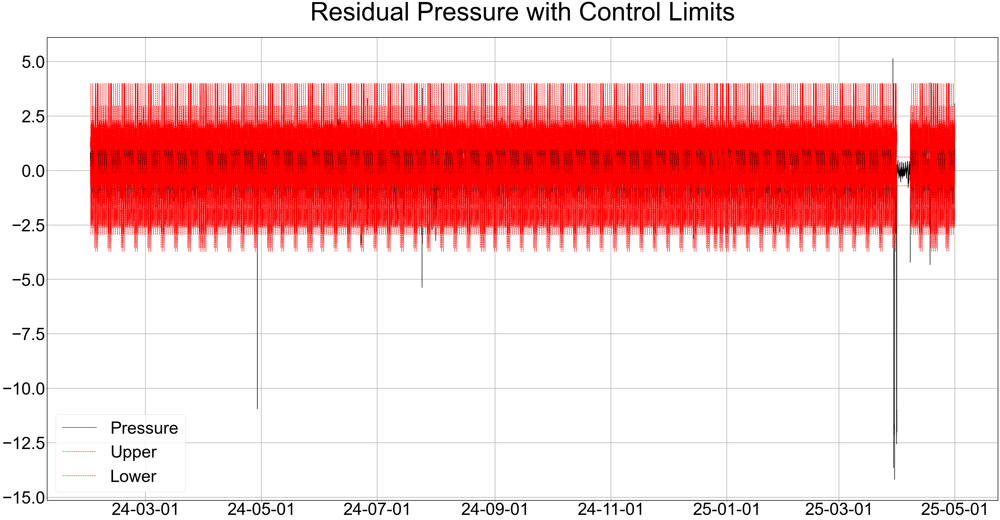

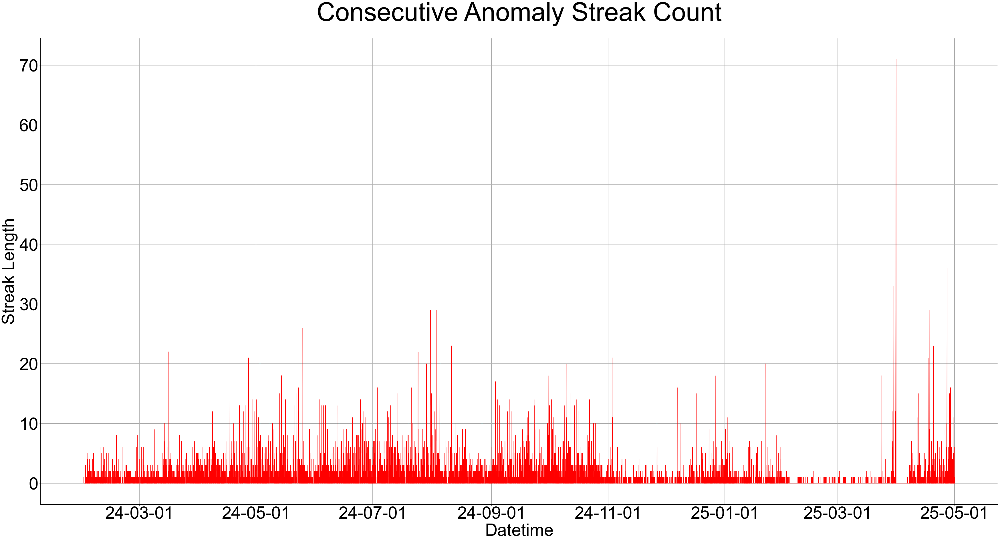

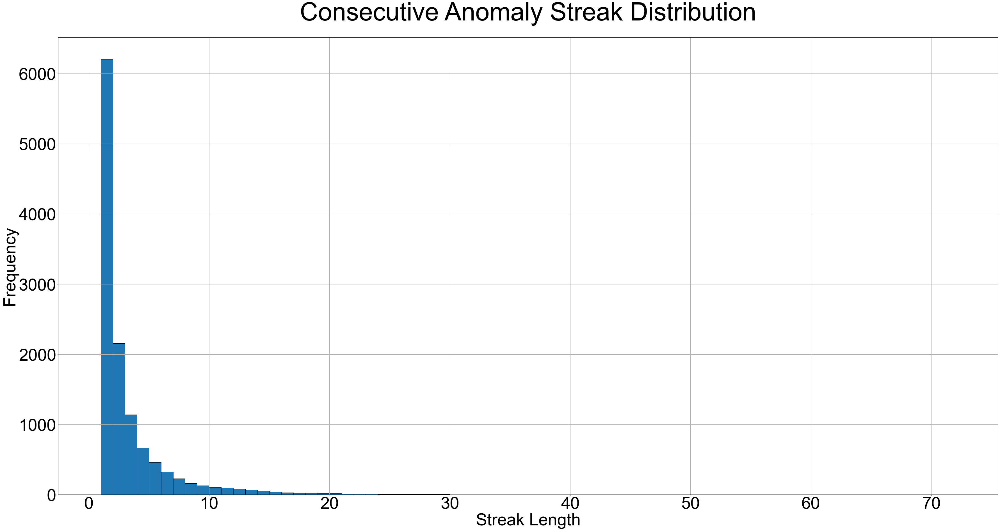

In [12]:
# ----- Parameters & functions -----
value_col = Pres_str 
P_LOW, P_HIGH = 0.0015, 0.9985
WINDOW_DAYS = 60

def aic(ll, k, n):
    return 2*k - 2*ll + 2*k*(k+1)/(n-k-1)

print("[1/7] Configuration loaded.")

# ----- 1) Holidays & regime assignment -----
holiday_dates = {pd.Timestamp(d).date() for d in [
    '2024-01-01','2024-03-29','2024-04-01','2024-05-06',
    '2024-05-27','2024-08-26','2024-12-25','2024-12-26',
    '2024-12-31','2025-01-01','2025-04-18','2025-04-21'
]}
def assign_model(ts):
    return 'weekend' if (ts.weekday() >= 5 or ts.date() in holiday_dates) else 'weekday'

print("[2/7] Regime assignment ready.")

# ----- Fixed outlet percentile thresholds -----
june = Pres.loc['2025-04-01':'2025-04-06', value_col].astype(float)
a_sn, loc_sn, sc_sn = stats.skewnorm.fit(june)
sh, loc_g, sc_g = stats.gamma.fit(june)
n = len(june)
ll_sn = np.sum(stats.skewnorm.logpdf(june, a_sn, loc_sn, sc_sn))
ll_g  = np.sum(stats.gamma.logpdf(june, sh, loc_g, sc_g))
best = 'sn' if aic(ll_sn,3,n) < aic(ll_g,3,n) else 'g'
if best=='sn':
    static_lower = stats.skewnorm.ppf(P_LOW, a_sn, loc_sn, sc_sn)
    static_upper = stats.skewnorm.ppf(P_HIGH, a_sn, loc_sn, sc_sn)
else:
    static_lower = stats.gamma.ppf(P_LOW, sh, loc_g, sc_g)
    static_upper = stats.gamma.ppf(P_HIGH, sh, loc_g, sc_g)
static_lower = max(static_lower, -4)
static_upper = min(static_upper,  4)
print("[3/7] Static thresholds computed.")

# ----- Monthly threshold computation -----
def compute_pct_thresholds(df):
    """
    Fit skewnorm & gamma per (time_5min, model), pick by AIC,
    return DataFrame with ['time_5min','model','lower','upper'].
    """
    groups = df.groupby(['time_5min','model'])[value_col]
    def fit_group(name, x):
        t, m = name
        arr = x.values.astype(float)
        if len(arr) < 5:
            return (t, m, static_lower, static_upper)
        a, l, s = stats.skewnorm.fit(arr)
        sh, lg, sg = stats.gamma.fit(arr)
        ll1 = np.sum(stats.skewnorm.logpdf(arr, a, l, s))
        ll2 = np.sum(stats.gamma.logpdf(arr, sh, lg, sg))
        try:
            a1 = aic(ll1,3,len(arr)); a2 = aic(ll2,3,len(arr))
        except ZeroDivisionError:
            a1, a2 = ll1, ll2
        if a1 < a2:
            lo = stats.skewnorm.ppf(P_LOW, a, l, s)
            hi = stats.skewnorm.ppf(P_HIGH, a, l, s)
        else:
            lo = stats.gamma.ppf(P_LOW, sh, lg, sg)
            hi = stats.gamma.ppf(P_HIGH, sh, lg, sg)
        # enforce hard bounds
        return (t, m, max(lo, -4), min(hi, 4))
    res = Parallel(n_jobs=-1)(delayed(fit_group)(n, g) for n, g in groups)
    df_res = pd.DataFrame(res, columns=['time_5min','model','lower','upper'])
    print(f"    • Fitted {len(df_res)} regimes at {df.index.max().date()}")
    return df_res

print("[4/7] Threshold fitter ready.")

# ----- Initialize window & thresholds -----
window_df = Pres.loc['2024-01'].copy()
window_df['time_5min'] = window_df.index.floor('5T').time
window_df['model'] = window_df.index.map(assign_model)
thresholds_df = compute_pct_thresholds(window_df)
print("[5/7] Initial adaptive thresholds set.")

# ----- Prepare sim_df -----
sim_df = Pres.loc['2024-02':'2025-04'].copy()
sim_df['time_5min'] = sim_df.index.floor('5T').time
sim_df['model'] = sim_df.index.map(assign_model)
sim_df = sim_df.merge(
    Fixed_outlet_pressure.rename({'fixed_outlet_pressure':'fixed_flag'},axis=1),
    left_index=True, right_index=True, how='left'
).fillna({'fixed_flag':0})
print("[6/7] Simulation DataFrame ready.")

# ----- Slide window & monthly refit -----
for day in pd.date_range(sim_df.index.min(), sim_df.index.max(), freq='D'):
    window_df = pd.concat([window_df, sim_df.loc[day.strftime('%Y-%m-%d'), [value_col,'time_5min','model']]])
    window_df = window_df[window_df.index > window_df.index.max() - pd.Timedelta(days=WINDOW_DAYS)]
    if day.is_month_start:
        wf = window_df.reset_index().rename(columns={'index':'timestamp'})
        # drop extreme values
        wf = wf[wf[value_col].abs() <= 4]
        wf = wf.merge(thresholds_df, on=['time_5min','model'], how='left')
        ex = (wf[value_col] > wf['upper']) | (wf[value_col] < wf['lower'])
        grp = (ex != ex.shift()).cumsum()
        wf['count'] = ex.groupby(grp).cumcount().add(1).where(ex, 0)
        wf['date'] = wf['timestamp'].dt.date
        good = wf.groupby('date')['count'].max() < 10
        filt = wf[wf['date'].isin(good[good].index)]
        filt = filt.set_index('timestamp')[[value_col,'time_5min','model']]
        thresholds_df = compute_pct_thresholds(filt)
print("[7/7] Adaptive thresholds updated monthly.")

# ----- Anomaly detection -----
merged = sim_df.join(
    thresholds_df.set_index(['time_5min','model']),
    on=['time_5min','model']
)
merged.loc[merged['fixed_flag'] == 1, ['lower','upper']] = static_lower, static_upper
mask = (merged[value_col] > merged['upper']) | (merged[value_col] < merged['lower'])
grps = (mask != mask.shift()).cumsum()
merged['count'] = mask.groupby(grps).cumcount().add(1).where(mask, 0)
merged['absdiff'] = np.where(
    merged[value_col] > merged['upper'],
    merged[value_col] - merged['upper'],
    np.where(merged[value_col] < merged['lower'], merged['lower'] - merged[value_col], 0)
)
print("[8/8] Anomaly detection complete.")

# ----- Finalize & plot -----
flagged_all = merged.copy()
residual_flagged_all = flagged_all.copy()

# Residual vs. thresholds
fig, ax = plt.subplots()
ax.plot(flagged_all.index, flagged_all[value_col], 'k-', label='Pressure')
ax.plot(flagged_all.index, flagged_all['upper'], 'r--', label='Upper')
ax.plot(flagged_all.index, flagged_all['lower'], 'r--', label='Lower')
ax.set_title('Residual Pressure with Control Limits')
ax.xaxis.set_major_formatter(mdates.DateFormatter('%y-%m-%d'))
ax.legend(); ax.grid(True)
plt.show()

# Anomaly count
fig, ax2 = plt.subplots()
ax2.plot(flagged_all.index, flagged_all['count'], 'r-')
ax2.set_title('Consecutive Anomaly Streak Count')
ax2.set_xlabel('Datetime')
ax2.set_ylabel('Streak Length')
ax2.xaxis.set_major_formatter(mdates.DateFormatter('%y-%m-%d'))
ax2.grid(True)
plt.show()

# Histogram of anomaly lengths
streaks = flagged_all['count'][flagged_all['count'] > 0]
fig, ax3 = plt.subplots()
ax3.hist(streaks, bins=range(1, streaks.max()+2), edgecolor='black')
ax3.set_title('Consecutive Anomaly Streak Distribution')
ax3.set_xlabel('Streak Length')
ax3.set_ylabel('Frequency')
ax3.grid(True)
plt.show()


### 2.2. Flagged Control Plots

The code below illustrates control plots between given timestamps based on the analysis above. The start and end dates can be adjusted to view different dates and times. 

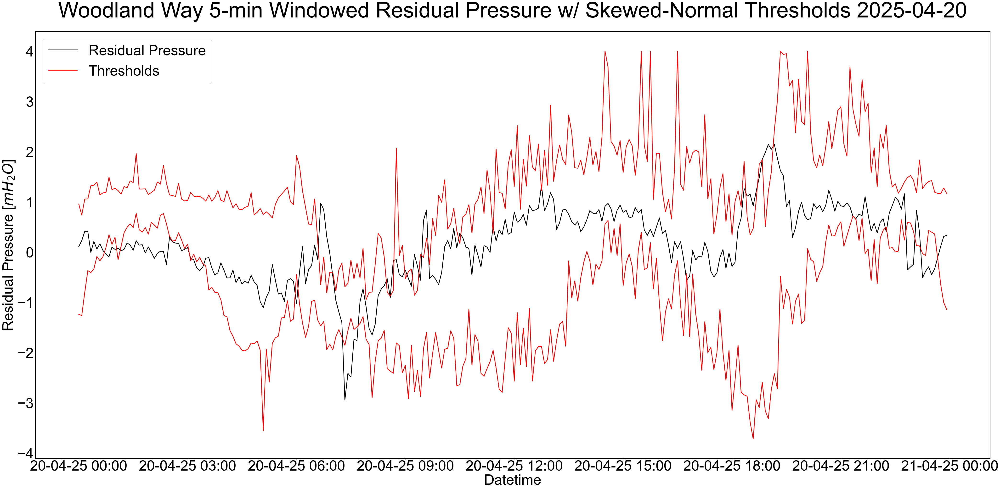

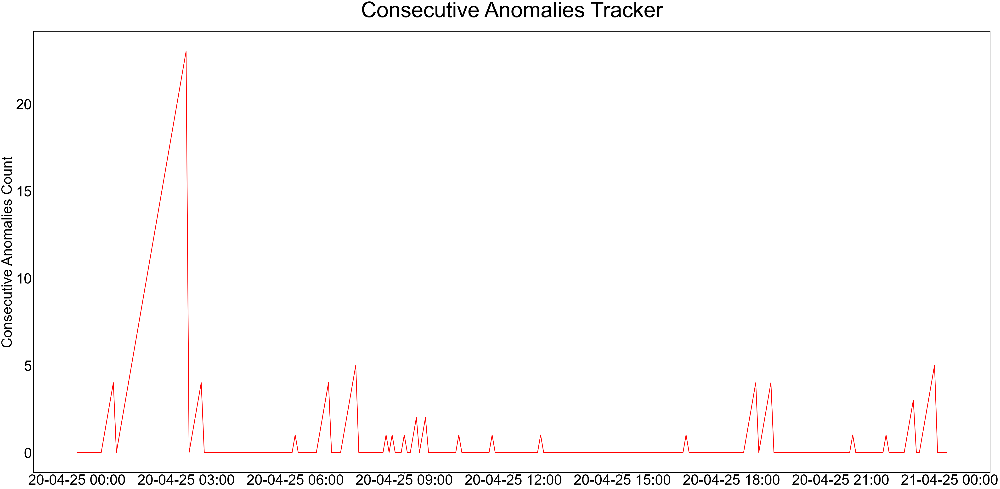

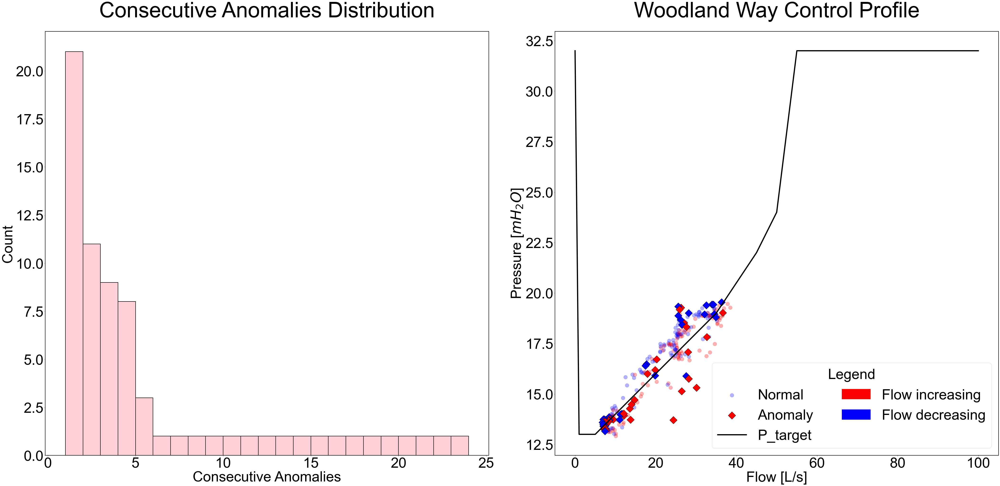

In [13]:
start, end = '2025-04-20','2025-04-20'
value_col = Pres_str
# — Residual Pressure w/ Thresholds —
fig, ax = plt.subplots()
ax.plot(residual_flagged_all.loc[start:end].index,
        residual_flagged_all[value_col].loc[start:end],
        'k-', label='Residual Pressure', linewidth = 3)
ax.plot(residual_flagged_all.loc[start:end].index,
        residual_flagged_all['upper'].loc[start:end],
        'r-', label='Thresholds', linewidth = 3)
ax.plot(residual_flagged_all.loc[start:end].index,
        residual_flagged_all['lower'].loc[start:end],
        'r-', linewidth = 3)
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
#fig.autofmt_xdate(rotation=15)
ax.set_xlabel('Datetime')
ax.set_ylabel(r'Residual Pressure [$mH_2O$]')
ax.set_title(
    f'Woodland Way {T_str} Residual Pressure w/ Skewed-Normal Thresholds {start}'
)
ax.legend()
plt.tight_layout()
plt.show()


# — Consecutive Anomalies Tracker —
fig, ax = plt.subplots()
ax.plot(residual_flagged_all.loc[start:end].index,
        residual_flagged_all['count'].loc[start:end],
        'r-', linewidth = 3)
ax.set_ylabel('Consecutive Anomalies Count')
ax.set_title(f'Consecutive Anomalies Tracker')
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
plt.tight_layout()
plt.show()


# —  Histogram + Cla-Val Scatter w/ Control Curve —
hist3 = residual_flagged_all['count'].loc[start:end]
flow_day = Flow['flow'].loc[start:end]
pout_day = Pout['pressure_out'].loc[start:end]
diff_day = flow_day.diff()
valid   = diff_day.notna()
flow_plot, pout_plot = flow_day[valid], pout_day[valid]
diff_plot = diff_day[valid]
colors    = ['red' if d > 0 else 'blue' for d in diff_plot]
floored        = flow_plot.index.floor('5T')
counts_on_flow = residual_flagged_all['count'].reindex(floored, fill_value=0)
anomaly_mask   = counts_on_flow.values > 0
days_with_anomalies = (
    residual_flagged_all.loc[start:end]
    .query('count > 1')
    .index
    .normalize()
    .unique()
)

fig, (ax_hist, ax_scatter) = plt.subplots(ncols=2)
sns.histplot(
    hist3[hist3 > 0],
    bins=range(1, hist3.max() + 2),
    ax=ax_hist,
    color='pink', linewidth = 2
)
ax_hist.set_title(f'Consecutive Anomalies Distribution')
ax_hist.set_xlabel('Consecutive Anomalies')
ax_hist.set_ylabel('Count')

sc_norm = ax_scatter.scatter(
    flow_plot[~anomaly_mask], pout_plot[~anomaly_mask],
    c=[c for c, m in zip(colors, anomaly_mask) if not m],
    edgecolor=[c for c, m in zip(colors, anomaly_mask) if not m],
    s=250, alpha=0.3, label='Normal'
)
sc_anom = ax_scatter.scatter(
    flow_plot[anomaly_mask], pout_plot[anomaly_mask],
    c=[c for c, m in zip(colors, anomaly_mask) if m],
    marker='D', edgecolor='k', s=500, label='Anomaly'
)

ln_curve = None
for day in days_with_anomalies:
    CPdf = get_control_curve(pd.Timestamp(day))
    ln_curve, = ax_scatter.plot(
        CPdf['abb'], CPdf['P_target'],
        linewidth=5, color='black', label='P_target'
    )

red_patch  = Patch(color='red',  label='Flow increasing')
blue_patch = Patch(color='blue', label='Flow decreasing')
handles = [sc_norm, sc_anom, ln_curve, red_patch, blue_patch]
labels  = ['Normal', 'Anomaly', 'P_target', 'Flow increasing', 'Flow decreasing']
ax_scatter.legend(
    handles=handles,
    labels=labels,
    loc='lower right',
    ncol=2,
    title='Legend'
)

ax_scatter.set(
    title=f"Woodland Way Control Profile",
    xlabel='Flow [L/s]',
    ylabel=r'Pressure [$mH_2O$]'
)

plt.tight_layout()
plt.show()

### 2.3. Feature labelling

The code below collects the key features from the analysis above which will be used for fault diagnosis later on.

In [14]:
mask = flagged_all['count'] >= 1
ts   = flagged_all.index[mask]

flagged_features = pd.DataFrame(index=ts)

flagged_features['Flow']       = Flow         [Flow_str]       .reindex(ts)
flagged_features['Pin']        = Pin          [Pin_str]        .reindex(ts)
flagged_features['Pout']       = Pout         [Pout_str]       .reindex(ts)
flagged_features['Pres']       = Pres         [Pres_str]       .reindex(ts)
flagged_features['normalised'] = Normalised   [Normalised_str] .reindex(ts)

flagged_features['Flow_roc']   = Flow_roc     [Flow_roc_str]   .reindex(ts)
flagged_features['Pin_roc']    = Pin_roc      [Pin_roc_str]    .reindex(ts)
flagged_features['Pout_roc']   = Pout_roc     [Pout_roc_str]   .reindex(ts)

flagged_features['Flow_cv']    = Flow_cv_rolling[Flow_cv_str] .reindex(ts)
flagged_features['Pin_cv']     = Pin_cv_rolling [Pin_cv_str]   .reindex(ts)
flagged_features['Pout_cv']    = Pout_cv_rolling[Pout_cv_str].reindex(ts)

flagged_features['fixed_outlet_pressure']   = Fixed_outlet_pressure['fixed_outlet_pressure'].reindex(ts)
flagged_features['count']   = flagged_all['count'].reindex(ts)
flagged_features['absdiff'] = flagged_all['absdiff'].reindex(ts)

### 2.4 Fault detection model w/ fixed 10 min w/ 50% overlap

[1/7] Configuration loaded.
[2/7] Regime assignment ready.
[3/7] Static thresholds computed.
[4/7] Threshold fitter ready.
    • Fitted 576 regimes at 2024-01-31
[5/7] Initial adaptive thresholds set.
[6/7] Simulation DataFrame ready.
    • Fitted 576 regimes at 2024-02-01
    • Fitted 576 regimes at 2024-03-01
    • Fitted 576 regimes at 2024-04-01
    • Fitted 576 regimes at 2024-04-28
    • Fitted 576 regimes at 2024-06-01
    • Fitted 576 regimes at 2024-07-01
    • Fitted 576 regimes at 2024-08-01
    • Fitted 576 regimes at 2024-08-31
    • Fitted 576 regimes at 2024-09-29
    • Fitted 576 regimes at 2024-11-01
    • Fitted 576 regimes at 2024-12-01
    • Fitted 576 regimes at 2025-01-01
    • Fitted 576 regimes at 2025-02-01
    • Fitted 576 regimes at 2025-02-28
    • Fitted 576 regimes at 2025-03-30
[7/7] Adaptive thresholds updated monthly.
[8/8] Anomaly detection complete.


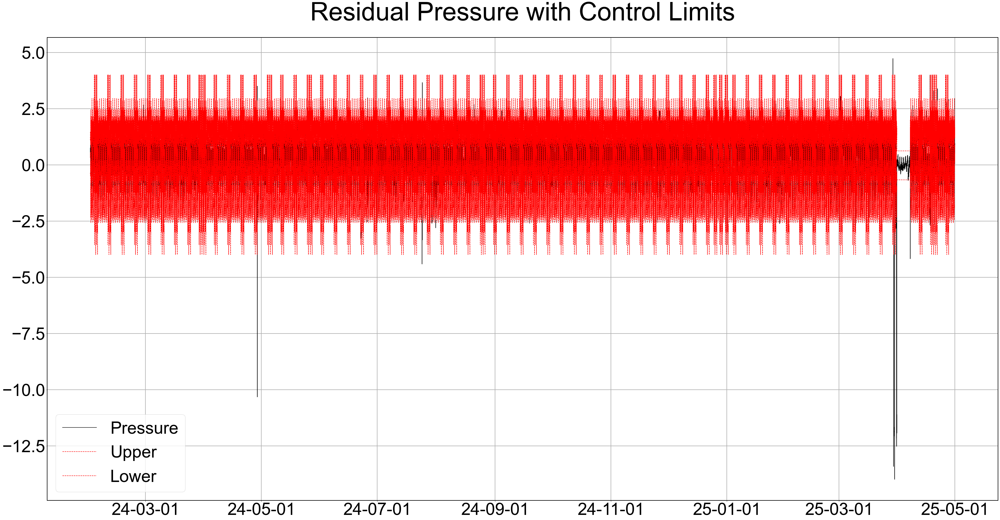

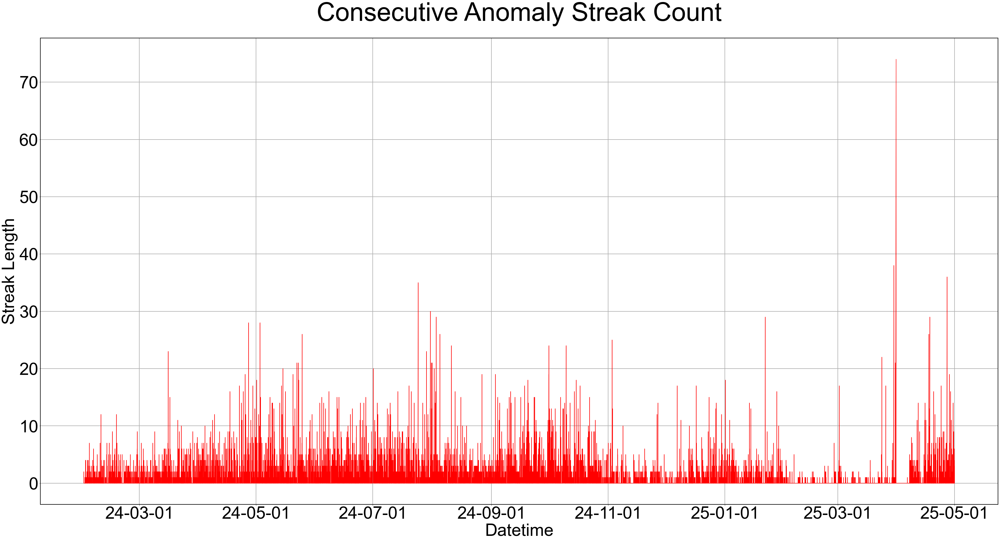

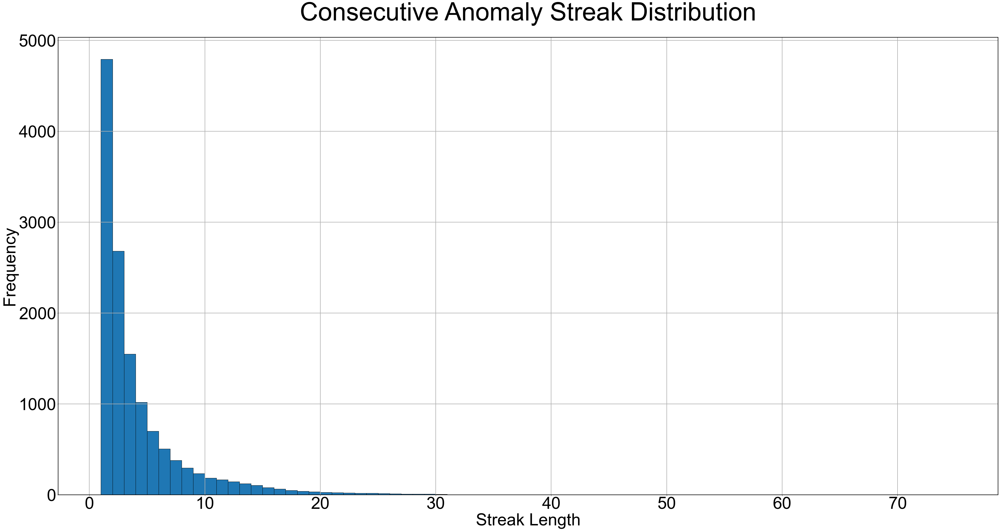

In [15]:
# ----- Parameters & functions -----
value_col = Pres_str  
P_LOW, P_HIGH = 0.0015, 0.9985
WINDOW_DAYS = 60

def aic(ll, k, n):
    return 2*k - 2*ll + 2*k*(k+1)/(n-k-1)

print("[1/7] Configuration loaded.")

# ----- Holidays & regime assignment -----
holiday_dates = {pd.Timestamp(d).date() for d in [
    '2024-01-01','2024-03-29','2024-04-01','2024-05-06',
    '2024-05-27','2024-08-26','2024-12-25','2024-12-26',
    '2024-12-31','2025-01-01','2025-04-18','2025-04-21'
]}
def assign_model(ts):
    return 'weekend' if (ts.weekday() >= 5 or ts.date() in holiday_dates) else 'weekday'

print("[2/7] Regime assignment ready.")

# ----- 2) Fixed outlet percentile thresholds -----
june = Pres10.loc['2025-04-01':'2025-04-06', value_col].astype(float)
a_sn, loc_sn, sc_sn = stats.skewnorm.fit(june)
sh, loc_g, sc_g = stats.gamma.fit(june)
n = len(june)
ll_sn = np.sum(stats.skewnorm.logpdf(june, a_sn, loc_sn, sc_sn))
ll_g  = np.sum(stats.gamma.logpdf(june, sh, loc_g, sc_g))
best = 'sn' if aic(ll_sn,3,n) < aic(ll_g,3,n) else 'g'
if best=='sn':
    static_lower = stats.skewnorm.ppf(P_LOW, a_sn, loc_sn, sc_sn)
    static_upper = stats.skewnorm.ppf(P_HIGH, a_sn, loc_sn, sc_sn)
else:
    static_lower = stats.gamma.ppf(P_LOW, sh, loc_g, sc_g)
    static_upper = stats.gamma.ppf(P_HIGH, sh, loc_g, sc_g)
static_lower = max(static_lower, -4)
static_upper = min(static_upper,  4)
print("[3/7] Static thresholds computed.")

# ----- 3) Monthly threshold computation -----
def compute_pct_thresholds(df):
    groups = df.groupby(['time_5min','model'])[value_col]
    def fit_group(name, x):
        t, m = name
        arr = x.values.astype(float)
        if len(arr) < 5:
            return (t, m, static_lower, static_upper)
        a, l, s = stats.skewnorm.fit(arr)
        sh, lg, sg = stats.gamma.fit(arr)
        ll1 = np.sum(stats.skewnorm.logpdf(arr, a, l, s))
        ll2 = np.sum(stats.gamma.logpdf(arr, sh, lg, sg))
        try:
            a1 = aic(ll1,3,len(arr)); a2 = aic(ll2,3,len(arr))
        except ZeroDivisionError:
            a1, a2 = ll1, ll2
        if a1 < a2:
            lo = stats.skewnorm.ppf(P_LOW, a, l, s)
            hi = stats.skewnorm.ppf(P_HIGH, a, l, s)
        else:
            lo = stats.gamma.ppf(P_LOW, sh, lg, sg)
            hi = stats.gamma.ppf(P_HIGH, sh, lg, sg)
        # enforce hard bounds
        return (t, m, max(lo, -4), min(hi, 4))
    res = Parallel(n_jobs=-1)(delayed(fit_group)(n, g) for n, g in groups)
    df_res = pd.DataFrame(res, columns=['time_5min','model','lower','upper'])
    print(f"    • Fitted {len(df_res)} regimes at {df.index.max().date()}")
    return df_res

print("[4/7] Threshold fitter ready.")

# ----- Initialize window & thresholds -----
window_df = Pres10.loc['2024-01'].copy()
window_df['time_5min'] = window_df.index.floor('5T').time
window_df['model'] = window_df.index.map(assign_model)
thresholds_df = compute_pct_thresholds(window_df)
print("[5/7] Initial adaptive thresholds set.")

# ----- Prepare sim_df -----
sim_df = Pres10.loc['2024-02':'2025-04'].copy()
sim_df['time_5min'] = sim_df.index.floor('5T').time
sim_df['model'] = sim_df.index.map(assign_model)
sim_df = sim_df.merge(
    Fixed_outlet_pressure.rename({'fixed_outlet_pressure':'fixed_flag'},axis=1),
    left_index=True, right_index=True, how='left'
).fillna({'fixed_flag':0})
print("[6/7] Simulation DataFrame ready.")

# ----- Slide window & monthly refit -----
for day in pd.date_range(sim_df.index.min(), sim_df.index.max(), freq='D'):
    window_df = pd.concat([window_df, sim_df.loc[day.strftime('%Y-%m-%d'), [value_col,'time_5min','model']]])
    window_df = window_df[window_df.index > window_df.index.max() - pd.Timedelta(days=WINDOW_DAYS)]
    if day.is_month_start:
        wf = window_df.reset_index().rename(columns={'index':'timestamp'})
        wf = wf[wf[value_col].abs() <= 4]
        wf = wf.merge(thresholds_df, on=['time_5min','model'], how='left')
        ex = (wf[value_col] > wf['upper']) | (wf[value_col] < wf['lower'])
        grp = (ex != ex.shift()).cumsum()
        wf['count'] = ex.groupby(grp).cumcount().add(1).where(ex, 0)
        wf['date'] = wf['timestamp'].dt.date
        good = wf.groupby('date')['count'].max() < 10
        filt = wf[wf['date'].isin(good[good].index)]
        filt = filt.set_index('timestamp')[[value_col,'time_5min','model']]
        thresholds_df = compute_pct_thresholds(filt)
print("[7/7] Adaptive thresholds updated monthly.")

# ----- Anomaly detection -----
merged = sim_df.join(
    thresholds_df.set_index(['time_5min','model']),
    on=['time_5min','model']
)
merged.loc[merged['fixed_flag'] == 1, ['lower','upper']] = static_lower, static_upper
mask = (merged[value_col] > merged['upper']) | (merged[value_col] < merged['lower'])
grps = (mask != mask.shift()).cumsum()
merged['count'] = mask.groupby(grps).cumcount().add(1).where(mask, 0)
merged['absdiff'] = np.where(
    merged[value_col] > merged['upper'],
    merged[value_col] - merged['upper'],
    np.where(merged[value_col] < merged['lower'], merged['lower'] - merged[value_col], 0)
)
print("[8/8] Anomaly detection complete.")

# ----- Finalize & plot -----
flagged_all = merged.copy()
residual10_flagged_all = flagged_all.copy()

# Residual vs. thresholds
fig, ax = plt.subplots()
ax.plot(flagged_all.index, flagged_all[value_col], 'k-', label='Pressure')
ax.plot(flagged_all.index, flagged_all['upper'], 'r--', label='Upper')
ax.plot(flagged_all.index, flagged_all['lower'], 'r--', label='Lower')
ax.set_title('Residual Pressure with Control Limits')
ax.xaxis.set_major_formatter(mdates.DateFormatter('%y-%m-%d'))
ax.legend(); ax.grid(True)
plt.show()

# Anomaly streak count
fig, ax2 = plt.subplots()
ax2.plot(flagged_all.index, flagged_all['count'], 'r-')
ax2.set_title('Consecutive Anomaly Streak Count')
ax2.set_xlabel('Datetime')
ax2.set_ylabel('Streak Length')
ax2.xaxis.set_major_formatter(mdates.DateFormatter('%y-%m-%d'))
ax2.grid(True)
plt.show()

# Histogram of streak lengths
streaks = flagged_all['count'][flagged_all['count'] > 0]
fig, ax3 = plt.subplots()
ax3.hist(streaks, bins=range(1, streaks.max()+2), edgecolor='black')
ax3.set_title('Consecutive Anomaly Streak Distribution')
ax3.set_xlabel('Streak Length')
ax3.set_ylabel('Frequency')
ax3.grid(True)
plt.show()


The code below illustrates control plots between given timestamps based on the analysis above. The start and end dates can be adjusted to view different dates and times.

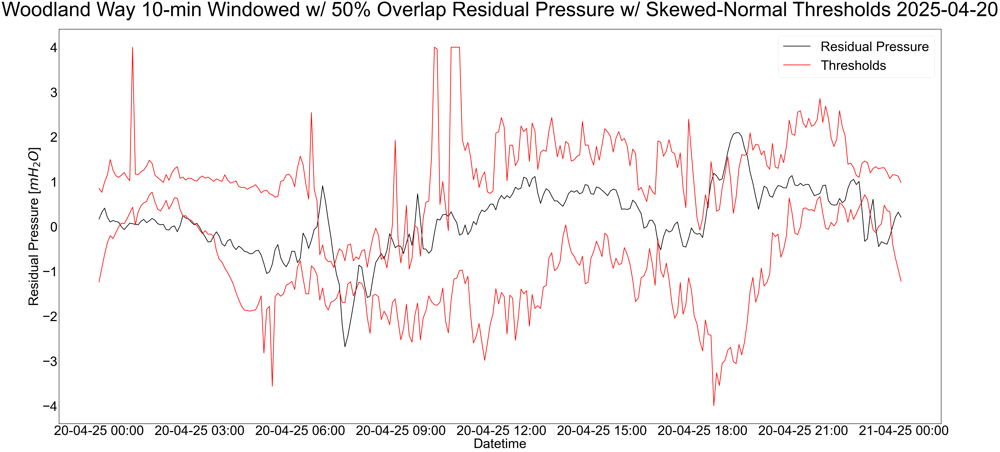

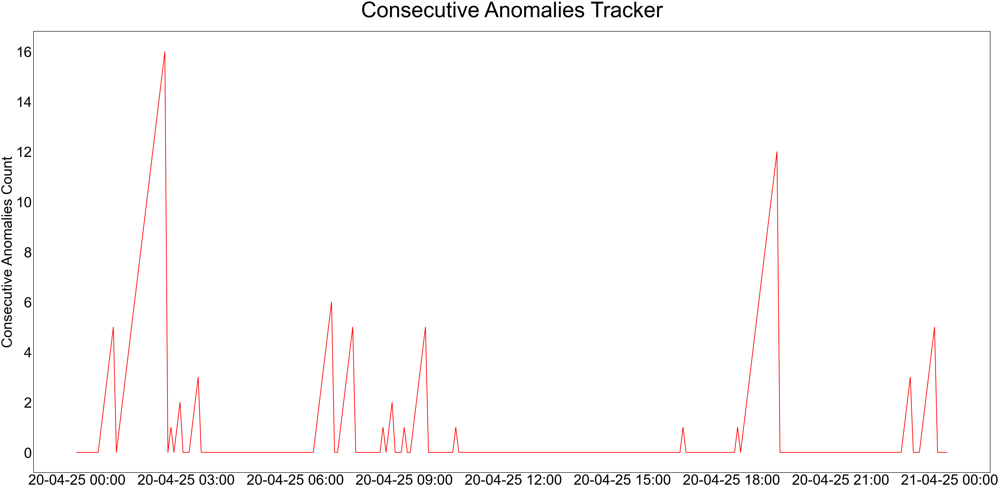

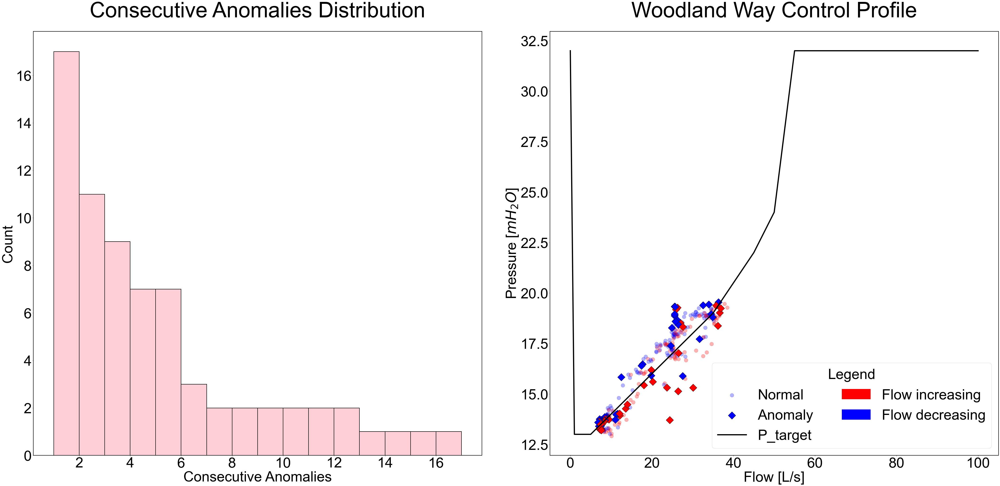

In [16]:
start, end = '2025-04-20','2025-04-20'
value_col = Pres_str
# — Residual Pressure w/ Thresholds —
fig, ax = plt.subplots()
ax.plot(residual10_flagged_all.loc[start:end].index,
        residual10_flagged_all[value_col].loc[start:end],
        'k-', label='Residual Pressure', linewidth = 3)
ax.plot(residual10_flagged_all.loc[start:end].index,
        residual10_flagged_all['upper'].loc[start:end],
        'r-', label='Thresholds', linewidth = 3)
ax.plot(residual10_flagged_all.loc[start:end].index,
        residual10_flagged_all['lower'].loc[start:end],
        'r-', linewidth = 3)
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
#fig.autofmt_xdate(rotation=15)
ax.set_xlabel('Datetime')
ax.set_ylabel(r'Residual Pressure [$mH_2O$]')
ax.set_title(
    f'Woodland Way {T10_str} Residual Pressure w/ Skewed-Normal Thresholds {start}'
)
ax.legend()
plt.tight_layout()
plt.show()


# — Consecutive Anomalies Tracker —
fig, ax = plt.subplots()
ax.plot(residual10_flagged_all.loc[start:end].index,
        residual10_flagged_all['count'].loc[start:end],
        'r-', linewidth = 3)
ax.set_ylabel('Consecutive Anomalies Count')
ax.set_title(f'Consecutive Anomalies Tracker')
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
plt.tight_layout()
plt.show()


# — Histogram + Cla-Val Scatter w/ Control Curve —
hist3 = residual10_flagged_all['count'].loc[start:end]
flow_day = Flow['flow'].loc[start:end]
pout_day = Pout['pressure_out'].loc[start:end]
diff_day = flow_day.diff()
valid   = diff_day.notna()
flow_plot, pout_plot = flow_day[valid], pout_day[valid]
diff_plot = diff_day[valid]
colors    = ['red' if d > 0 else 'blue' for d in diff_plot]

floored        = flow_plot.index.floor('5T')
counts_on_flow = residual10_flagged_all['count'].reindex(floored, fill_value=0)
anomaly_mask   = counts_on_flow.values > 0

days_with_anomalies = (
    residual10_flagged_all.loc[start:end]
    .query('count > 1')
    .index
    .normalize()
    .unique()
)

fig, (ax_hist, ax_scatter) = plt.subplots(ncols=2)
sns.histplot(
    hist3[hist3 > 0],
    bins=range(1, hist3.max() + 2),
    ax=ax_hist,
    color='pink', linewidth = 2
)
ax_hist.set_title(f'Consecutive Anomalies Distribution')
ax_hist.set_xlabel('Consecutive Anomalies')
ax_hist.set_ylabel('Count')

sc_norm = ax_scatter.scatter(
    flow_plot[~anomaly_mask], pout_plot[~anomaly_mask],
    c=[c for c, m in zip(colors, anomaly_mask) if not m],
    edgecolor=[c for c, m in zip(colors, anomaly_mask) if not m],
    s=250, alpha=0.3, label='Normal'
)
sc_anom = ax_scatter.scatter(
    flow_plot[anomaly_mask], pout_plot[anomaly_mask],
    c=[c for c, m in zip(colors, anomaly_mask) if m],
    marker='D', edgecolor='k', s=500, label='Anomaly'
)

ln_curve = None
for day in days_with_anomalies:
    CPdf = get_control_curve(pd.Timestamp(day))
    ln_curve, = ax_scatter.plot(
        CPdf['abb'], CPdf['P_target'],
        linewidth=5, color='black', label='P_target'
    )

red_patch  = Patch(color='red',  label='Flow increasing')
blue_patch = Patch(color='blue', label='Flow decreasing')
handles = [sc_norm, sc_anom, ln_curve, red_patch, blue_patch]
labels  = ['Normal', 'Anomaly', 'P_target', 'Flow increasing', 'Flow decreasing']
ax_scatter.legend(
    handles=handles,
    labels=labels,
    loc='lower right',
    ncol=2,
    title='Legend'
)

ax_scatter.set(
    title=f"Woodland Way Control Profile",
    xlabel='Flow [L/s]',
    ylabel=r'Pressure [$mH_2O$]'
)

plt.tight_layout()
plt.show()

### 2.5. Window Strategy comparison

This section provides an analysis of the flagged timestamps from each windowing strategy.

In [17]:
period_start = pd.Timestamp('2024-01-01')
period_end   = pd.Timestamp('2025-04-30')
n_days       = (period_end - period_start).days + 1  # inclusive

def summarize_anomalies(df, name):
    mask = df['count'] > 0
    ts       = df.index.to_series()
    deltas   = ts.diff().shift(-1)
    deltas.iloc[-1] = deltas.median()
    total_time    = deltas[mask].sum()
    total_minutes = total_time / pd.Timedelta('1T')
    grp           = (mask != mask.shift(fill_value=False)).cumsum()
    event_lengths = df.loc[mask].groupby(grp).size()
    avg_minutes = total_minutes / n_days

    starts       = mask & ~mask.shift(fill_value=False)
    event_dates  = df.index[starts].normalize()
    daily_events = pd.Series(event_dates).value_counts().sort_index()
    avg_events   = daily_events.mean()

    n_single  = (event_lengths == 1).sum()
    n_lt5     = (event_lengths < 5).sum()
    n_lt15    = (event_lengths < 15).sum()
    n_lt60    = (event_lengths < 60).sum()
    n_gt60    = (event_lengths > 60).sum() 

    is_anom = mask.astype(int)
    anom_min_by_month = (
        is_anom
          .resample('M')
          .sum()
          .loc['2024-02':'2025-04']
    )
    mm_most   = anom_min_by_month.idxmax().strftime('%Y-%m')
    mm_least  = anom_min_by_month.idxmin().strftime('%Y-%m')
    val_most  = anom_min_by_month.max()
    val_least = anom_min_by_month.min()
    event_month     = df.index[starts].to_period('M')
    anom_evt_by_month = (
        event_month.value_counts()
                    .sort_index()
                    .loc[lambda s: s.index != pd.Period('2024-01')]
    )
    me_most   = anom_evt_by_month.idxmax().strftime('%Y-%m')
    me_least  = anom_evt_by_month.idxmin().strftime('%Y-%m')
    ev_most   = anom_evt_by_month.max()
    ev_least  = anom_evt_by_month.min()
    total_events = anom_evt_by_month.sum()

    print(f"\n=== {name} ===")
    print(f"Total flagged minutes:    {total_minutes:.0f}")
    print(f"Avg anomaly‐minutes/day:  {avg_minutes:.2f}")
    print(f"Avg anomaly‐events/day:   {avg_events:.2f}\n")

    print("Event duration counts:")
    print(f"  single-minute:           {n_single}")
    print(f"  <5 min:                  {n_lt5-n_single}")
    print(f"  <15 min:                 {n_lt15-n_lt5}")
    print(f"  <1 h:                    {n_lt60-n_lt15}")
    print(f"  >1 h:                    {n_gt60}\n")

    print("Anomaly‐minutes by month:")
    print(f"  Most:  {mm_most} ({val_most:.0f} min)")
    print(f"  Least: {mm_least} ({val_least:.0f} min)\n")

    print("Anomaly‐events by month:")
    print(f"  Most:  {me_most} ({ev_most} events)")
    print(f"  Least: {me_least} ({ev_least} events)")
    print(f"Total events:             {total_events}")

In [18]:
models = {
    'Fixed 5-min residual':   residual_flagged_all,
    '10-min windows w/ 50% overlap residual': residual10_flagged_all,
}

for name, df in models.items():
    summarize_anomalies(df, name)


=== Fixed 5-min residual ===
Total flagged minutes:    60995
Avg anomaly‐minutes/day:  125.50
Avg anomaly‐events/day:   14.08

Event duration counts:
  single-minute:           4052
  <5 min:                  1696
  <15 min:                 419
  <1 h:                    41
  >1 h:                    1

Anomaly‐minutes by month:
  Most:  2024-07 (1368 min)
  Least: 2025-02 (77 min)

Anomaly‐events by month:
  Most:  2024-06 (633 events)
  Least: 2025-02 (74 events)
Total events:             6209

=== 10-min windows w/ 50% overlap residual ===
Total flagged minutes:    66890
Avg anomaly‐minutes/day:  137.63
Avg anomaly‐events/day:   10.97

Event duration counts:
  single-minute:           2112
  <5 min:                  1983
  <15 min:                 620
  <1 h:                    79
  >1 h:                    1

Anomaly‐minutes by month:
  Most:  2024-07 (1453 min)
  Least: 2025-02 (111 min)

Anomaly‐events by month:
  Most:  2024-07 (453 events)
  Least: 2025-02 (76 events)
Total ev

## 3. Normalised Residual Pressure

This section contains the fault detection analysis with normalised residual pressures. The analysis is carried out using 5-minute normalised residuals and 10-minute normalised resiudals with a 50% overlap.

### 3.1. Fault Detection w/ Fixed 5-Min Windows

[1/7] Configuration loaded.
[2/7] Regime assignment ready.
[3/7] Static thresholds computed.
[4/7] Threshold fitter ready.
    • Fitted 576 regimes at 2024-01-31
[5/7] Initial adaptive thresholds set.
[6/7] Simulation DataFrame ready.
    • Fitted 576 regimes at 2024-02-01
    • Fitted 576 regimes at 2024-03-01
    • Fitted 576 regimes at 2024-04-01
    • Fitted 576 regimes at 2024-05-01
    • Fitted 576 regimes at 2024-06-01
    • Fitted 576 regimes at 2024-07-01
    • Fitted 576 regimes at 2024-08-01
    • Fitted 576 regimes at 2024-09-01
    • Fitted 576 regimes at 2024-10-01
    • Fitted 576 regimes at 2024-11-01
    • Fitted 576 regimes at 2024-12-01
    • Fitted 576 regimes at 2025-01-01
    • Fitted 576 regimes at 2025-02-01
    • Fitted 576 regimes at 2025-03-01
    • Fitted 576 regimes at 2025-03-28
[7/7] Adaptive thresholds updated monthly.
[8/8] Anomaly detection complete.


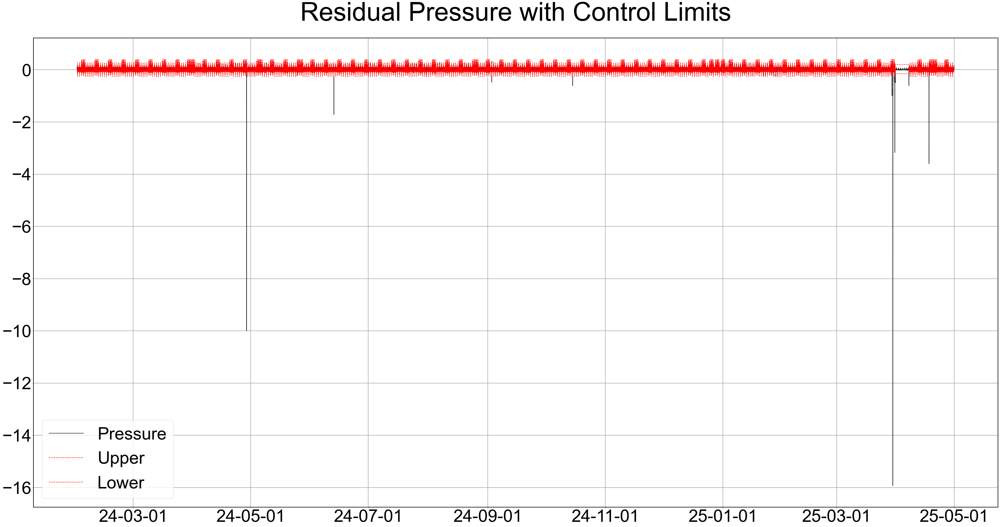

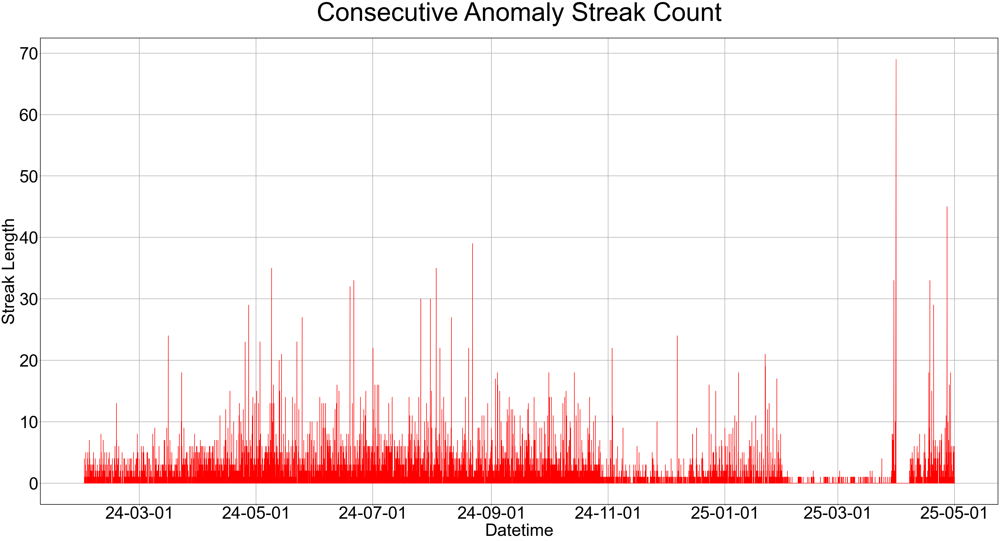

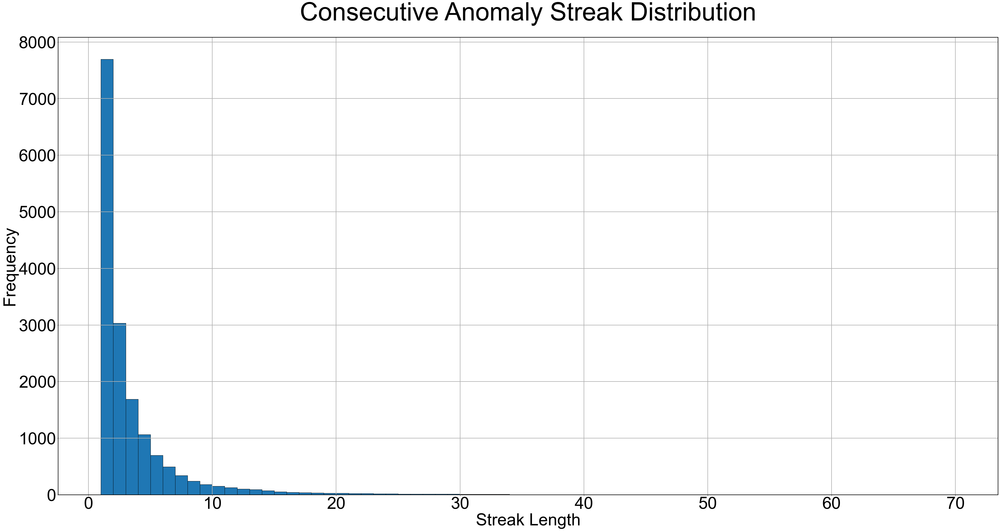

In [19]:
# ----- Pparameters & functions -----
value_col = Normalised_str
P_LOW, P_HIGH = 0.0015, 0.9985
WINDOW_DAYS = 60

def aic(ll, k, n):
    return 2*k - 2*ll + 2*k*(k+1)/(n-k-1)

print("[1/7] Configuration loaded.")

# ----- 1) Holidays & regime assignment -----
holiday_dates = {pd.Timestamp(d).date() for d in [
    '2024-01-01','2024-03-29','2024-04-01','2024-05-06',
    '2024-05-27','2024-08-26','2024-12-25','2024-12-26',
    '2024-12-31','2025-01-01','2025-04-18','2025-04-21'
]}
def assign_model(ts):
    return 'weekend' if (ts.weekday() >= 5 or ts.date() in holiday_dates) else 'weekday'

print("[2/7] Regime assignment ready.")

# ----- 2) Fixed outlet percentile thresholds -----
june = Normalised.loc['2024-05-18':'2024-07', value_col].astype(float)
a_sn, loc_sn, sc_sn = stats.skewnorm.fit(june)
sh, loc_g, sc_g = stats.gamma.fit(june)
n = len(june)
ll_sn = np.sum(stats.skewnorm.logpdf(june, a_sn, loc_sn, sc_sn))
ll_g  = np.sum(stats.gamma.logpdf(june, sh, loc_g, sc_g))
best = 'sn' if aic(ll_sn,3,n) < aic(ll_g,3,n) else 'g'
if best=='sn':
    static_lower = stats.skewnorm.ppf(P_LOW, a_sn, loc_sn, sc_sn)
    static_upper = stats.skewnorm.ppf(P_HIGH, a_sn, loc_sn, sc_sn)
else:
    static_lower = stats.gamma.ppf(P_LOW, sh, loc_g, sc_g)
    static_upper = stats.gamma.ppf(P_HIGH, sh, loc_g, sc_g)
# enforce max threshold values ±4
static_lower = max(static_lower, -0.4)
static_upper = min(static_upper,  0.4)
print("[3/7] Static thresholds computed.")

# ----- Monthly threshold computation -----
def compute_pct_thresholds(df):
    groups = df.groupby(['time_5min','model'])[value_col]
    def fit_group(name, x):
        t, m = name
        arr = x.values.astype(float)
        if len(arr) < 5:
            return (t, m, static_lower, static_upper)
        a, l, s = stats.skewnorm.fit(arr)
        sh, lg, sg = stats.gamma.fit(arr)
        ll1 = np.sum(stats.skewnorm.logpdf(arr, a, l, s))
        ll2 = np.sum(stats.gamma.logpdf(arr, sh, lg, sg))
        try:
            a1 = aic(ll1,3,len(arr)); a2 = aic(ll2,3,len(arr))
        except ZeroDivisionError:
            a1, a2 = ll1, ll2
        if a1 < a2:
            lo = stats.skewnorm.ppf(P_LOW, a, l, s)
            hi = stats.skewnorm.ppf(P_HIGH, a, l, s)
        else:
            lo = stats.gamma.ppf(P_LOW, sh, lg, sg)
            hi = stats.gamma.ppf(P_HIGH, sh, lg, sg)
        return (t, m, max(lo, -0.4), min(hi, 0.4))
    res = Parallel(n_jobs=-1)(delayed(fit_group)(n, g) for n, g in groups)
    df_res = pd.DataFrame(res, columns=['time_5min','model','lower','upper'])
    print(f"    • Fitted {len(df_res)} regimes at {df.index.max().date()}")
    return df_res

print("[4/7] Threshold fitter ready.")

# ----- Initialize window & thresholds -----
window_df = Normalised.loc['2024-01'].copy()
window_df['time_5min'] = window_df.index.floor('5T').time
window_df['model'] = window_df.index.map(assign_model)
thresholds_df = compute_pct_thresholds(window_df)
print("[5/7] Initial adaptive thresholds set.")

# ----- Prepare sim_df -----
sim_df = Normalised.loc['2024-02':'2025-04'].copy()
sim_df['time_5min'] = sim_df.index.floor('5T').time
sim_df['model'] = sim_df.index.map(assign_model)
sim_df = sim_df.merge(
    Fixed_outlet_pressure.rename({'fixed_outlet_pressure':'fixed_flag'},axis=1),
    left_index=True, right_index=True, how='left'
).fillna({'fixed_flag':0})
print("[6/7] Simulation DataFrame ready.")

# ----- Slide window & monthly refit -----
for day in pd.date_range(sim_df.index.min(), sim_df.index.max(), freq='D'):
    window_df = pd.concat([window_df, sim_df.loc[day.strftime('%Y-%m-%d'), [value_col,'time_5min','model']]])
    window_df = window_df[window_df.index > window_df.index.max() - pd.Timedelta(days=WINDOW_DAYS)]
    if day.is_month_start:
        wf = window_df.reset_index().rename(columns={'index':'timestamp'})
        wf = wf[wf[value_col].abs() <= 4]
        wf = wf.merge(thresholds_df, on=['time_5min','model'], how='left')
        ex = (wf[value_col] > wf['upper']) | (wf[value_col] < wf['lower'])
        grp = (ex != ex.shift()).cumsum()
        wf['count'] = ex.groupby(grp).cumcount().add(1).where(ex, 0)
        wf['date'] = wf['timestamp'].dt.date
        good = wf.groupby('date')['count'].max() <= 10
        filt = wf[wf['date'].isin(good[good].index)]
        filt = filt.set_index('timestamp')[[value_col,'time_5min','model']]
        thresholds_df = compute_pct_thresholds(filt)
print("[7/7] Adaptive thresholds updated monthly.")

# ----- Vectorized anomaly detection -----
merged = sim_df.join(
    thresholds_df.set_index(['time_5min','model']),
    on=['time_5min','model']
)
merged.loc[merged['fixed_flag'] == 1, ['lower','upper']] = static_lower, static_upper
mask = (merged[value_col] > merged['upper']) | (merged[value_col] < merged['lower'])
grps = (mask != mask.shift()).cumsum()
merged['count'] = mask.groupby(grps).cumcount().add(1).where(mask, 0)
merged['absdiff'] = np.where(
    merged[value_col] > merged['upper'],
    merged[value_col] - merged['upper'],
    np.where(merged[value_col] < merged['lower'], merged['lower'] - merged[value_col], 0)
)
print("[8/8] Anomaly detection complete.")

# ----- Finalize & plot -----
flagged_all = merged.copy()
normalised_flagged_all = flagged_all.copy()

# Residual vs. thresholds
fig, ax = plt.subplots()
ax.plot(flagged_all.index, flagged_all[value_col], 'k-', label='Pressure')
ax.plot(flagged_all.index, flagged_all['upper'], 'r--', label='Upper')
ax.plot(flagged_all.index, flagged_all['lower'], 'r--', label='Lower')
ax.set_title('Residual Pressure with Control Limits')
ax.xaxis.set_major_formatter(mdates.DateFormatter('%y-%m-%d'))
ax.legend(); ax.grid(True)
plt.show()

# Anomaly count
fig, ax2 = plt.subplots()
ax2.plot(flagged_all.index, flagged_all['count'], 'r-')
ax2.set_title('Consecutive Anomaly Streak Count')
ax2.set_xlabel('Datetime')
ax2.set_ylabel('Streak Length')
ax2.xaxis.set_major_formatter(mdates.DateFormatter('%y-%m-%d'))
ax2.grid(True)
plt.show()

# Histogram of anomaly lengths
streaks = flagged_all['count'][flagged_all['count'] > 0]
fig, ax3 = plt.subplots()
ax3.hist(streaks, bins=range(1, streaks.max()+2), edgecolor='black')
ax3.set_title('Consecutive Anomaly Streak Distribution')
ax3.set_xlabel('Streak Length')
ax3.set_ylabel('Frequency')
ax3.grid(True)
plt.show()


The code below illustrates control plots between given timestamps based on the analysis above. The start and end dates can be adjusted to view different dates and times.

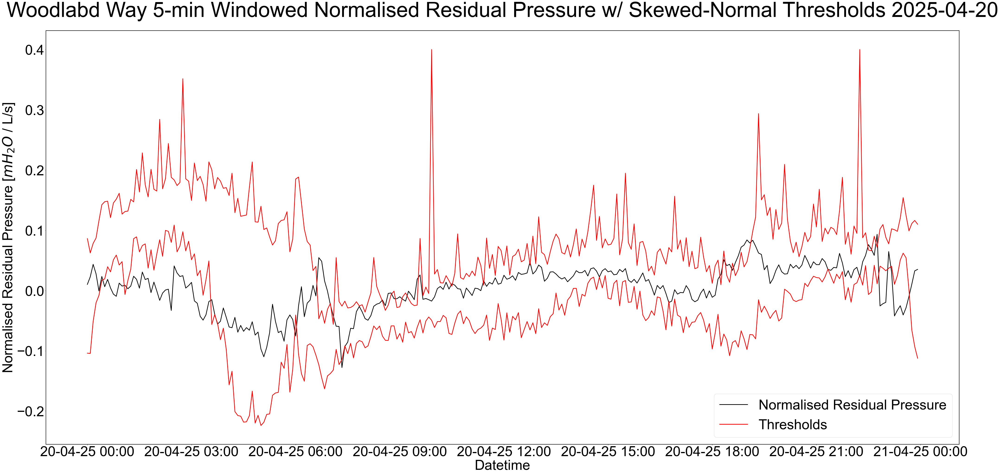

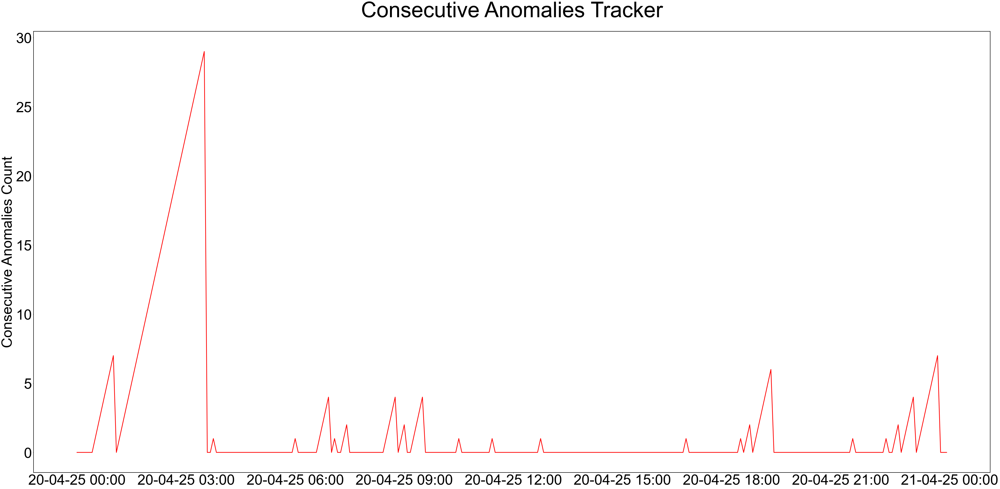

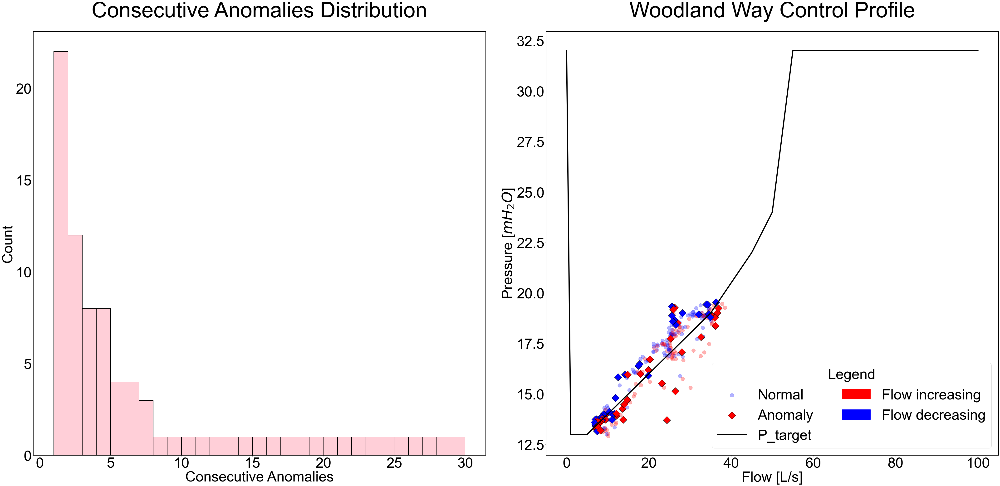

In [20]:
start, end = '2025-04-20','2025-04-20'

# —Residual Pressure w/ Thresholds —
fig, ax = plt.subplots()
ax.plot(normalised_flagged_all.loc[start:end].index,
        normalised_flagged_all[value_col].loc[start:end],
        'k-', label='Normalised Residual Pressure', linewidth = 3)
ax.plot(normalised_flagged_all.loc[start:end].index,
        normalised_flagged_all['upper'].loc[start:end],
        'r-', label='Thresholds', linewidth = 3)
ax.plot(normalised_flagged_all.loc[start:end].index,
        normalised_flagged_all['lower'].loc[start:end],
        'r-', linewidth = 3)
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
#fig.autofmt_xdate(rotation=15)
ax.set_xlabel('Datetime')
ax.set_ylabel(r'Normalised Residual Pressure [$mH_2O$ / L/s]')
ax.set_title(
    f'Woodlabd Way {T_str} Normalised Residual Pressure w/ Skewed-Normal Thresholds {start}'
)
ax.legend()
plt.tight_layout()
plt.show()


# — Consecutive Anomalies Tracker —
fig, ax = plt.subplots()
ax.plot(normalised_flagged_all.loc[start:end].index,
        normalised_flagged_all['count'].loc[start:end],
        'r-', linewidth = 3)
ax.set_ylabel('Consecutive Anomalies Count')
ax.set_title(f'Consecutive Anomalies Tracker')
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
plt.tight_layout()
plt.show()


# — Histogram + Cla-Val Scatter w/ Control Curve  —
hist3 = normalised_flagged_all['count'].loc[start:end]
flow_day = Flow['flow'].loc[start:end]
pout_day = Pout['pressure_out'].loc[start:end]
diff_day = flow_day.diff()
valid   = diff_day.notna()
flow_plot, pout_plot = flow_day[valid], pout_day[valid]
diff_plot = diff_day[valid]
colors    = ['red' if d > 0 else 'blue' for d in diff_plot]
floored        = flow_plot.index.floor('5T')
counts_on_flow = normalised_flagged_all['count'].reindex(floored, fill_value=0)
anomaly_mask   = counts_on_flow.values > 0
days_with_anomalies = (
    normalised_flagged_all.loc[start:end]
    .query('count > 1')
    .index
    .normalize()
    .unique()
)

fig, (ax_hist, ax_scatter) = plt.subplots(ncols=2)
sns.histplot(
    hist3[hist3 > 0],
    bins=range(1, hist3.max() + 2),
    ax=ax_hist,
    color='pink', linewidth = 2
)
ax_hist.set_title(f'Consecutive Anomalies Distribution')
ax_hist.set_xlabel('Consecutive Anomalies')
ax_hist.set_ylabel('Count')

sc_norm = ax_scatter.scatter(
    flow_plot[~anomaly_mask], pout_plot[~anomaly_mask],
    c=[c for c, m in zip(colors, anomaly_mask) if not m],
    edgecolor=[c for c, m in zip(colors, anomaly_mask) if not m],
    s=250, alpha=0.3, label='Normal'
)
sc_anom = ax_scatter.scatter(
    flow_plot[anomaly_mask], pout_plot[anomaly_mask],
    c=[c for c, m in zip(colors, anomaly_mask) if m],
    marker='D', edgecolor='k', s=500, label='Anomaly'
)

ln_curve = None
for day in days_with_anomalies:
    CPdf = get_control_curve(pd.Timestamp(day))
    ln_curve, = ax_scatter.plot(
        CPdf['abb'], CPdf['P_target'],
        linewidth=5, color='black', label='P_target'
    )

red_patch  = Patch(color='red',  label='Flow increasing')
blue_patch = Patch(color='blue', label='Flow decreasing')
handles = [sc_norm, sc_anom, ln_curve, red_patch, blue_patch]
labels  = ['Normal', 'Anomaly', 'P_target', 'Flow increasing', 'Flow decreasing']
ax_scatter.legend(
    handles=handles,
    labels=labels,
    loc='lower right',
    ncol=2,
    title='Legend'
)

ax_scatter.set(
    title=f"Woodland Way Control Profile",
    xlabel='Flow [L/s]',
    ylabel=r'Pressure [$mH_2O$]'
)

plt.tight_layout()
plt.show()

### 3.2. Fault Detection w/ 10-Min Windows w/ 50% Overlap

[1/7] Configuration loaded.
[2/7] Regime assignment ready.
[3/7] Static thresholds computed.
[4/7] Threshold fitter ready.
    • Fitted 576 regimes at 2024-01-31
[5/7] Initial adaptive thresholds set.
[6/7] Simulation DataFrame ready.
    • Fitted 576 regimes at 2024-02-01
    • Fitted 576 regimes at 2024-03-01
    • Fitted 576 regimes at 2024-04-01
    • Fitted 576 regimes at 2024-04-27
    • Fitted 576 regimes at 2024-06-01
    • Fitted 576 regimes at 2024-07-01
    • Fitted 576 regimes at 2024-08-01
    • Fitted 576 regimes at 2024-09-01
    • Fitted 576 regimes at 2024-10-01
    • Fitted 576 regimes at 2024-11-01
    • Fitted 576 regimes at 2024-12-01
    • Fitted 576 regimes at 2025-01-01
    • Fitted 576 regimes at 2025-02-01
    • Fitted 576 regimes at 2025-02-28
    • Fitted 576 regimes at 2025-03-28
[7/7] Adaptive thresholds updated monthly.
[8/8] Anomaly detection complete.


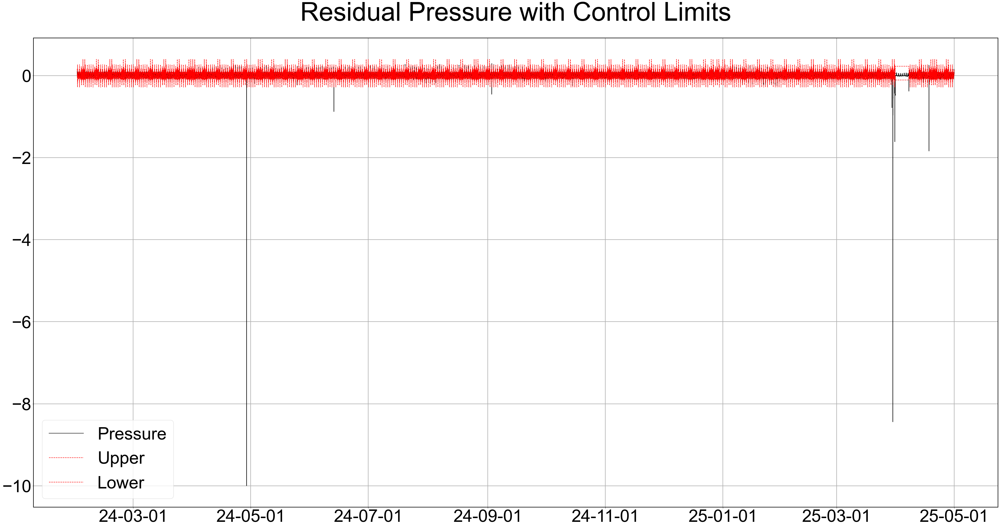

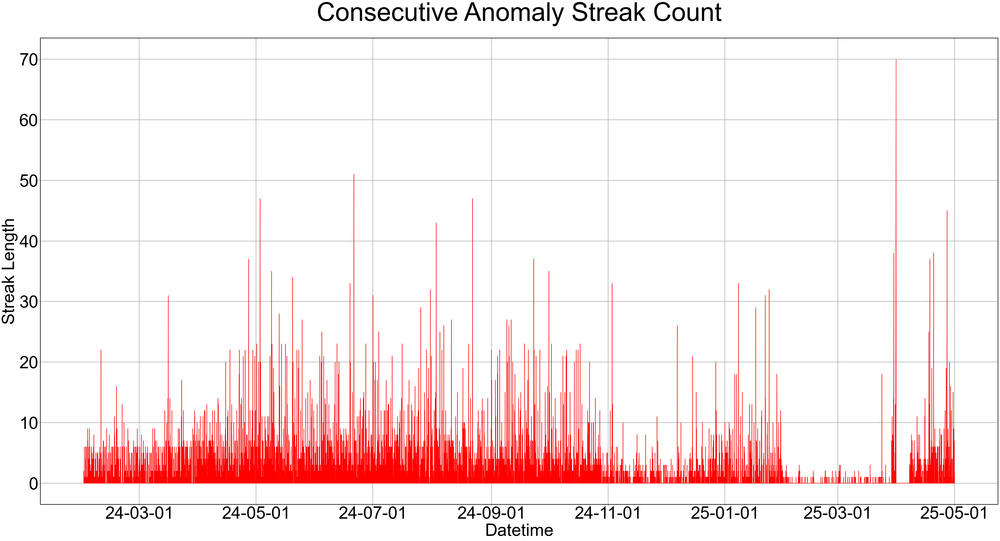

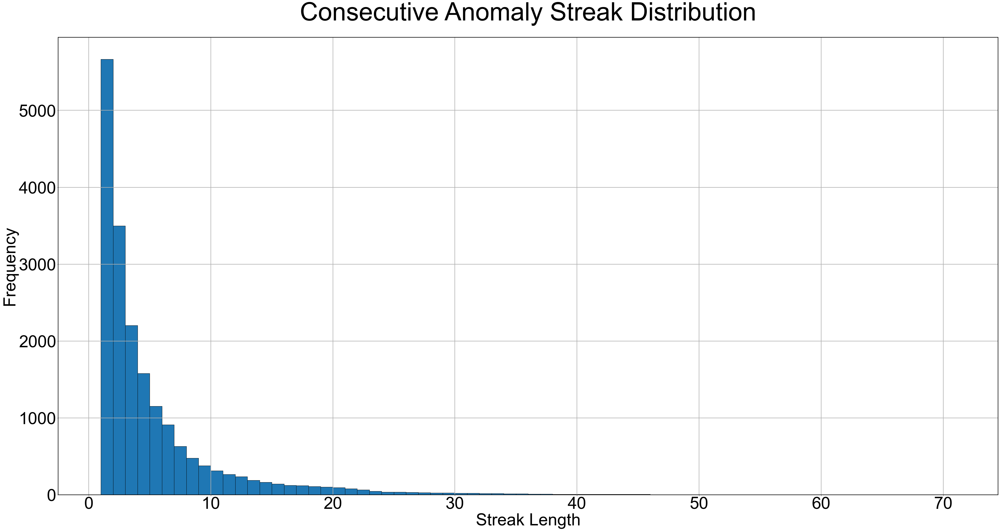

In [21]:
# ----- 0) Parameters & functions -----
value_col = Normalised_str  
P_LOW, P_HIGH = 0.0015, 0.9985
WINDOW_DAYS = 60

def aic(ll, k, n):
    return 2*k - 2*ll + 2*k*(k+1)/(n-k-1)

print("[1/7] Configuration loaded.")

# ----- 1) Holidays & regime assignment -----
holiday_dates = {pd.Timestamp(d).date() for d in [
    '2024-01-01','2024-03-29','2024-04-01','2024-05-06',
    '2024-05-27','2024-08-26','2024-12-25','2024-12-26',
    '2024-12-31','2025-01-01','2025-04-18','2025-04-21'
]}
def assign_model(ts):
    return 'weekend' if (ts.weekday() >= 5 or ts.date() in holiday_dates) else 'weekday'

print("[2/7] Regime assignment ready.")

# ----- Fixed outlet percentile thresholds -----
june = Normalised10.loc['2024-05-18':'2024-07', value_col].astype(float)
a_sn, loc_sn, sc_sn = stats.skewnorm.fit(june)
sh, loc_g, sc_g = stats.gamma.fit(june)
n = len(june)
ll_sn = np.sum(stats.skewnorm.logpdf(june, a_sn, loc_sn, sc_sn))
ll_g  = np.sum(stats.gamma.logpdf(june, sh, loc_g, sc_g))
best = 'sn' if aic(ll_sn,3,n) < aic(ll_g,3,n) else 'g'
if best=='sn':
    static_lower = stats.skewnorm.ppf(P_LOW, a_sn, loc_sn, sc_sn)
    static_upper = stats.skewnorm.ppf(P_HIGH, a_sn, loc_sn, sc_sn)
else:
    static_lower = stats.gamma.ppf(P_LOW, sh, loc_g, sc_g)
    static_upper = stats.gamma.ppf(P_HIGH, sh, loc_g, sc_g)
static_lower = max(static_lower, -0.4)
static_upper = min(static_upper,  0.4)
print("[3/7] Static thresholds computed.")

# -----Monthly threshold computation -----
def compute_pct_thresholds(df):
    """
    Fit skewnorm & gamma per (time_5min, model), pick by AIC,
    return DataFrame with ['time_5min','model','lower','upper'].
    """
    groups = df.groupby(['time_5min','model'])[value_col]
    def fit_group(name, x):
        t, m = name
        arr = x.values.astype(float)
        if len(arr) < 5:
            return (t, m, static_lower, static_upper)
        a, l, s = stats.skewnorm.fit(arr)
        sh, lg, sg = stats.gamma.fit(arr)
        ll1 = np.sum(stats.skewnorm.logpdf(arr, a, l, s))
        ll2 = np.sum(stats.gamma.logpdf(arr, sh, lg, sg))
        try:
            a1 = aic(ll1,3,len(arr)); a2 = aic(ll2,3,len(arr))
        except ZeroDivisionError:
            a1, a2 = ll1, ll2
        if a1 < a2:
            lo = stats.skewnorm.ppf(P_LOW, a, l, s)
            hi = stats.skewnorm.ppf(P_HIGH, a, l, s)
        else:
            lo = stats.gamma.ppf(P_LOW, sh, lg, sg)
            hi = stats.gamma.ppf(P_HIGH, sh, lg, sg)
        return (t, m, max(lo, -0.4), min(hi, 0.4))
    res = Parallel(n_jobs=-1)(delayed(fit_group)(n, g) for n, g in groups)
    df_res = pd.DataFrame(res, columns=['time_5min','model','lower','upper'])
    print(f"    • Fitted {len(df_res)} regimes at {df.index.max().date()}")
    return df_res

print("[4/7] Threshold fitter ready.")

# ----- Initialize window & thresholds -----
window_df = Normalised10.loc['2024-01'].copy()
window_df['time_5min'] = window_df.index.floor('5T').time
window_df['model'] = window_df.index.map(assign_model)
thresholds_df = compute_pct_thresholds(window_df)
print("[5/7] Initial adaptive thresholds set.")

# ----- Prepare sim_df -----
sim_df = Normalised10.loc['2024-02':'2025-04'].copy()
sim_df['time_5min'] = sim_df.index.floor('5T').time
sim_df['model'] = sim_df.index.map(assign_model)
sim_df = sim_df.merge(
    Fixed_outlet_pressure.rename({'fixed_outlet_pressure':'fixed_flag'},axis=1),
    left_index=True, right_index=True, how='left'
).fillna({'fixed_flag':0})
print("[6/7] Simulation DataFrame ready.")

# ----- Slide window & monthly refit -----
for day in pd.date_range(sim_df.index.min(), sim_df.index.max(), freq='D'):
    window_df = pd.concat([window_df, sim_df.loc[day.strftime('%Y-%m-%d'), [value_col,'time_5min','model']]])
    window_df = window_df[window_df.index > window_df.index.max() - pd.Timedelta(days=WINDOW_DAYS)]
    if day.is_month_start:
        wf = window_df.reset_index().rename(columns={'index':'timestamp'})
        # drop extreme values
        wf = wf[wf[value_col].abs() <= 4]
        wf = wf.merge(thresholds_df, on=['time_5min','model'], how='left')
        ex = (wf[value_col] > wf['upper']) | (wf[value_col] < wf['lower'])
        grp = (ex != ex.shift()).cumsum()
        wf['count'] = ex.groupby(grp).cumcount().add(1).where(ex, 0)
        wf['date'] = wf['timestamp'].dt.date
        good = wf.groupby('date')['count'].max() <= 10
        filt = wf[wf['date'].isin(good[good].index)]
        filt = filt.set_index('timestamp')[[value_col,'time_5min','model']]
        thresholds_df = compute_pct_thresholds(filt)
print("[7/7] Adaptive thresholds updated monthly.")

# ----- Vectorized anomaly detection -----
merged = sim_df.join(
    thresholds_df.set_index(['time_5min','model']),
    on=['time_5min','model']
)
merged.loc[merged['fixed_flag'] == 1, ['lower','upper']] = static_lower, static_upper
mask = (merged[value_col] > merged['upper']) | (merged[value_col] < merged['lower'])
grps = (mask != mask.shift()).cumsum()
merged['count'] = mask.groupby(grps).cumcount().add(1).where(mask, 0)
merged['absdiff'] = np.where(
    merged[value_col] > merged['upper'],
    merged[value_col] - merged['upper'],
    np.where(merged[value_col] < merged['lower'], merged['lower'] - merged[value_col], 0)
)
print("[8/8] Anomaly detection complete.")

# ----- Finalize & plot -----
flagged_all = merged.copy()
normalised10_flagged_all = flagged_all.copy()

# Residual vs. thresholds
fig, ax = plt.subplots()
ax.plot(flagged_all.index, flagged_all[value_col], 'k-', label='Pressure')
ax.plot(flagged_all.index, flagged_all['upper'], 'r--', label='Upper')
ax.plot(flagged_all.index, flagged_all['lower'], 'r--', label='Lower')
ax.set_title('Residual Pressure with Control Limits')
ax.xaxis.set_major_formatter(mdates.DateFormatter('%y-%m-%d'))
ax.legend(); ax.grid(True)
plt.show()

# Anomaly  count
fig, ax2 = plt.subplots()
ax2.plot(flagged_all.index, flagged_all['count'], 'r-')
ax2.set_title('Consecutive Anomaly Streak Count')
ax2.set_xlabel('Datetime')
ax2.set_ylabel('Streak Length')
ax2.xaxis.set_major_formatter(mdates.DateFormatter('%y-%m-%d'))
ax2.grid(True)
plt.show()

# Histogram of anomaly lengths
streaks = flagged_all['count'][flagged_all['count'] > 0]
fig, ax3 = plt.subplots()
ax3.hist(streaks, bins=range(1, streaks.max()+2), edgecolor='black')
ax3.set_title('Consecutive Anomaly Streak Distribution')
ax3.set_xlabel('Streak Length')
ax3.set_ylabel('Frequency')
ax3.grid(True)
plt.show()


The code below illustrates control plots between given timestamps based on the analysis above. The start and end dates can be adjusted to view different dates and times.

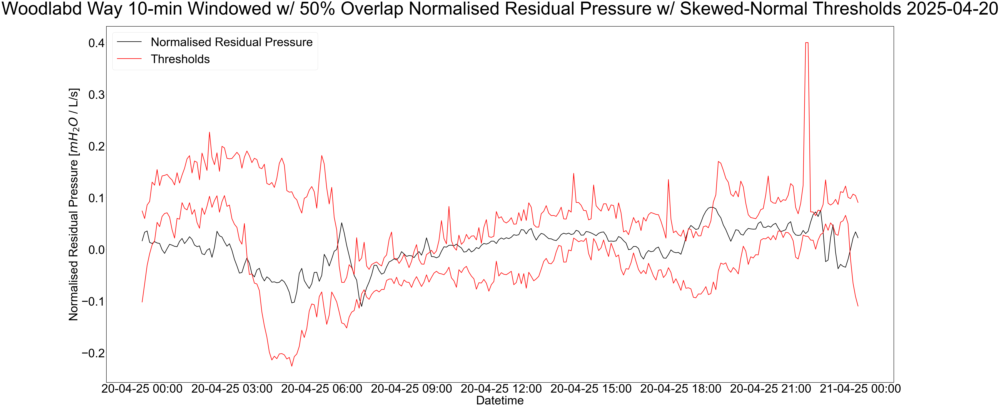

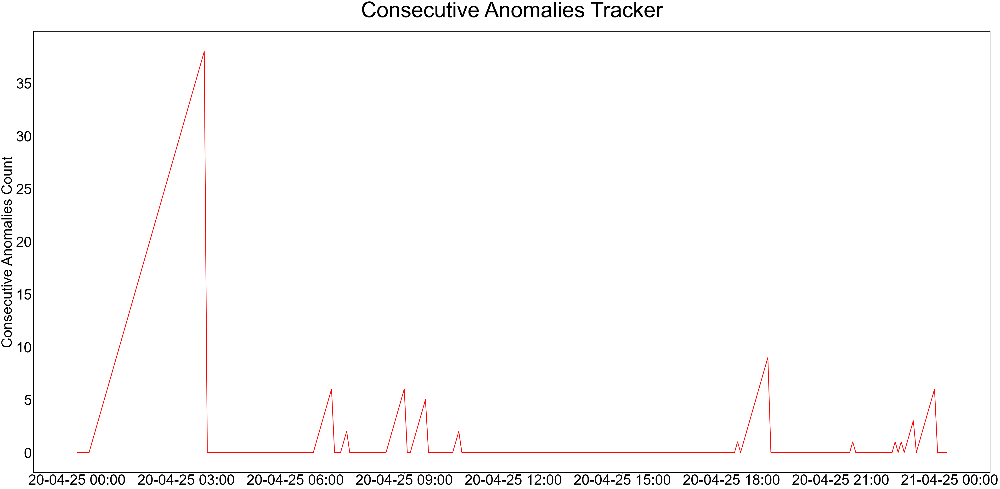

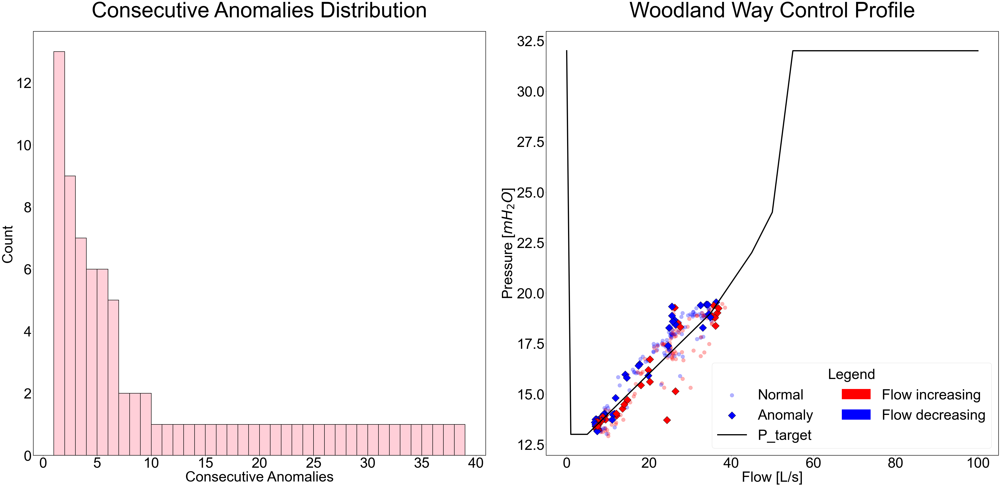

In [22]:
start, end = '2025-04-20','2025-04-20'

# — Residual Pressure w/ Thresholds —
fig, ax = plt.subplots()
ax.plot(normalised10_flagged_all.loc[start:end].index,
        normalised10_flagged_all[value_col].loc[start:end],
        'k-', label='Normalised Residual Pressure', linewidth = 3)
ax.plot(normalised10_flagged_all.loc[start:end].index,
        normalised10_flagged_all['upper'].loc[start:end],
        'r-', label='Thresholds', linewidth = 3)
ax.plot(normalised10_flagged_all.loc[start:end].index,
        normalised10_flagged_all['lower'].loc[start:end],
        'r-', linewidth = 3)
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
#fig.autofmt_xdate(rotation=15)
ax.set_xlabel('Datetime')
ax.set_ylabel(r'Normalised Residual Pressure [$mH_2O$ / L/s]')
ax.set_title(
    f'Woodlabd Way {T10_str} Normalised Residual Pressure w/ Skewed-Normal Thresholds {start}'
)
ax.legend()
plt.tight_layout()
plt.show()


# — Consecutive Anomalies Tracker —
fig, ax = plt.subplots()
ax.plot(normalised10_flagged_all.loc[start:end].index,
        normalised10_flagged_all['count'].loc[start:end],
        'r-', linewidth = 3)
ax.set_ylabel('Consecutive Anomalies Count')
ax.set_title(f'Consecutive Anomalies Tracker')
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
plt.tight_layout()
plt.show()


# — Histogram + Cla-Val Scatter w/ Control Curve —
hist3 = normalised10_flagged_all['count'].loc[start:end]
flow_day = Flow['flow'].loc[start:end]
pout_day = Pout['pressure_out'].loc[start:end]
diff_day = flow_day.diff()
valid   = diff_day.notna()
flow_plot, pout_plot = flow_day[valid], pout_day[valid]
diff_plot = diff_day[valid]
colors    = ['red' if d > 0 else 'blue' for d in diff_plot]
floored        = flow_plot.index.floor('5T')
counts_on_flow = normalised10_flagged_all['count'].reindex(floored, fill_value=0)
anomaly_mask   = counts_on_flow.values > 0
days_with_anomalies = (
    normalised10_flagged_all.loc[start:end]
    .query('count > 1')
    .index
    .normalize()
    .unique()
)

fig, (ax_hist, ax_scatter) = plt.subplots(ncols=2)
sns.histplot(
    hist3[hist3 > 0],
    bins=range(1, hist3.max() + 2),
    ax=ax_hist,
    color='pink', linewidth = 2
)
ax_hist.set_title(f'Consecutive Anomalies Distribution')
ax_hist.set_xlabel('Consecutive Anomalies')
ax_hist.set_ylabel('Count')

sc_norm = ax_scatter.scatter(
    flow_plot[~anomaly_mask], pout_plot[~anomaly_mask],
    c=[c for c, m in zip(colors, anomaly_mask) if not m],
    edgecolor=[c for c, m in zip(colors, anomaly_mask) if not m],
    s=250, alpha=0.3, label='Normal'
)
sc_anom = ax_scatter.scatter(
    flow_plot[anomaly_mask], pout_plot[anomaly_mask],
    c=[c for c, m in zip(colors, anomaly_mask) if m],
    marker='D', edgecolor='k', s=500, label='Anomaly'
)

ln_curve = None
for day in days_with_anomalies:
    CPdf = get_control_curve(pd.Timestamp(day))
    ln_curve, = ax_scatter.plot(
        CPdf['abb'], CPdf['P_target'],
        linewidth=5, color='black', label='P_target'
    )


red_patch  = Patch(color='red',  label='Flow increasing')
blue_patch = Patch(color='blue', label='Flow decreasing')
handles = [sc_norm, sc_anom, ln_curve, red_patch, blue_patch]
labels  = ['Normal', 'Anomaly', 'P_target', 'Flow increasing', 'Flow decreasing']
ax_scatter.legend(
    handles=handles,
    labels=labels,
    loc='lower right',
    ncol=2,
    title='Legend'
)

ax_scatter.set(
    title=f"Woodland Way Control Profile",
    xlabel='Flow [L/s]',
    ylabel=r'Pressure [$mH_2O$]'
)

plt.tight_layout()
plt.show()

### 3.3. Comparison of window strategies

This section provides an analysis of the flagged timestamps from each windowing strategy. A comparison between flagged anomalies from the residual and normalised residual analysis is also provided below

In [23]:
models = {
    'Fixed 5-min residual':   normalised_flagged_all,
    '10-min windows w/ 50% overlap residual': normalised10_flagged_all,
}

for name, df in models.items():
    summarize_anomalies(df, name)


=== Fixed 5-min residual ===
Total flagged minutes:    82365
Avg anomaly‐minutes/day:  169.48
Avg anomaly‐events/day:   17.66

Event duration counts:
  single-minute:           4665
  <5 min:                  2333
  <15 min:                 645
  <1 h:                    54
  >1 h:                    1

Anomaly‐minutes by month:
  Most:  2024-07 (1748 min)
  Least: 2025-02 (76 min)

Anomaly‐events by month:
  Most:  2024-06 (755 events)
  Least: 2025-02 (73 events)
Total events:             7698

=== 10-min windows w/ 50% overlap residual ===
Total flagged minutes:    94700
Avg anomaly‐minutes/day:  194.86
Avg anomaly‐events/day:   12.91

Event duration counts:
  single-minute:           2169
  <5 min:                  2345
  <15 min:                 1011
  <1 h:                    141
  >1 h:                    1

Anomaly‐minutes by month:
  Most:  2024-07 (1993 min)
  Least: 2025-02 (65 min)

Anomaly‐events by month:
  Most:  2024-08 (529 events)
  Least: 2025-02 (53 events)
Total e

In [24]:
models = {
    'Residual':   residual_flagged_all,
    'Normalised Residual': normalised10_flagged_all,
}

for name, df in models.items():
    summarize_anomalies(df, name)


=== Residual ===
Total flagged minutes:    60995
Avg anomaly‐minutes/day:  125.50
Avg anomaly‐events/day:   14.08

Event duration counts:
  single-minute:           4052
  <5 min:                  1696
  <15 min:                 419
  <1 h:                    41
  >1 h:                    1

Anomaly‐minutes by month:
  Most:  2024-07 (1368 min)
  Least: 2025-02 (77 min)

Anomaly‐events by month:
  Most:  2024-06 (633 events)
  Least: 2025-02 (74 events)
Total events:             6209

=== Normalised Residual ===
Total flagged minutes:    94700
Avg anomaly‐minutes/day:  194.86
Avg anomaly‐events/day:   12.91

Event duration counts:
  single-minute:           2169
  <5 min:                  2345
  <15 min:                 1011
  <1 h:                    141
  >1 h:                    1

Anomaly‐minutes by month:
  Most:  2024-07 (1993 min)
  Least: 2025-02 (65 min)

Anomaly‐events by month:
  Most:  2024-08 (529 events)
  Least: 2025-02 (53 events)
Total events:             5667


## 4. CV Analysis

The following section provides code for the CV analysis. 4.1 to 4.3 apply the analysis to flow, outlet pressure, and inlet pressure with IQR thresholds whilst 4.4 to 4.7 apply the analysis with fitted distributions.

### 4.1. Flow CV w/ IQR Thresholds

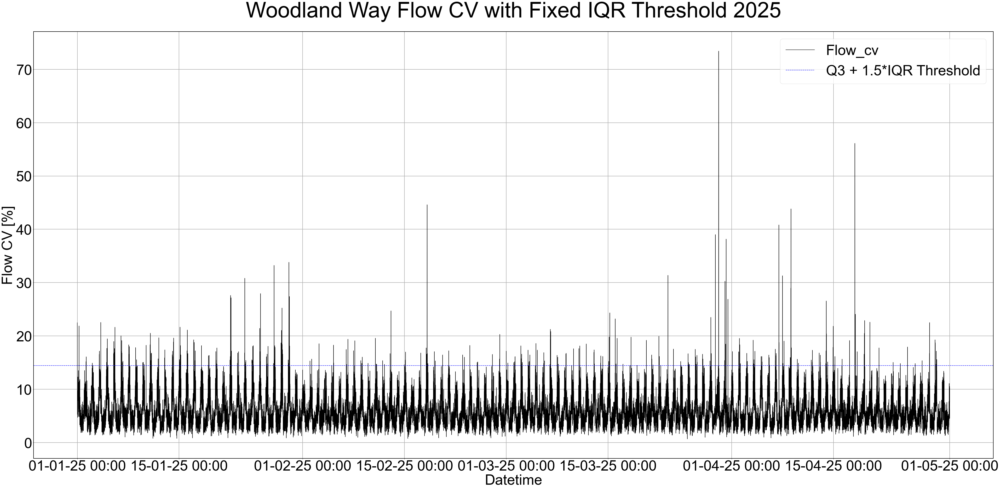

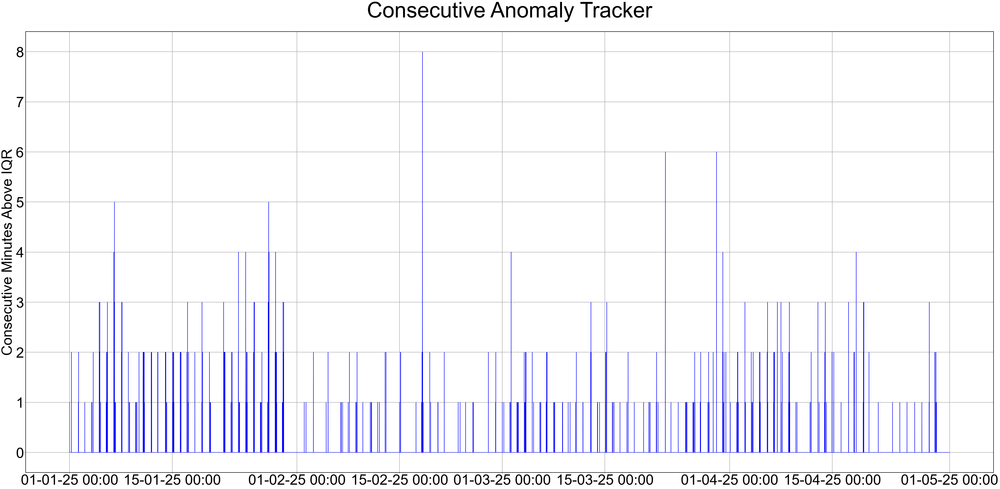

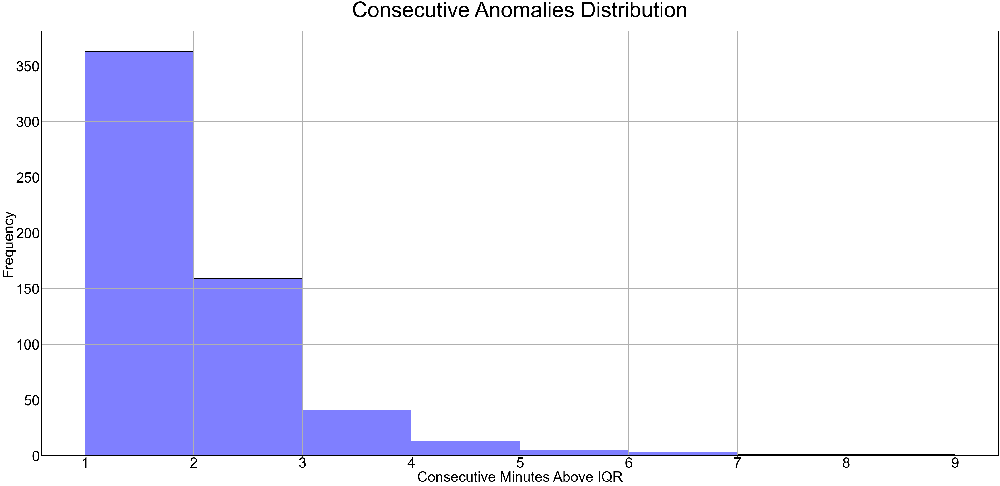

            max_iq
date              
2024-01-01       1
2024-01-02       2
2024-01-03       2
2024-01-04       3
2024-01-05       2
...            ...
2025-04-26       1
2025-04-27       1
2025-04-28       3
2025-04-29       2
2025-04-30       0

[486 rows x 1 columns]


In [25]:
value_col = Flow_cv_str
calib    = Flow_cv_rolling.loc['2024':'2025', value_col]
q1       = calib.quantile(0.25)
q3       = calib.quantile(0.75)
iqr      = q3 - q1
upper_iq = q3 + 1.5 * iqr

sim_df    = Flow_cv_rolling.loc['2024':'2025', [value_col]].copy()
sim_start = sim_df.index.min().strftime('%Y-%m-%d')
sim_end   = sim_df.index.max().strftime('%Y-%m-%d')
results      = []
flagged_days = []

for day in pd.date_range(sim_start, sim_end, freq='D'):
    day_str = day.strftime('%Y-%m-%d')
    today = (
        sim_df.loc[day_str]
              .rename_axis('timestamp')
              .reset_index()
              .set_index('timestamp')
    )

    today['cv_upper_iq'] = upper_iq
    exiq = today[value_col] > upper_iq
    grpiq = (exiq != exiq.shift()).cumsum()
    today['cv_count_iq'] = exiq.groupby(grpiq).cumcount().add(1).where(exiq, 0)
    today['cv_absdiff_iq'] = np.where(
        exiq,
        (today[value_col] - upper_iq).abs(),
        np.nan
    )
    max_iq = int(today['cv_count_iq'].max())
    results.append({'date': day_str, 'max_iq': max_iq})
    flagged_days.append(today)

summary_df  = pd.DataFrame(results).set_index('date')
Flow_cv_flagged_all = pd.concat(flagged_days)



# Time series with IQR fence
start, end = '2025', '2025'

data = Flow_cv_flagged_all.loc[start:end]
fig, ax = plt.subplots()
ax.plot(data.index, data[value_col], 'k-', label=value_col)
ax.axhline(upper_iq, color='b', linestyle='--', label='Q3 + 1.5*IQR Threshold')
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
#fig.autofmt_xdate(rotation=45)
ax.set_xlabel('Datetime')
ax.set_ylabel('Flow CV [%]')
ax.set_title(f'Woodland Way Flow CV with Fixed IQR Threshold {start}')
ax.legend(); ax.grid(True)
plt.tight_layout(); plt.show()

# Consecutive anomalies
fig, ax = plt.subplots()
ax.plot(data.index, data['cv_count_iq'], 'b-')
ax.set_ylabel('Consecutive Minutes Above IQR')
ax.set_title('Consecutive Anomaly Tracker')
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
ax.grid(True)
plt.tight_layout(); plt.show()

# Distribution of anomaly lengths
hiq  = data['cv_count_iq'][data['cv_count_iq'] > 0]
maxb = hiq.max() if not hiq.empty else 0
fig, ax = plt.subplots()
sns.histplot(hiq, bins=range(1, maxb+2), color='blue', alpha=0.5, ax=ax)
ax.set_title(f'Consecutive Anomalies Distribution')
ax.set_xlabel('Consecutive Minutes Above IQR')
ax.set_ylabel('Frequency')
ax.grid(True)
plt.tight_layout(); plt.show()

print(summary_df)

In [67]:
# # Time series with IQR fence
# start, end = '2025-01-13', '2025-01-13'
# data = Flow_cv_flagged_all.loc[start:end]

# fig, ax = plt.subplots()
# ax.plot(data.index, data[value_col], 'k-', label=value_col)
# ax.axhline(upper_iq, color='b', linestyle='--', label='Q3 + 3*IQR Threshold')
# ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
# ax.set_xlabel('Datetime')
# ax.set_ylabel('Flow CV [%]')
# ax.set_title(f'Woodland Way Flow CV with Fixed IQR Threshold {start}')
# ax.legend()
# ax.grid(True)
# plt.tight_layout()
# plt.show()

# # Consecutive anomaly
# fig, ax = plt.subplots()
# ax.plot(data.index, data['cv_count_iq'], 'b-')
# ax.set_ylabel('Consecutive Minutes Above IQR')
# ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
# ax.set_title('Consecutive Anomaly Tracker')
# ax.grid(True)
# plt.tight_layout()
# plt.show()

# # Distribution + Control Profile subplot
# hiq  = data['cv_count_iq'][data['cv_count_iq'] > 0]
# maxb = hiq.max() if not hiq.empty else 0
# flow_day = Flow['flow'].loc[start:end]
# pout_day = Pout['pressure_out'].loc[start:end]
# diff_day = flow_day.diff()
# valid   = diff_day.notna()
# flow_plot, pout_plot = flow_day[valid], pout_day[valid]
# diff_plot = diff_day[valid]
# colors    = ['red' if d > 0 else 'blue' for d in diff_plot]
# floored        = flow_plot.index.floor('5T')
# counts_on_flow = Flow_cv_flagged_all['cv_count_iq'].reindex(floored, fill_value=0)
# anomaly_mask   = counts_on_flow.values > 0
# days_with_anomalies = (
#     Flow_cv_flagged_all.loc[start:end]
#     .query('cv_count_iq > 1')
#     .index
#     .normalize()
#     .unique()
# )

# fig, (ax_hist, ax_ctrl) = plt.subplots(ncols=2)
# sns.histplot(hiq, bins=range(1, maxb+2), ax=ax_hist, color='blue', alpha=0.5)
# ax_hist.set_title('Consecutive Anomalies Distribution')
# ax_hist.set_xlabel('Consecutive Minutes Above IQR')
# ax_hist.set_ylabel('Frequency')
# ax_hist.grid(True)

# sc_norm = ax_ctrl.scatter(
#     flow_plot[~anomaly_mask],
#     pout_plot[~anomaly_mask],
#     c=[c for c, m in zip(colors, anomaly_mask) if not m],
#     edgecolor=[c for c, m in zip(colors, anomaly_mask) if not m],
#     s=100, alpha=0.3, label='Normal'
# )
# sc_anom = ax_ctrl.scatter(
#     flow_plot[anomaly_mask],
#     pout_plot[anomaly_mask],
#     c=[c for c, m in zip(colors, anomaly_mask) if m],
#     marker='D', edgecolor='k', s=150, label='Anomaly'
# )

# ln_curve = None
# for day in days_with_anomalies:
#     CPdf = get_control_curve(pd.Timestamp(day))
#     ln_curve, = ax_ctrl.plot(
#         CPdf['abb'], CPdf['P_target'],
#         linewidth=3, color='black', label='P_target'
#     )

# red_patch  = Patch(color='red',  label='Flow increasing')
# blue_patch = Patch(color='blue', label='Flow decreasing')
# handles = [sc_norm, sc_anom, ln_curve, red_patch, blue_patch]
# labels  = ['Normal', 'Anomaly', 'P_target', 'Flow increasing', 'Flow decreasing']
# ax_ctrl.legend(handles=handles, labels=labels,
#                loc='lower right', ncol=2, title='Legend')
# ax_ctrl.set(
#     title=f"Woodland Way Control Profile {start}",
#     xlabel='Flow [L/s]',
#     ylabel=r'Pressure [$mH_2O$]'
# )
# ax_ctrl.grid(True)

# plt.tight_layout()
# plt.show()

# print(summary_df)

In [27]:
# start, end = '2024-02-14','2024-02-14'
# data = Flow_cv_flagged_all.loc[start:end]

# fig, ax = plt.subplots()
# ax.plot(data.index, data[value_col], 'k-', label=value_col)
# ax.axhline(upper_iq, color='b', linestyle='--', label='IQR')
# ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
# fig.autofmt_xdate(rotation=45)
# ax.set_xlabel('Datetime')
# ax.set_ylabel('Flow CV [%]')
# ax.set_title(f'Woodland Way Flow CV with Fixed IQR Thresholds {start} : {end}')
# ax.legend()
# ax.grid(True)
# plt.tight_layout()
# plt.show()


### 4.2. Outlet Pressure w/ IQR Thresholds

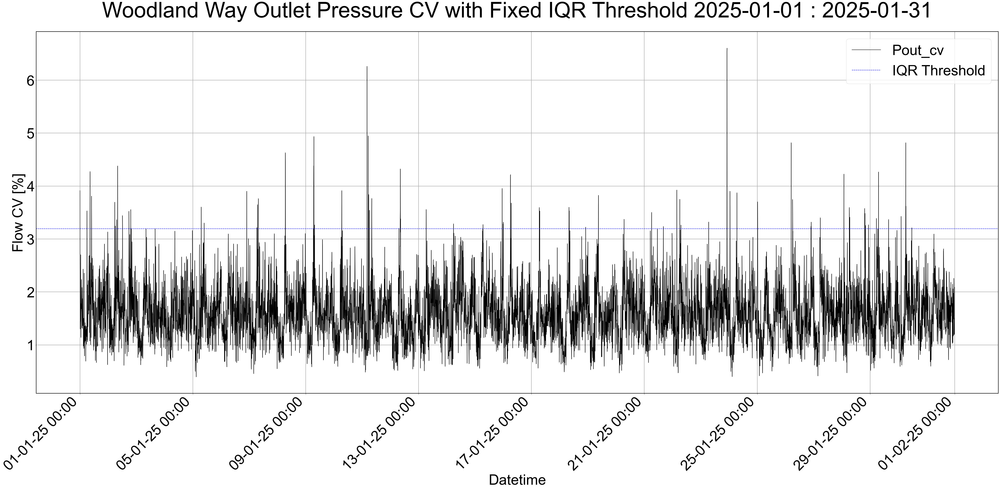

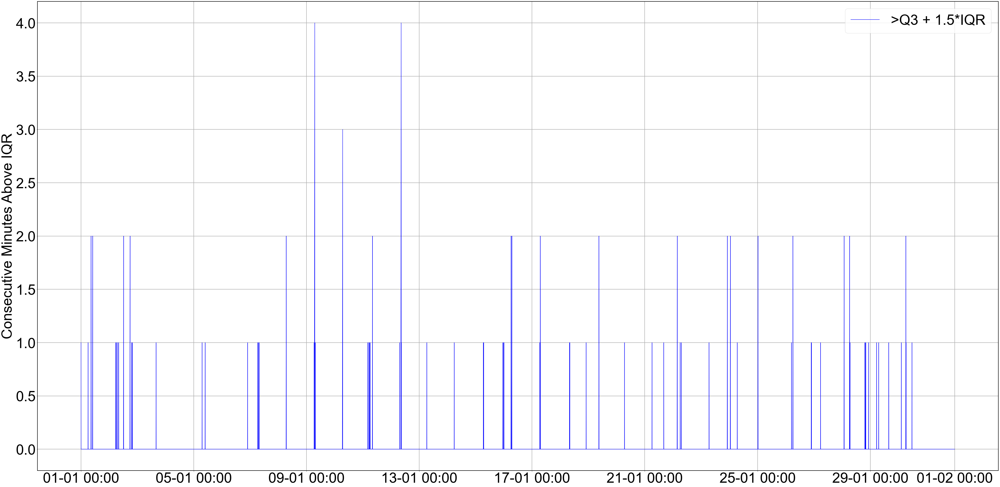

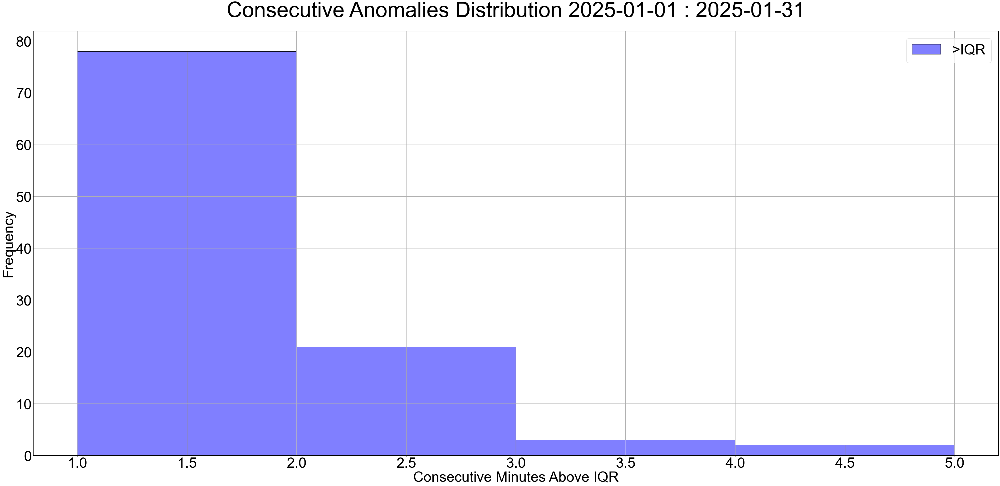

            max_iq
date              
2024-01-01       2
2024-01-02       2
2024-01-03       2
2024-01-04       2
2024-01-05       2
...            ...
2025-04-26       5
2025-04-27       4
2025-04-28       6
2025-04-29      15
2025-04-30       2

[486 rows x 1 columns]


In [28]:
value_col = Pout_cv_str
calib     = Pout_cv_rolling.loc['2024':'2025', value_col]
q1       = calib.quantile(0.25)
q3       = calib.quantile(0.75)
iqr      = q3 - q1
upper_iq = q3 + 1.5 * iqr
sim_df    = Pout_cv_rolling.loc['2024':'2025', [value_col]].copy()
sim_start = sim_df.index.min().strftime('%Y-%m-%d')
sim_end   = sim_df.index.max().strftime('%Y-%m-%d')
results      = []
flagged_days = []

for day in pd.date_range(sim_start, sim_end, freq='D'):
    day_str = day.strftime('%Y-%m-%d')
    today = (
        sim_df.loc[day_str]
              .rename_axis('timestamp')
              .reset_index()
              .set_index('timestamp')
    )
    today['cv_upper_iq'] = upper_iq
    exiq = today[value_col] > upper_iq
    grpiq = (exiq != exiq.shift()).cumsum()
    today['cv_count_iq'] = exiq.groupby(grpiq).cumcount().add(1).where(exiq, 0)
    today['cv_absdiff_iq'] = np.where(
        exiq,
        (today[value_col] - upper_iq).abs(),
        np.nan
    )
    max_iq = int(today['cv_count_iq'].max())
    results.append({'date': day_str, 'max_iq': max_iq})
    flagged_days.append(today)

summary_df  = pd.DataFrame(results).set_index('date')
Pout_cv_flagged_all = pd.concat(flagged_days)

# Time series with IQR fence
start, end = '2025-01-01', '2025-01-31'
data = Pout_cv_flagged_all.loc[start:end]
fig, ax = plt.subplots()
ax.plot(data.index, data[value_col], 'k-', label=value_col)
ax.axhline(upper_iq, color='b', linestyle='--', label='IQR Threshold')
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
fig.autofmt_xdate(rotation=45)
ax.set_xlabel('Datetime')
ax.set_ylabel('Flow CV [%]')
ax.set_title(f'Woodland Way Outlet Pressure CV with Fixed IQR Threshold {start} : {end}')
ax.legend(); ax.grid(True)
plt.tight_layout(); plt.show()

# Consecutive anomalies
fig, ax = plt.subplots()
ax.plot(data.index, data['cv_count_iq'], 'b-', label='>Q3 + 1.5*IQR')
ax.set_ylabel('Consecutive Minutes Above IQR')
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m %H:%M'))
ax.legend(); ax.grid(True)
plt.tight_layout(); plt.show()

# Distribution of streak lengths
hiq  = data['cv_count_iq'][data['cv_count_iq'] > 0]
maxb = hiq.max() if not hiq.empty else 0
fig, ax = plt.subplots()
sns.histplot(hiq, bins=range(1, maxb+2), color='blue', alpha=0.5, label='>IQR', ax=ax)
ax.set_title(f'Consecutive Anomalies Distribution {start} : {end}')
ax.set_xlabel('Consecutive Minutes Above IQR')
ax.set_ylabel('Frequency')
ax.legend(); ax.grid(True)
plt.tight_layout(); plt.show()

print(summary_df)

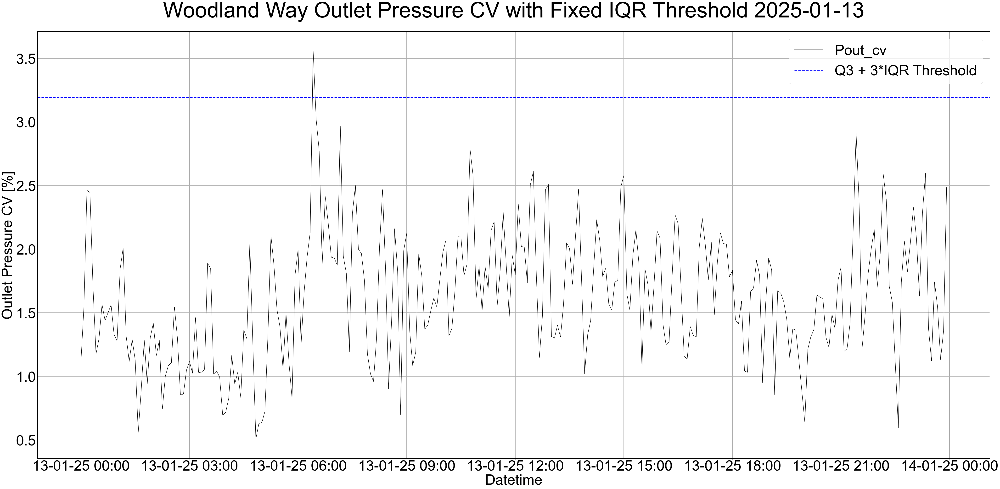

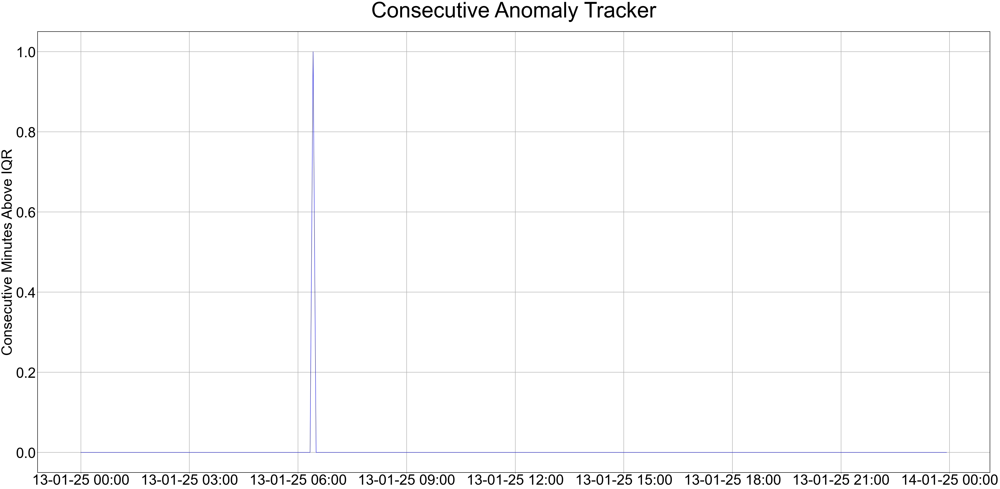

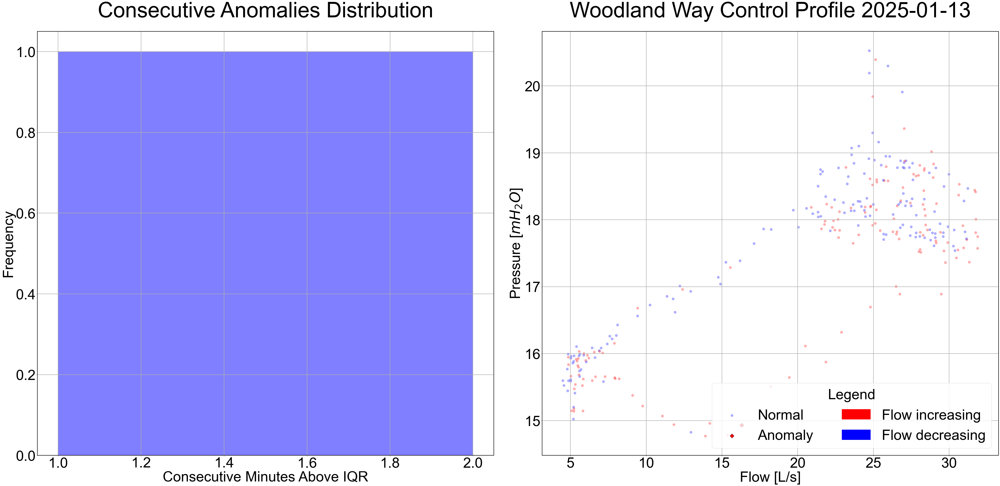

            max_iq
date              
2024-01-01       2
2024-01-02       2
2024-01-03       2
2024-01-04       2
2024-01-05       2
...            ...
2025-04-26       5
2025-04-27       4
2025-04-28       6
2025-04-29      15
2025-04-30       2

[486 rows x 1 columns]


In [29]:
# Time series with IQR fence
start, end = '2025-01-13', '2025-01-13'
data = Pout_cv_flagged_all.loc[start:end]

fig, ax = plt.subplots()
ax.plot(data.index, data[value_col], 'k-', label=value_col)
ax.axhline(upper_iq, color='b', linestyle='--', label='Q3 + 3*IQR Threshold', linewidth = 3)
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
ax.set_xlabel('Datetime')
ax.set_ylabel('Outlet Pressure CV [%]')
ax.set_title(f'Woodland Way Outlet Pressure CV with Fixed IQR Threshold {start}')
ax.legend()
ax.grid(True)
plt.tight_layout()
plt.show()

# Consecutive anomalies
fig, ax = plt.subplots()
ax.plot(data.index, data['cv_count_iq'], 'b-')
ax.set_ylabel('Consecutive Minutes Above IQR')
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
ax.set_title('Consecutive Anomaly Tracker')
ax.grid(True)
plt.tight_layout()
plt.show()

# Anomaly Distribution + Control Profile subplot
hiq  = data['cv_count_iq'][data['cv_count_iq'] > 0]
maxb = hiq.max() if not hiq.empty else 0
flow_day = Flow['flow'].loc[start:end]
pout_day = Pout['pressure_out'].loc[start:end]
diff_day = flow_day.diff()
valid   = diff_day.notna()
flow_plot, pout_plot = flow_day[valid], pout_day[valid]
diff_plot = diff_day[valid]
colors    = ['red' if d > 0 else 'blue' for d in diff_plot]
floored        = flow_plot.index.floor('5T')
counts_on_flow = data['cv_count_iq'].reindex(floored, fill_value=0)
anomaly_mask   = counts_on_flow.values > 0
days_with_anomalies = (
    data.loc[start:end]
    .query('cv_count_iq > 1')
    .index
    .normalize()
    .unique()
)

fig, (ax_hist, ax_ctrl) = plt.subplots(ncols=2)
sns.histplot(hiq, bins=range(1, maxb+2), ax=ax_hist, color='blue', alpha=0.5)
ax_hist.set_title('Consecutive Anomalies Distribution')
ax_hist.set_xlabel('Consecutive Minutes Above IQR')
ax_hist.set_ylabel('Frequency')
ax_hist.grid(True)
sc_norm = ax_ctrl.scatter(
    flow_plot[~anomaly_mask],
    pout_plot[~anomaly_mask],
    c=[c for c, m in zip(colors, anomaly_mask) if not m],
    edgecolor=[c for c, m in zip(colors, anomaly_mask) if not m],
    s=100, alpha=0.3, label='Normal'
)
sc_anom = ax_ctrl.scatter(
    flow_plot[anomaly_mask],
    pout_plot[anomaly_mask],
    c=[c for c, m in zip(colors, anomaly_mask) if m],
    marker='D', edgecolor='k', s=150, label='Anomaly'
)

ln_curve = None
for day in days_with_anomalies:
    CPdf = get_control_curve(pd.Timestamp(day))
    ln_curve, = ax_ctrl.plot(
        CPdf['abb'], CPdf['P_target'],
        linewidth=3, color='black', label='P_target'
    )

red_patch  = Patch(color='red',  label='Flow increasing')
blue_patch = Patch(color='blue', label='Flow decreasing')
handles = [sc_norm, sc_anom, ln_curve, red_patch, blue_patch]
labels  = ['Normal', 'Anomaly', 'P_target', 'Flow increasing', 'Flow decreasing']
ax_ctrl.legend(handles=handles, labels=labels,
               loc='lower right', ncol=2, title='Legend')
ax_ctrl.set(
    title=f"Woodland Way Control Profile {start}",
    xlabel='Flow [L/s]',
    ylabel=r'Pressure [$mH_2O$]'
)
ax_ctrl.grid(True)

plt.tight_layout()
plt.show()

print(summary_df)

### 4.3. Inlet Pressure w/ IQR Thresholds

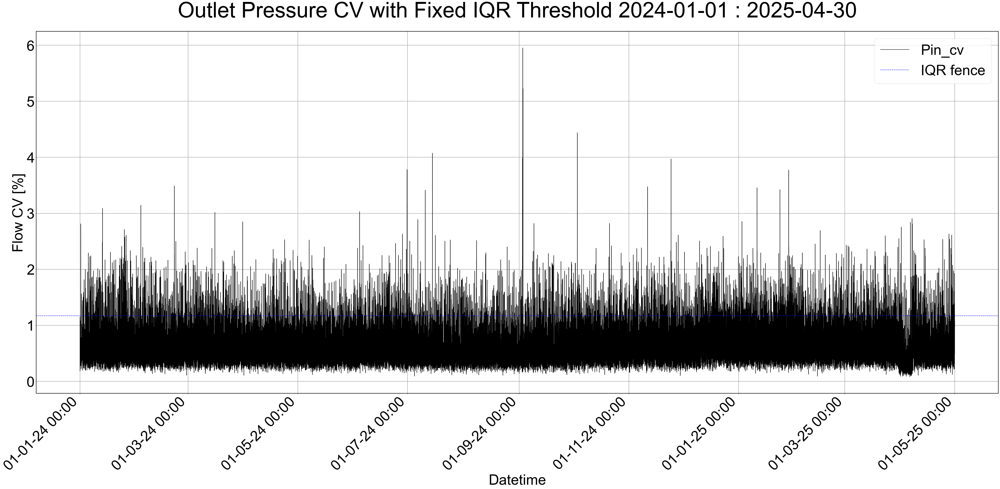

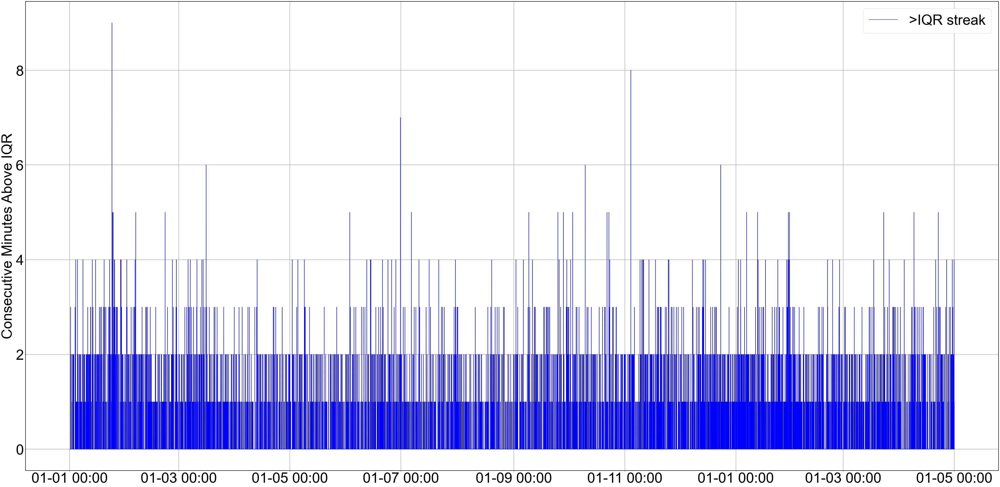

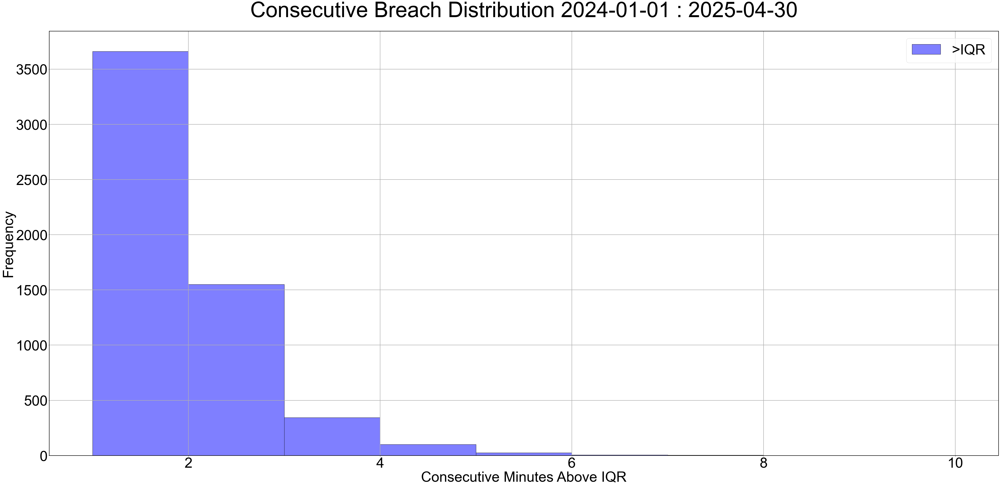

            max_iq
date              
2024-01-01       3
2024-01-02       2
2024-01-03       3
2024-01-04       4
2024-01-05       4
...            ...
2025-04-26       4
2025-04-27       2
2025-04-28       3
2025-04-29       4
2025-04-30       4

[486 rows x 1 columns]


In [30]:
value_col = Pin_cv_str
calib     = Pin_cv_rolling.loc['2024':'2025', value_col]
q1       = calib.quantile(0.25)
q3       = calib.quantile(0.75)
iqr      = q3 - q1
upper_iq = q3 + 1.5 * iqr
sim_df    = Pin_cv_rolling.loc['2024':'2025', [value_col]].copy()
sim_start = sim_df.index.min().strftime('%Y-%m-%d')
sim_end   = sim_df.index.max().strftime('%Y-%m-%d')
results      = []
flagged_days = []

for day in pd.date_range(sim_start, sim_end, freq='D'):
    day_str = day.strftime('%Y-%m-%d')
    today = (
        sim_df.loc[day_str]
              .rename_axis('timestamp')
              .reset_index()
              .set_index('timestamp')
    )

    today['cv_upper_iq'] = upper_iq
    exiq = today[value_col] > upper_iq
    grpiq = (exiq != exiq.shift()).cumsum()
    today['cv_count_iq'] = exiq.groupby(grpiq).cumcount().add(1).where(exiq, 0)
    today['cv_absdiff_iq'] = np.where(
        exiq,
        (today[value_col] - upper_iq).abs(),
        np.nan
    )
    max_iq = int(today['cv_count_iq'].max())
    results.append({'date': day_str, 'max_iq': max_iq})
    flagged_days.append(today)

summary_df  = pd.DataFrame(results).set_index('date')
Pin_cv_flagged_all = pd.concat(flagged_days)

# Time series with IQR fence
start, end = sim_start, sim_end
data = Pin_cv_flagged_all.loc[start:end]
fig, ax = plt.subplots()
ax.plot(data.index, data[value_col], 'k-', label=value_col)
ax.axhline(upper_iq, color='b', linestyle='--', label='IQR fence')
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
fig.autofmt_xdate(rotation=45)
ax.set_xlabel('Datetime')
ax.set_ylabel('Flow CV [%]')
ax.set_title(f'Outlet Pressure CV with Fixed IQR Threshold {start} : {end}')
ax.legend(); ax.grid(True)
plt.tight_layout(); plt.show()

# Consecutive anomalies
fig, ax = plt.subplots()
ax.plot(data.index, data['cv_count_iq'], 'b-', label='>IQR streak')
ax.set_ylabel('Consecutive Minutes Above IQR')
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m %H:%M'))
ax.legend(); ax.grid(True)
plt.tight_layout(); plt.show()

# Distribution of anomaly lengths
hiq  = data['cv_count_iq'][data['cv_count_iq'] > 0]
maxb = hiq.max() if not hiq.empty else 0
fig, ax = plt.subplots()
sns.histplot(hiq, bins=range(1, maxb+2), color='blue', alpha=0.5, label='>IQR', ax=ax)
ax.set_title(f'Consecutive Breach Distribution {start} : {end}')
ax.set_xlabel('Consecutive Minutes Above IQR')
ax.set_ylabel('Frequency')
ax.legend(); ax.grid(True)
plt.tight_layout(); plt.show()

print(summary_df)

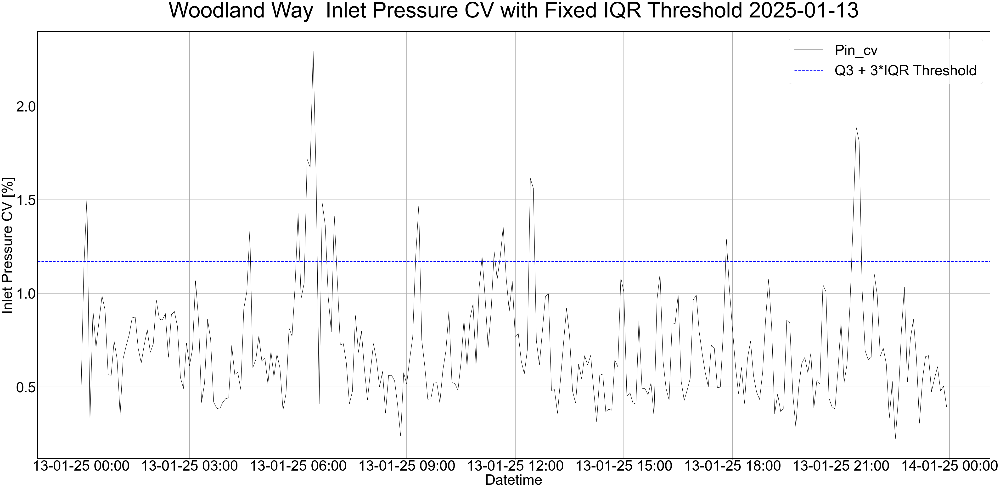

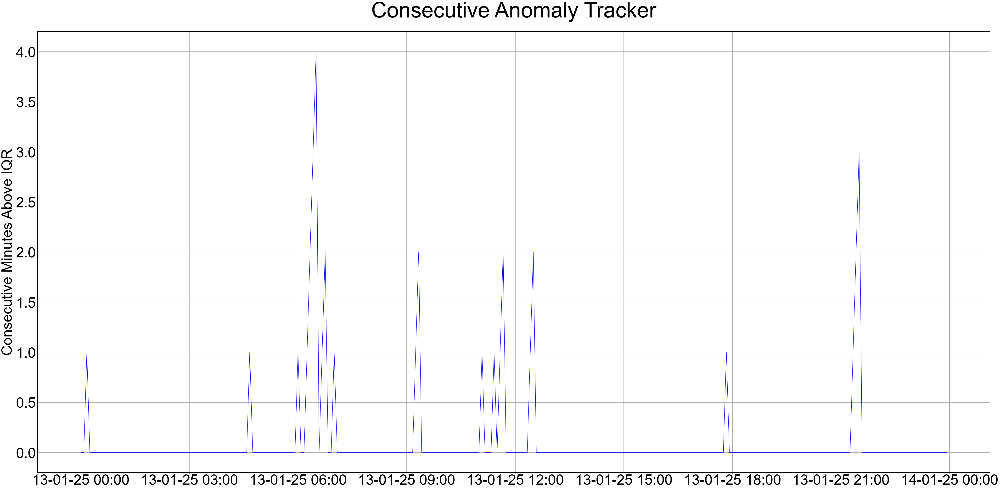

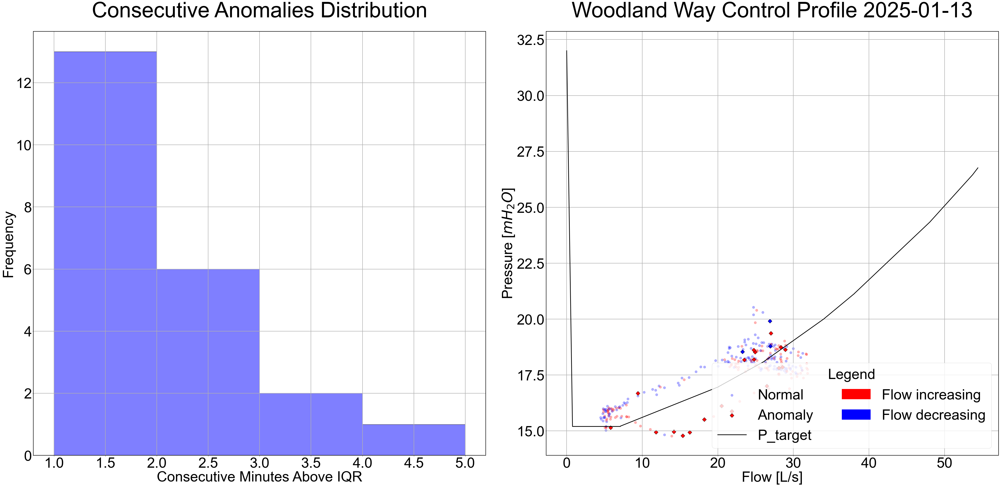

            max_iq
date              
2024-01-01       3
2024-01-02       2
2024-01-03       3
2024-01-04       4
2024-01-05       4
...            ...
2025-04-26       4
2025-04-27       2
2025-04-28       3
2025-04-29       4
2025-04-30       4

[486 rows x 1 columns]


In [31]:
# Time series with IQR fence
start, end = '2025-01-13', '2025-01-13'
data = Pin_cv_flagged_all.loc[start:end]

fig, ax = plt.subplots()
ax.plot(data.index, data[value_col], 'k-', label=value_col)
ax.axhline(upper_iq, color='b', linestyle='--', label='Q3 + 3*IQR Threshold', linewidth = 3)
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
ax.set_xlabel('Datetime')
ax.set_ylabel('Inlet Pressure CV [%]')
ax.set_title(f'Woodland Way  Inlet Pressure CV with Fixed IQR Threshold {start}')
ax.legend()
ax.grid(True)
plt.tight_layout()
plt.show()

# Consecutive anomalies
fig, ax = plt.subplots()
ax.plot(data.index, data['cv_count_iq'], 'b-')
ax.set_ylabel('Consecutive Minutes Above IQR')
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
ax.set_title('Consecutive Anomaly Tracker')
ax.grid(True)
plt.tight_layout()
plt.show()

# Anomaly Distribution + Control Profile subplot
hiq  = data['cv_count_iq'][data['cv_count_iq'] > 0]
maxb = hiq.max() if not hiq.empty else 0
flow_day = Flow['flow'].loc[start:end]
pout_day = Pout['pressure_out'].loc[start:end]
diff_day = flow_day.diff()
valid   = diff_day.notna()
flow_plot, pout_plot = flow_day[valid], pout_day[valid]
diff_plot = diff_day[valid]
colors    = ['red' if d > 0 else 'blue' for d in diff_plot]
floored        = flow_plot.index.floor('5T')
counts_on_flow = data['cv_count_iq'].reindex(floored, fill_value=0)
anomaly_mask   = counts_on_flow.values > 0
days_with_anomalies = (
    data.loc[start:end]
    .query('cv_count_iq > 1')
    .index
    .normalize()
    .unique()
)

fig, (ax_hist, ax_ctrl) = plt.subplots(ncols=2)
sns.histplot(hiq, bins=range(1, maxb+2), ax=ax_hist, color='blue', alpha=0.5)
ax_hist.set_title('Consecutive Anomalies Distribution')
ax_hist.set_xlabel('Consecutive Minutes Above IQR')
ax_hist.set_ylabel('Frequency')
ax_hist.grid(True)
sc_norm = ax_ctrl.scatter(
    flow_plot[~anomaly_mask],
    pout_plot[~anomaly_mask],
    c=[c for c, m in zip(colors, anomaly_mask) if not m],
    edgecolor=[c for c, m in zip(colors, anomaly_mask) if not m],
    s=100, alpha=0.3, label='Normal'
)
sc_anom = ax_ctrl.scatter(
    flow_plot[anomaly_mask],
    pout_plot[anomaly_mask],
    c=[c for c, m in zip(colors, anomaly_mask) if m],
    marker='D', edgecolor='k', s=150, label='Anomaly'
)

ln_curve = None
for day in days_with_anomalies:
    CPdf = get_control_curve(pd.Timestamp(day))
    ln_curve, = ax_ctrl.plot(
        CPdf['abb'], CPdf['P_target'],
        linewidth=3, color='black', label='P_target'
    )

red_patch  = Patch(color='red',  label='Flow increasing')
blue_patch = Patch(color='blue', label='Flow decreasing')
handles = [sc_norm, sc_anom, ln_curve, red_patch, blue_patch]
labels  = ['Normal', 'Anomaly', 'P_target', 'Flow increasing', 'Flow decreasing']
ax_ctrl.legend(handles=handles, labels=labels,
               loc='lower right', ncol=2, title='Legend')
ax_ctrl.set(
    title=f"Woodland Way Control Profile {start}",
    xlabel='Flow [L/s]',
    ylabel=r'Pressure [$mH_2O$]'
)
ax_ctrl.grid(True)

plt.tight_layout()
plt.show()

print(summary_df)

### 4.4. Flow Thresholds w/ Skewed Normal Thresholds

Best fit by AIC: gamma (AIC_sn=702445.6, AIC_g=699071.2)
K–S p-values: skewnorm=0.000, gamma=0.000
Using 'gamma' → 99.7th percentile = 19.745


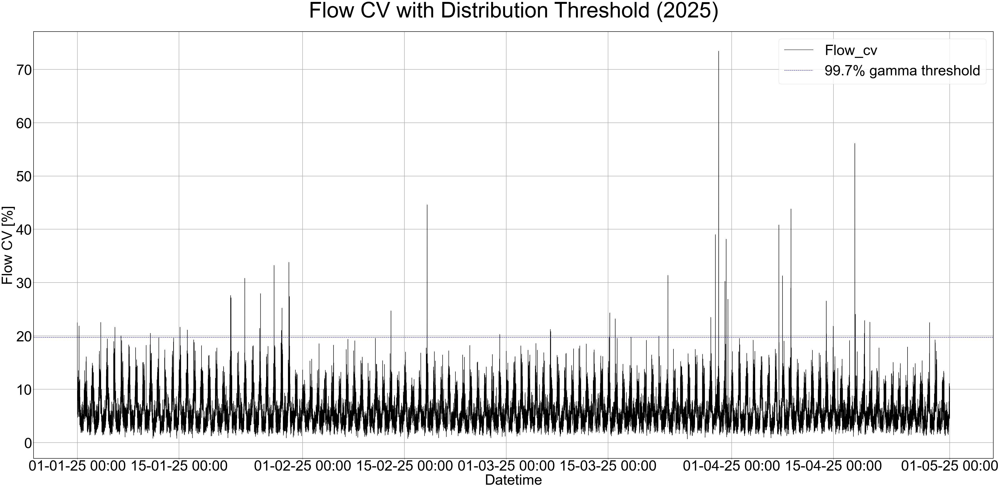

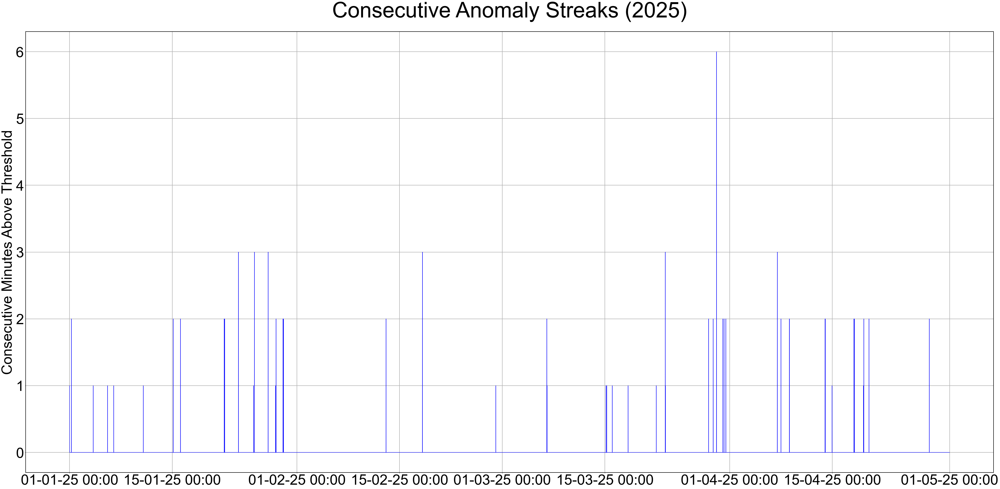

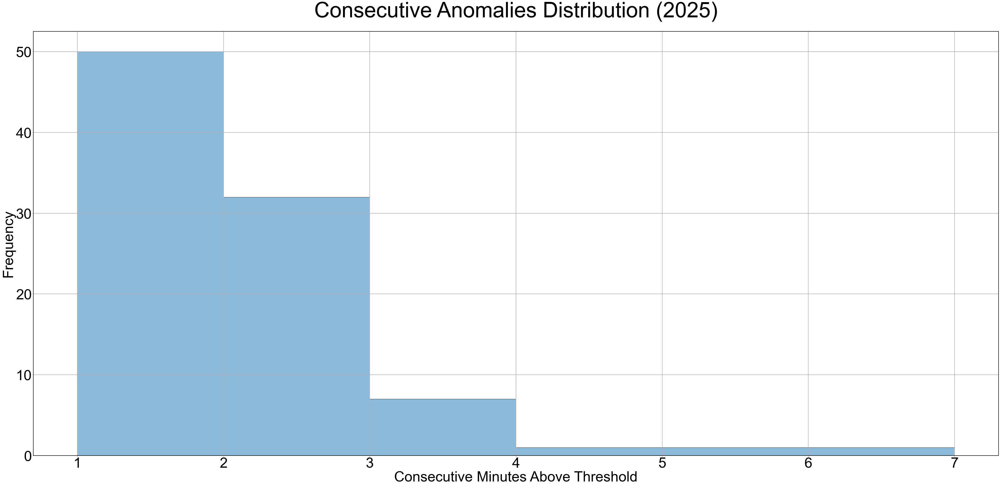

            max_dist
date                
2024-01-01         0
2024-01-02         0
2024-01-03         1
2024-01-04         2
2024-01-05         0
...              ...
2025-04-26         0
2025-04-27         0
2025-04-28         2
2025-04-29         0
2025-04-30         0

[486 rows x 1 columns]


In [32]:
value_col = Flow_cv_str

x = Flow_cv_rolling.loc['2024':'2025', value_col].dropna().values

a_sn, loc_sn, scale_sn = stats.skewnorm.fit(x)
shape_g, loc_g, scale_g = stats.gamma.fit(x)
def aic(loglik, k, n):
    return 2 * k - 2 * loglik + 2 * k * (k + 1) / (n - k - 1)

n        = len(x)
ll_sn    = np.sum(stats.skewnorm.logpdf(x, a_sn, loc_sn, scale_sn))
ll_g     = np.sum(stats.gamma.logpdf(x,  shape_g, loc_g, scale_g))
aic_sn   = aic(ll_sn, k=3, n=n)
aic_g    = aic(ll_g,  k=3, n=n)

ks_sn_p  = stats.kstest(x, "skewnorm", (a_sn, loc_sn, scale_sn)).pvalue
ks_g_p   = stats.kstest(x, "gamma",    (shape_g, loc_g, scale_g)).pvalue

best_dist = "skew-normal" if aic_sn < aic_g else "gamma"
print(f"Best fit by AIC: {best_dist} (AIC_sn={aic_sn:.1f}, AIC_g={aic_g:.1f})")
print(f"K–S p-values: skewnorm={ks_sn_p:.3f}, gamma={ks_g_p:.3f}")

P_HIGH = 0.997
if best_dist == "skew-normal":
    upper_dist = stats.skewnorm.ppf(P_HIGH, a_sn, loc_sn, scale_sn)
else:
    upper_dist = stats.gamma.ppf(   P_HIGH, shape_g, loc_g, scale_g)

print(f"Using {best_dist!r} → 99.7th percentile = {upper_dist:.3f}")

sim_df    = Flow_cv_rolling.loc['2024':'2025', [value_col]].copy()
sim_start = sim_df.index.min().strftime('%Y-%m-%d')
sim_end   = sim_df.index.max().strftime('%Y-%m-%d')
results      = []
flagged_days = []

for day in pd.date_range(sim_start, sim_end, freq='D'):
    day_str = day.strftime('%Y-%m-%d')
    today = (
        sim_df.loc[day_str]
              .rename_axis('timestamp')
              .reset_index()
              .set_index('timestamp')
    )

    today['cv_upper_dist'] = upper_dist
    ex = today[value_col] > upper_dist
    grp = (ex != ex.shift()).cumsum()
    today['cv_count_dist'] = ex.groupby(grp).cumcount().add(1).where(ex, 0)
    today['cv_absdiff_dist'] = np.where(
        ex,
        (today[value_col] - upper_dist).abs(),
        np.nan
    )
    max_dist = int(today['cv_count_dist'].max())
    results.append({'date': day_str, 'max_dist': max_dist})
    flagged_days.append(today)

summary_df          = pd.DataFrame(results).set_index('date')
Flow_cv_flagged_all_SN = pd.concat(flagged_days)

data = Flow_cv_flagged_all_SN.loc['2025':'2025']

# Time series with dist‐based limits
plt.figure()
plt.plot(data.index, data[value_col], 'k-', label=value_col)
plt.axhline(upper_dist, color='b', linestyle='--',
            label=f'99.7% {best_dist} threshold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
plt.xlabel('Datetime')
plt.ylabel('Flow CV [%]')
plt.title('Flow CV with Distribution Threshold (2025)')
plt.legend(); plt.grid(True)
plt.tight_layout(); plt.show()

# Consecutive anomalies
plt.figure()
plt.plot(data.index, data['cv_count_dist'], 'b-')
plt.ylabel('Consecutive Minutes Above Threshold')
plt.title('Consecutive Anomaly Streaks (2025)')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
plt.grid(True)
plt.tight_layout(); plt.show()

# Distribution of anomaly lengths
hi = data['cv_count_dist'][data['cv_count_dist'] > 0]
maxb = hi.max() if not hi.empty else 0

plt.figure()
sns.histplot(hi, bins=range(1, maxb+2), alpha=0.5)
plt.title('Consecutive Anomalies Distribution (2025)')
plt.xlabel('Consecutive Minutes Above Threshold')
plt.ylabel('Frequency')
plt.grid(True)
plt.tight_layout(); plt.show()


print(summary_df)

The code below plots comparisons of the IQR thresholds and the fitted distributions. The start and end dates can be adjusted to view different periods.

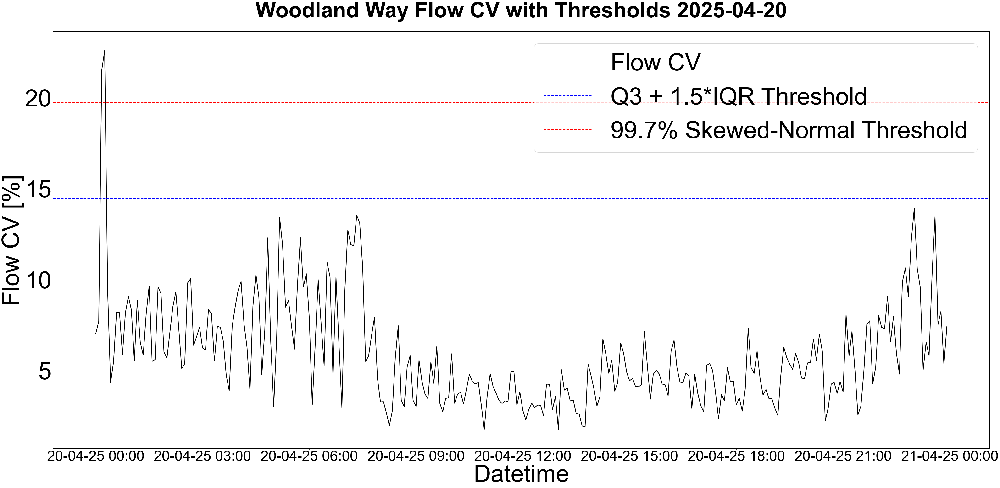

In [33]:
start, end = '2025-04-20', '2025-04-20'
data = Flow_cv_flagged_all_SN.loc[start:end]
IQRT = Flow_cv_flagged_all['cv_upper_iq'][0]
SNT = Flow_cv_flagged_all_SN['cv_upper_dist'][0]
value_col = Flow_cv_str

fig, ax = plt.subplots()
ax.plot(data.index, data[value_col], 'k-', label='Flow CV', linewidth = 3)
ax.axhline(IQRT, color='b', linestyle='--', label='Q3 + 1.5*IQR Threshold', linewidth = 3)
ax.axhline(SNT, color='r', linestyle='--', label='99.7% Skewed-Normal Threshold', linewidth = 3)
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
ax.set_xlabel('Datetime', fontsize = 100)
ax.set_ylabel('Flow CV [%]', fontsize = 100)
ax.set_title(f'Woodland Way Flow CV with Thresholds {start}', fontweight = 'bold')
ax.legend(loc = 'upper right', fontsize = 100)
plt.xticks(fontsize=60)
plt.yticks(fontsize=100)
plt.tight_layout()
plt.show()

### 4.5. Outlet Pressure w/ Skewed Normal Thresholds

Best fit by AIC: skew-normal (AIC_sn=284627.3, AIC_g=1260483.2)
K–S p-values: skewnorm=0.000, gamma=0.000
Using 'skew-normal' → 99.7th percentile = 4.401


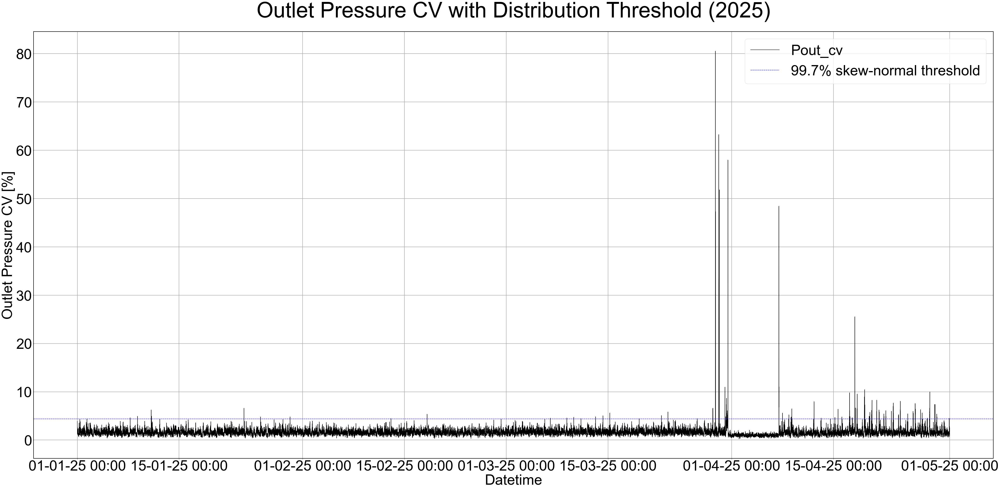

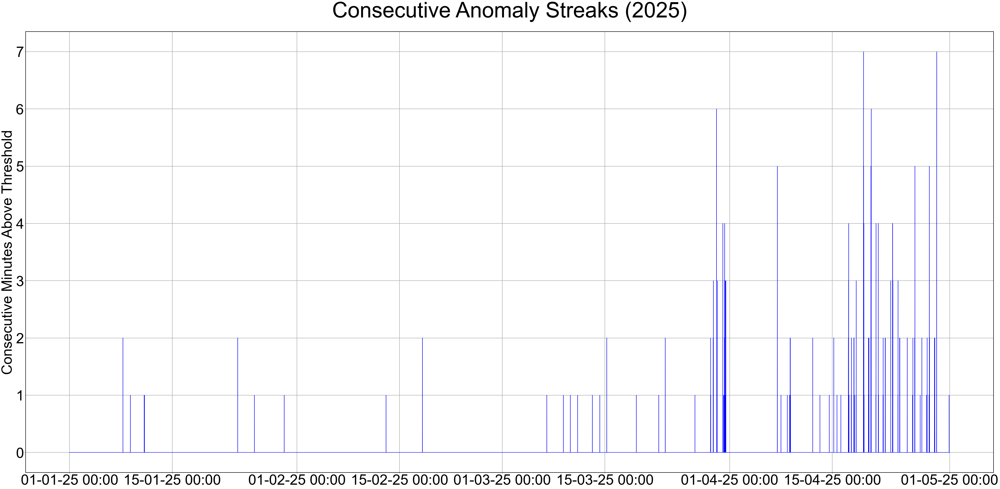

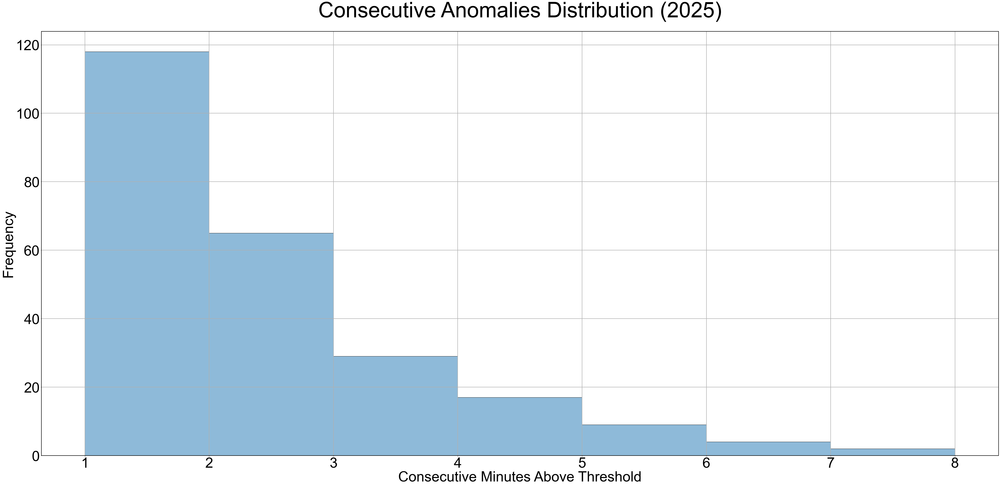

            max_dist
date                
2024-01-01         0
2024-01-02         2
2024-01-03         1
2024-01-04         2
2024-01-05         1
...              ...
2025-04-26         5
2025-04-27         2
2025-04-28         5
2025-04-29         7
2025-04-30         1

[486 rows x 1 columns]


In [34]:
value_col = Pout_cv_str

x = Pout_cv_rolling.loc['2024':'2025', value_col].dropna().values

a_sn, loc_sn, scale_sn = stats.skewnorm.fit(x)
shape_g, loc_g, scale_g = stats.gamma.fit(x)

def aic(loglik, k, n):
    return 2 * k - 2 * loglik + 2 * k * (k + 1) / (n - k - 1)

n        = len(x)
ll_sn    = np.sum(stats.skewnorm.logpdf(x, a_sn, loc_sn, scale_sn))
ll_g     = np.sum(stats.gamma.logpdf(x,  shape_g, loc_g, scale_g))
aic_sn   = aic(ll_sn, k=3, n=n)
aic_g    = aic(ll_g,  k=3, n=n)

ks_sn_p  = stats.kstest(x, "skewnorm", (a_sn, loc_sn, scale_sn)).pvalue
ks_g_p   = stats.kstest(x, "gamma",    (shape_g, loc_g, scale_g)).pvalue

best_dist = "skew-normal" if aic_sn < aic_g else "gamma"
print(f"Best fit by AIC: {best_dist} (AIC_sn={aic_sn:.1f}, AIC_g={aic_g:.1f})")
print(f"K–S p-values: skewnorm={ks_sn_p:.3f}, gamma={ks_g_p:.3f}")

P_HIGH = 0.997
if best_dist == "skew-normal":
    upper_dist = stats.skewnorm.ppf(P_HIGH, a_sn, loc_sn, scale_sn)
else:
    upper_dist = stats.gamma.ppf(   P_HIGH, shape_g, loc_g, scale_g)

print(f"Using {best_dist!r} → 99.7th percentile = {upper_dist:.3f}")

sim_df    = Pout_cv_rolling.loc['2024':'2025', [value_col]].copy()
sim_start = sim_df.index.min().strftime('%Y-%m-%d')
sim_end   = sim_df.index.max().strftime('%Y-%m-%d')
results      = []
flagged_days = []

for day in pd.date_range(sim_start, sim_end, freq='D'):
    day_str = day.strftime('%Y-%m-%d')
    today = (
        sim_df.loc[day_str]
              .rename_axis('timestamp')
              .reset_index()
              .set_index('timestamp')
    )

    today['cv_upper_dist'] = upper_dist
    ex = today[value_col] > upper_dist
    grp = (ex != ex.shift()).cumsum()
    today['cv_count_dist'] = ex.groupby(grp).cumcount().add(1).where(ex, 0)
    today['cv_absdiff_dist'] = np.where(
        ex,
        (today[value_col] - upper_dist).abs(),
        np.nan
    )
    max_dist = int(today['cv_count_dist'].max())
    results.append({'date': day_str, 'max_dist': max_dist})
    flagged_days.append(today)
summary_df          = pd.DataFrame(results).set_index('date')
Pout_cv_flagged_all_SN = pd.concat(flagged_days)

data = Pout_cv_flagged_all_SN.loc['2025':'2025']

# Time series with dist‐based limits
plt.figure()
plt.plot(data.index, data[value_col], 'k-', label=value_col)
plt.axhline(upper_dist, color='b', linestyle='--',
            label=f'99.7% {best_dist} threshold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
plt.xlabel('Datetime')
plt.ylabel('Outlet Pressure CV [%]')
plt.title('Outlet Pressure CV with Distribution Threshold (2025)')
plt.legend(); plt.grid(True)
plt.tight_layout(); plt.show()

# Consecutive anomalies
plt.figure()
plt.plot(data.index, data['cv_count_dist'], 'b-')
plt.ylabel('Consecutive Minutes Above Threshold')
plt.title('Consecutive Anomaly Streaks (2025)')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
plt.grid(True)
plt.tight_layout(); plt.show()

# Distribution of anomaly lengths
hi = data['cv_count_dist'][data['cv_count_dist'] > 0]
maxb = hi.max() if not hi.empty else 0

plt.figure()
sns.histplot(hi, bins=range(1, maxb+2), alpha=0.5)
plt.title('Consecutive Anomalies Distribution (2025)')
plt.xlabel('Consecutive Minutes Above Threshold')
plt.ylabel('Frequency')
plt.grid(True)
plt.tight_layout(); plt.show()


print(summary_df)

The code below plots comparisons of the IQR thresholds and the fitted distributions. The start and end dates can be adjusted to view different periods.

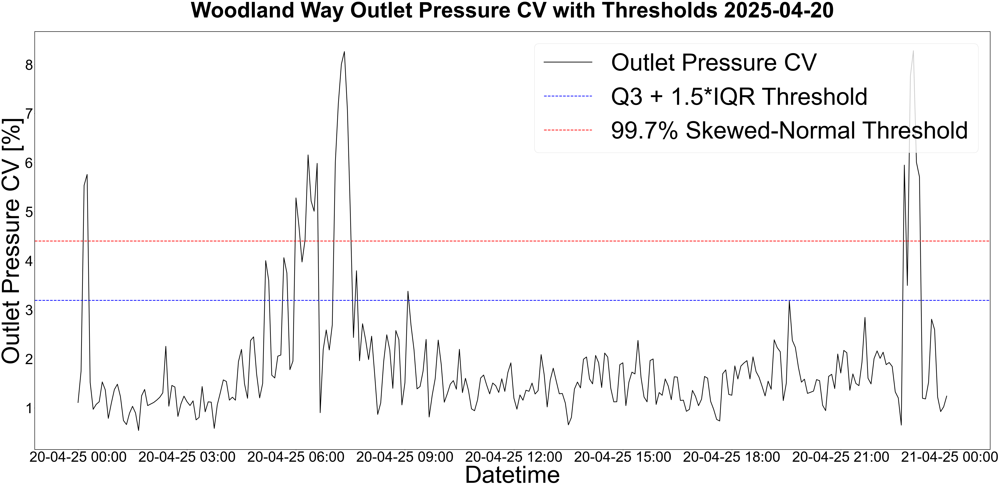

In [35]:
start, end = '2025-04-20', '2025-04-20'
data = Pout_cv_flagged_all_SN.loc[start:end]
IQRT = Pout_cv_flagged_all['cv_upper_iq'][0]
SNT = Pout_cv_flagged_all_SN['cv_upper_dist'][0]
value_col = Pout_cv_str

fig, ax = plt.subplots()
ax.plot(data.index, data[value_col], 'k-', label='Outlet Pressure CV', linewidth = 3)
ax.axhline(IQRT, color='b', linestyle='--', label='Q3 + 1.5*IQR Threshold', linewidth = 3)
ax.axhline(SNT, color='r', linestyle='--', label='99.7% Skewed-Normal Threshold', linewidth = 3)
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
ax.set_xlabel('Datetime',fontsize = 100)
ax.set_ylabel('Outlet Pressure CV [%]',fontsize = 100)
ax.set_title(f'Woodland Way Outlet Pressure CV with Thresholds {start}', fontweight = 'bold')
ax.legend(fontsize = 100)

plt.tight_layout()
plt.show()

### 4.6. Inlet Pressure w/ SN Thresholds

Best fit by AIC: gamma (AIC_sn=-8412.3, AIC_g=-11372.4)
K–S p-values: skewnorm=0.000, gamma=0.000
Using 'gamma' → 99.7th percentile = 1.558


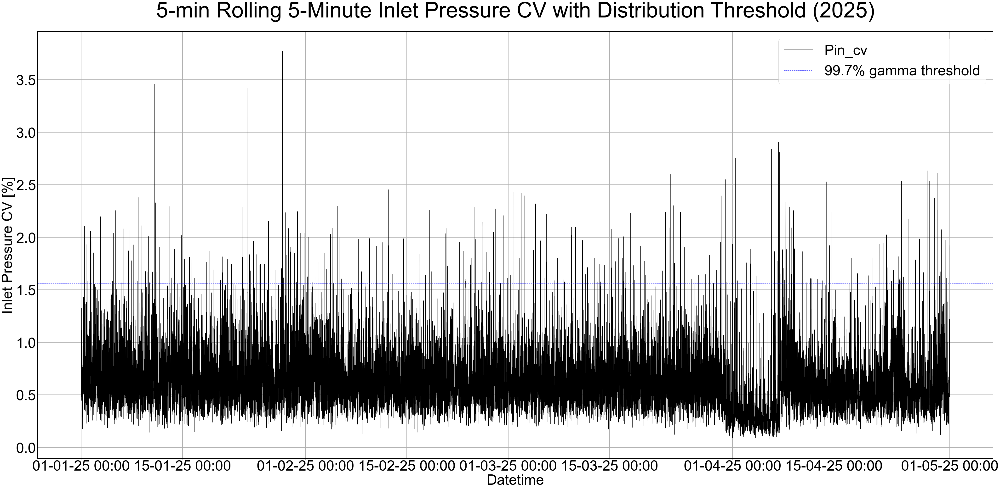

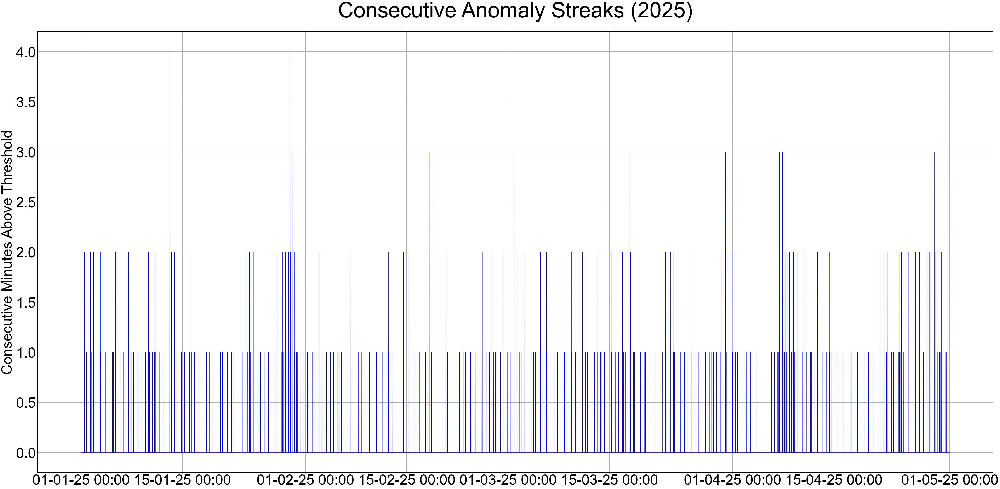

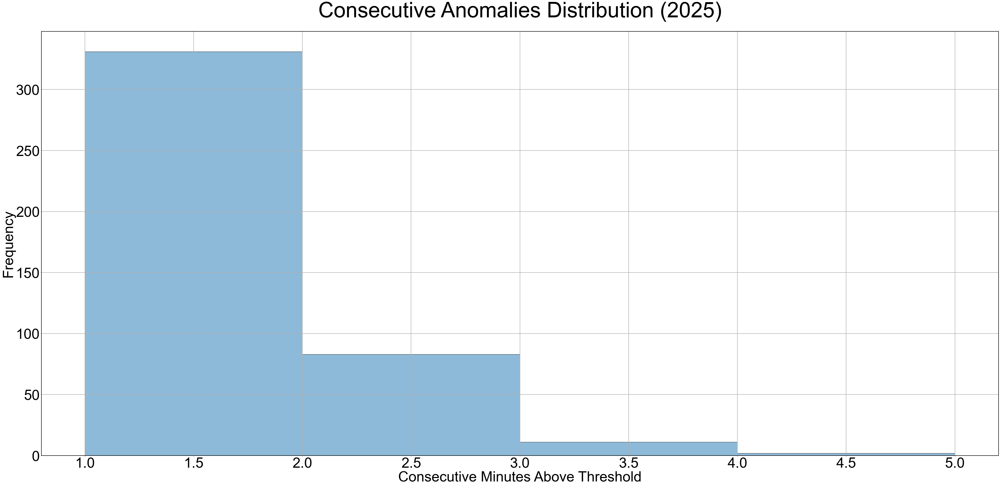

            max_dist
date                
2024-01-01         2
2024-01-02         0
2024-01-03         2
2024-01-04         1
2024-01-05         2
...              ...
2025-04-26         2
2025-04-27         2
2025-04-28         3
2025-04-29         2
2025-04-30         3

[486 rows x 1 columns]


In [36]:
value_col = Pin_cv_str

x = Pin_cv_rolling.loc['2024':'2025', value_col].dropna().values

a_sn, loc_sn, scale_sn = stats.skewnorm.fit(x)
shape_g, loc_g, scale_g = stats.gamma.fit(x)

def aic(loglik, k, n):
    return 2 * k - 2 * loglik + 2 * k * (k + 1) / (n - k - 1)

n        = len(x)
ll_sn    = np.sum(stats.skewnorm.logpdf(x, a_sn, loc_sn, scale_sn))
ll_g     = np.sum(stats.gamma.logpdf(x,  shape_g, loc_g, scale_g))
aic_sn   = aic(ll_sn, k=3, n=n)
aic_g    = aic(ll_g,  k=3, n=n)

ks_sn_p  = stats.kstest(x, "skewnorm", (a_sn, loc_sn, scale_sn)).pvalue
ks_g_p   = stats.kstest(x, "gamma",    (shape_g, loc_g, scale_g)).pvalue

best_dist = "skew-normal" if aic_sn < aic_g else "gamma"
print(f"Best fit by AIC: {best_dist} (AIC_sn={aic_sn:.1f}, AIC_g={aic_g:.1f})")
print(f"K–S p-values: skewnorm={ks_sn_p:.3f}, gamma={ks_g_p:.3f}")

P_HIGH = 0.997
if best_dist == "skew-normal":
    upper_dist = stats.skewnorm.ppf(P_HIGH, a_sn, loc_sn, scale_sn)
else:
    upper_dist = stats.gamma.ppf(   P_HIGH, shape_g, loc_g, scale_g)

print(f"Using {best_dist!r} → 99.7th percentile = {upper_dist:.3f}")

sim_df    = Pin_cv_rolling.loc['2024':'2025', [value_col]].copy()
sim_start = sim_df.index.min().strftime('%Y-%m-%d')
sim_end   = sim_df.index.max().strftime('%Y-%m-%d')
results      = []
flagged_days = []

for day in pd.date_range(sim_start, sim_end, freq='D'):
    day_str = day.strftime('%Y-%m-%d')
    today = (
        sim_df.loc[day_str]
              .rename_axis('timestamp')
              .reset_index()
              .set_index('timestamp')
    )

    today['cv_upper_dist'] = upper_dist
    ex = today[value_col] > upper_dist
    grp = (ex != ex.shift()).cumsum()
    today['cv_count_dist'] = ex.groupby(grp).cumcount().add(1).where(ex, 0)
    today['cv_absdiff_dist'] = np.where(
        ex,
        (today[value_col] - upper_dist).abs(),
        np.nan
    )
    max_dist = int(today['cv_count_dist'].max())
    results.append({'date': day_str, 'max_dist': max_dist})
    flagged_days.append(today)

summary_df          = pd.DataFrame(results).set_index('date')
Pin_cv_flagged_all_SN = pd.concat(flagged_days)
data = Pin_cv_flagged_all_SN.loc['2025':'2025']

# Time series with dist‐based limits
plt.figure()
plt.plot(data.index, data[value_col], 'k-', label=value_col)
plt.axhline(upper_dist, color='b', linestyle='--',
            label=f'99.7% {best_dist} threshold')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
plt.xlabel('Datetime')
plt.ylabel('Inlet Pressure CV [%]')
plt.title('5-min Rolling 5-Minute Inlet Pressure CV with Distribution Threshold (2025)')
plt.legend(); plt.grid(True)
plt.tight_layout(); plt.show()

# Consecutive anomalies
plt.figure()
plt.plot(data.index, data['cv_count_dist'], 'b-')
plt.ylabel('Consecutive Minutes Above Threshold')
plt.title('Consecutive Anomaly Streaks (2025)')
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
plt.grid(True)
plt.tight_layout(); plt.show()

# c) Distribution of anomaly lengths
hi = data['cv_count_dist'][data['cv_count_dist'] > 0]
maxb = hi.max() if not hi.empty else 0

plt.figure()
sns.histplot(hi, bins=range(1, maxb+2), alpha=0.5)
plt.title('Consecutive Anomalies Distribution (2025)')
plt.xlabel('Consecutive Minutes Above Threshold')
plt.ylabel('Frequency')
plt.grid(True)
plt.tight_layout(); plt.show()

print(summary_df)

The code below plots comparisons of the IQR thresholds and the fitted distributions. The start and end dates can be adjusted to view different periods.

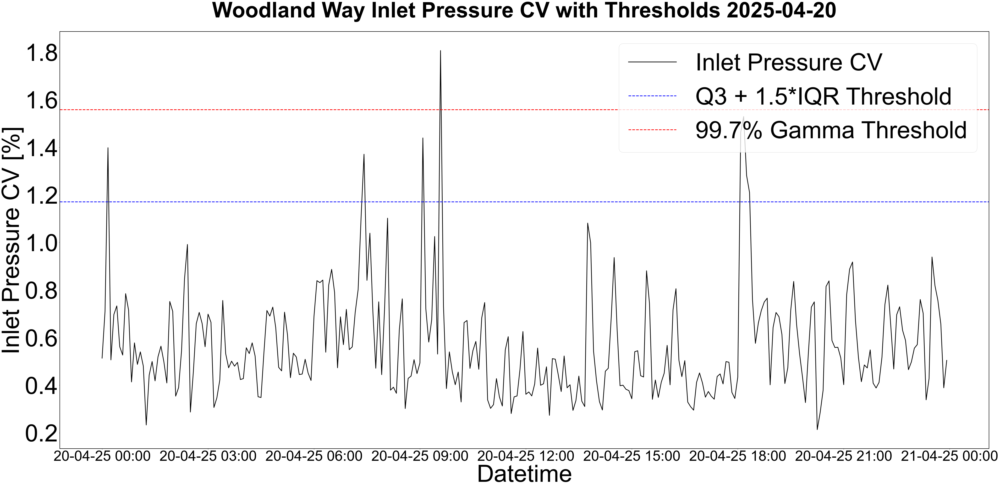

In [37]:
start, end = '2025-04-20', '2025-04-20'
data = Pin_cv_flagged_all_SN.loc[start:end]
IQRT = Pin_cv_flagged_all['cv_upper_iq'][0]
SNT = Pin_cv_flagged_all_SN['cv_upper_dist'][0]
value_col = Pin_cv_str

fig, ax = plt.subplots()
ax.plot(data.index, data[value_col], 'k-', label= 'Inlet Pressure CV', linewidth = 3)
ax.axhline(IQRT, color='b', linestyle='--', label='Q3 + 1.5*IQR Threshold', linewidth = 3)
ax.axhline(SNT, color='r', linestyle='--', label='99.7% Gamma Threshold', linewidth = 3)
ax.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m-%y %H:%M'))
ax.set_xlabel('Datetime', fontsize = 100)
ax.set_ylabel('Inlet Pressure CV [%]', fontsize = 100)
ax.set_title(f'Woodland Way Inlet Pressure CV with Thresholds {start}', fontweight = 'bold')
ax.legend( fontsize = 100)
ax.grid(False)
plt.xticks(fontsize=60)
plt.yticks(fontsize=100)
plt.tight_layout()
plt.show()

### 4.7. Results Analysis

In [38]:
period_start = pd.Timestamp('2024-01-01')
period_end   = pd.Timestamp('2025-04-30')
n_days       = (period_end - period_start).days + 1  # inclusive

def summarize_anomalies(df, name):
    # 1) Boolean mask
    mask = df['cv_count_iq'] > 0

    ts       = df.index.to_series()
    deltas   = ts.diff().shift(-1)
    deltas.iloc[-1] = deltas.median()
    total_time    = deltas[mask].sum()
    total_minutes = total_time / pd.Timedelta('1T')
    grp           = (mask != mask.shift(fill_value=False)).cumsum()
    event_lengths = df.loc[mask].groupby(grp).size()
    
    avg_minutes = total_minutes / n_days
    
    starts       = mask & ~mask.shift(fill_value=False)
    event_dates  = df.index[starts].normalize()
    daily_events = pd.Series(event_dates).value_counts().sort_index()
    avg_events   = daily_events.mean()

    n_single  = (event_lengths == 1).sum()
    n_lt5     = (event_lengths < 5).sum()
    n_lt15    = (event_lengths < 15).sum()
    n_lt60    = (event_lengths < 60).sum()
    n_gt60    = (event_lengths > 60).sum()   

    is_anom = mask.astype(int)
    anom_min_by_month = (
        is_anom
          .resample('M')
          .sum()
          .loc['2024-02':'2025-04']
    )
    mm_most   = anom_min_by_month.idxmax().strftime('%Y-%m')
    mm_least  = anom_min_by_month.idxmin().strftime('%Y-%m')
    val_most  = anom_min_by_month.max()
    val_least = anom_min_by_month.min()

    event_month     = df.index[starts].to_period('M')
    anom_evt_by_month = (
        event_month.value_counts()
                    .sort_index()
                    .loc[lambda s: s.index != pd.Period('2024-01')]
    )
    me_most   = anom_evt_by_month.idxmax().strftime('%Y-%m')
    me_least  = anom_evt_by_month.idxmin().strftime('%Y-%m')
    ev_most   = anom_evt_by_month.max()
    ev_least  = anom_evt_by_month.min()
    total_events = anom_evt_by_month.sum()

    print(f"\n=== {name} ===")
    print(f"Total flagged minutes:    {total_minutes:.0f}")
    print(f"Avg anomaly‐minutes/day:  {avg_minutes:.2f}")
    print(f"Avg anomaly‐events/day:   {avg_events:.2f}\n")

    print("Event duration counts:")
    print(f"  single-minute:           {n_single}")
    print(f"  <5 min:                  {n_lt5-n_single}")
    print(f"  <15 min:                 {n_lt15-n_lt5}")
    print(f"  <1 h:                    {n_lt60-n_lt15}")
    print(f"  >1 h:                    {n_gt60}\n")

    print("Anomaly‐minutes by month:")
    print(f"  Most:  {mm_most} ({val_most:.0f} min)")
    print(f"  Least: {mm_least} ({val_least:.0f} min)\n")

    print("Anomaly‐events by month:")
    print(f"  Most:  {me_most} ({ev_most} events)")
    print(f"  Least: {me_least} ({ev_least} events)")
    print(f"Total events:             {total_events}")

In [39]:
models = {
    'Flow CV IQR Thresholds': Flow_cv_flagged_all,
    'Pout CV IQR Thresholds': Pout_cv_flagged_all,
    'Pin CV IQR Thresholds': Pin_cv_flagged_all
}

for name, df in models.items():
    summarize_anomalies(df, name)


=== Flow CV IQR Thresholds ===
Total flagged minutes:    23495
Avg anomaly‐minutes/day:  48.34
Avg anomaly‐events/day:   5.58

Event duration counts:
  single-minute:           1259
  <5 min:                  1304
  <15 min:                 63
  <1 h:                    0
  >1 h:                    0

Anomaly‐minutes by month:
  Most:  2024-07 (638 min)
  Least: 2025-02 (69 min)

Anomaly‐events by month:
  Most:  2024-07 (337 events)
  Least: 2025-02 (46 events)
Total events:             2434

=== Pout CV IQR Thresholds ===
Total flagged minutes:    19955
Avg anomaly‐minutes/day:  41.06
Avg anomaly‐events/day:   5.28

Event duration counts:
  single-minute:           1413
  <5 min:                  971
  <15 min:                 53
  <1 h:                    3
  >1 h:                    0

Anomaly‐minutes by month:
  Most:  2024-07 (471 min)
  Least: 2025-02 (53 min)

Anomaly‐events by month:
  Most:  2024-07 (252 events)
  Least: 2025-02 (42 events)
Total events:             2264

==

In [40]:
period_start = pd.Timestamp('2024-01-01')
period_end   = pd.Timestamp('2025-04-30')
n_days       = (period_end - period_start).days + 1  # inclusive

def summarize_anomalies(df, name):
    mask = df['cv_count_dist'] > 0
    
    ts       = df.index.to_series()
    deltas   = ts.diff().shift(-1)
    deltas.iloc[-1] = deltas.median()
    total_time    = deltas[mask].sum()
    total_minutes = total_time / pd.Timedelta('1T')
    grp           = (mask != mask.shift(fill_value=False)).cumsum()
    event_lengths = df.loc[mask].groupby(grp).size()

    avg_minutes = total_minutes / n_days

    starts       = mask & ~mask.shift(fill_value=False)
    event_dates  = df.index[starts].normalize()
    daily_events = pd.Series(event_dates).value_counts().sort_index()
    avg_events   = daily_events.mean()

    n_single  = (event_lengths == 1).sum()
    n_lt5     = (event_lengths < 5).sum()
    n_lt15    = (event_lengths < 15).sum()
    n_lt60    = (event_lengths < 60).sum()
    n_gt60    = (event_lengths > 60).sum() 

    is_anom = mask.astype(int)
    anom_min_by_month = (
        is_anom
          .resample('M')
          .sum()
          .loc['2024-02':'2025-04']
    )
    mm_most   = anom_min_by_month.idxmax().strftime('%Y-%m')
    mm_least  = anom_min_by_month.idxmin().strftime('%Y-%m')
    val_most  = anom_min_by_month.max()
    val_least = anom_min_by_month.min()

    event_month     = df.index[starts].to_period('M')
    anom_evt_by_month = (
        event_month.value_counts()
                    .sort_index()
                    .loc[lambda s: s.index != pd.Period('2024-01')]
    )
    me_most   = anom_evt_by_month.idxmax().strftime('%Y-%m')
    me_least  = anom_evt_by_month.idxmin().strftime('%Y-%m')
    ev_most   = anom_evt_by_month.max()
    ev_least  = anom_evt_by_month.min()
    total_events = anom_evt_by_month.sum()

    print(f"\n=== {name} ===")
    print(f"Total flagged minutes:    {total_minutes:.0f}")
    print(f"Avg anomaly‐minutes/day:  {avg_minutes:.2f}")
    print(f"Avg anomaly‐events/day:   {avg_events:.2f}\n")

    print("Event duration counts:")
    print(f"  single-minute:           {n_single}")
    print(f"  <5 min:                  {n_lt5-n_single}")
    print(f"  <15 min:                 {n_lt15-n_lt5}")
    print(f"  <1 h:                    {n_lt60-n_lt15}")
    print(f"  >1 h:                    {n_gt60}\n")

    print("Anomaly‐minutes by month:")
    print(f"  Most:  {mm_most} ({val_most:.0f} min)")
    print(f"  Least: {mm_least} ({val_least:.0f} min)\n")

    print("Anomaly‐events by month:")
    print(f"  Most:  {me_most} ({ev_most} events)")
    print(f"  Least: {me_least} ({ev_least} events)")
    print(f"Total events:             {total_events}")

In [41]:
models = {
    'Flow CV SN Thresholds': Flow_cv_flagged_all_SN,
    'Pout CV SN Thresholds': Pout_cv_flagged_all_SN,
    'Pin CV SN Thresholds': Pin_cv_flagged_all_SN
}

for name, df in models.items():
    summarize_anomalies(df, name)


=== Flow CV SN Thresholds ===
Total flagged minutes:    3385
Avg anomaly‐minutes/day:  6.97
Avg anomaly‐events/day:   1.78

Event duration counts:
  single-minute:           211
  <5 min:                  202
  <15 min:                 4
  <1 h:                    0
  >1 h:                    0

Anomaly‐minutes by month:
  Most:  2024-07 (102 min)
  Least: 2024-12 (5 min)

Anomaly‐events by month:
  Most:  2024-07 (69 events)
  Least: 2024-12 (3 events)
Total events:             381

=== Pout CV SN Thresholds ===
Total flagged minutes:    3635
Avg anomaly‐minutes/day:  7.48
Avg anomaly‐events/day:   1.81

Event duration counts:
  single-minute:           266
  <5 min:                  179
  <15 min:                 12
  <1 h:                    0
  >1 h:                    0

Anomaly‐minutes by month:
  Most:  2025-04 (171 min)
  Least: 2025-02 (3 min)

Anomaly‐events by month:
  Most:  2025-04 (77 events)
  Least: 2025-02 (2 events)
Total events:             430

=== Pin CV SN Thresh

### 4.8. Feature Extraction

In [42]:
flagged_features['Flow_cv_count_iq']    = Flow_cv_flagged_all['cv_count_iq'].loc[flagged_features.index]
flagged_features['Pout_cv_count_iq']    = Pout_cv_flagged_all['cv_count_iq'].loc[flagged_features.index]
flagged_features['Pin_cv_count_iq']    = Pin_cv_flagged_all['cv_count_iq'].loc[flagged_features.index]

flagged_features = flagged_features.fillna(0)

### 4.9. Dynamic Time Warping

This section provides plots for dynamic time warping showing their ideal warping paths. Start and end dates can be adjusted to view different periods

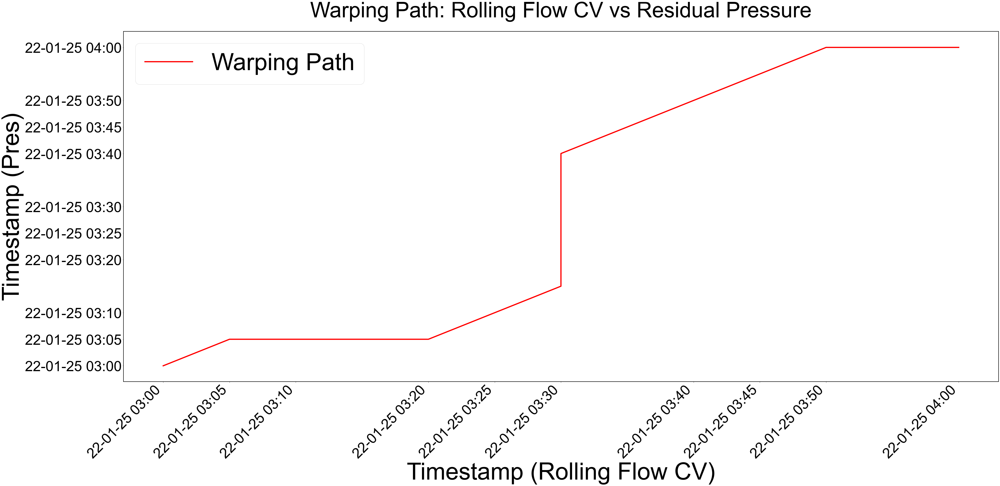

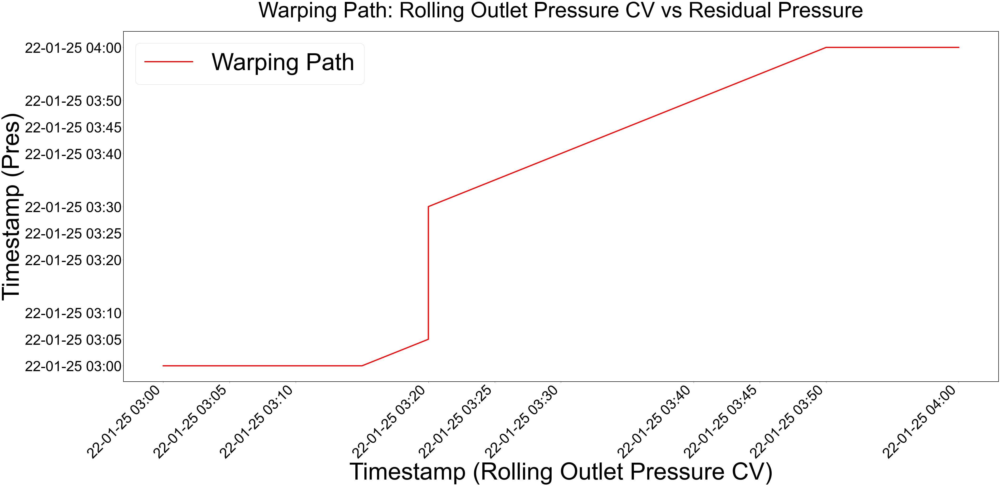

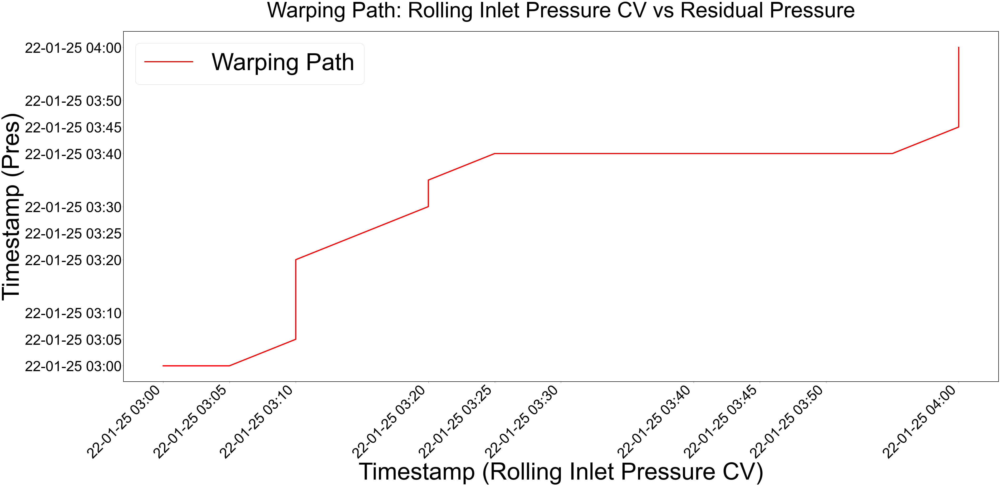


=== Rolling Flow CV vs Pres ===
DTW distance: 3.3978
Synchronized peaks (ts1_timestamp ↔ Pres_timestamp):
Total synchronized events: 0

=== Rolling Outlet Pressure CV vs Pres ===
DTW distance: 3.1179
Synchronized peaks (ts1_timestamp ↔ Pres_timestamp):
Total synchronized events: 0

=== Rolling Inlet Pressure CV vs Pres ===
DTW distance: 2.9168
Synchronized peaks (ts1_timestamp ↔ Pres_timestamp):
Total synchronized events: 0


In [43]:
start = '2025-01-22 03:00'
end   = '2025-01-22 04:00'

def zscore_normalize(s: pd.Series) -> pd.Series:
    return (s - s.mean()) / s.std()

flow_norm = zscore_normalize(Flow_cv_rolling[start:end].iloc[:, 0])
pout_norm = zscore_normalize(Pout_cv_rolling[start:end].iloc[:, 0])
pin_norm  = zscore_normalize(Pin_cv_rolling[start:end].iloc[:, 0])
pres_norm = zscore_normalize(Pres[start:end].iloc[:, 0])

results = {}

for label, series_norm in [
    ("Rolling Flow CV", flow_norm),
    ("Rolling Outlet Pressure CV", pout_norm),
    ("Rolling Inlet Pressure CV", pin_norm),
]:
    distance = dtw.distance(series_norm.values, pres_norm.values)
    alignment_path = dtw.warping_path(series_norm.values, pres_norm.values)

    peaks1, _ = find_peaks(series_norm, prominence=1)
    peaks2, _ = find_peaks(pres_norm,   prominence=1)

    synchronized_events = []
    for p1 in peaks1:
        for (i, j) in alignment_path:
            if i == p1 and j in peaks2:
                synchronized_events.append((series_norm.index[p1], pres_norm.index[j]))

    x = series_norm.values
    y = pres_norm.values

    n, m = len(x), len(y)

    path_i = np.array([p[0] for p in alignment_path])
    path_j = np.array([p[1] for p in alignment_path])

    fig_path, ax_path = plt.subplots()
    ax_path.plot(path_i, path_j, color='red', linewidth=5, label='Warping Path')
    num_ticks = 10
    x_tick_positions = np.linspace(0, n - 1, num_ticks, dtype=int)
    y_tick_positions = np.linspace(0, m - 1, num_ticks, dtype=int)

    x_tick_labels = [
        series_norm.index[pos].strftime('%d-%m-%y %H:%M')
        for pos in x_tick_positions
    ]
    y_tick_labels = [
        pres_norm.index[pos].strftime('%d-%m-%y %H:%M')
        for pos in y_tick_positions
    ]

    ax_path.set_xticks(x_tick_positions)
    ax_path.set_xticklabels(x_tick_labels, rotation=45, ha='right')
    ax_path.set_yticks(y_tick_positions)
    ax_path.set_yticklabels(y_tick_labels)

    ax_path.set_title(f"Warping Path: {label} vs Residual Pressure")
    ax_path.set_xlabel(f"Timestamp ({label})", fontsize=100)
    ax_path.set_ylabel("Timestamp (Pres)", fontsize=100)
    ax_path.legend(fontsize=100)
    plt.tight_layout()
    plt.show()

    results[label] = {
        'dtw_distance': distance,
        'alignment_path': alignment_path,
        'peaks_in_' + label: peaks1,
        'peaks_in_Pres': peaks2,
        'synchronized_events': synchronized_events
    }

for label, info in results.items():
    print(f"\n=== {label} vs Pres ===")
    print(f"DTW distance: {info['dtw_distance']:.4f}")
    print("Synchronized peaks (ts1_timestamp ↔ Pres_timestamp):")
    for (t1, t2) in info['synchronized_events']:
        print(f"  {t1} ↔ {t2}")
    print(f"Total synchronized events: {len(info['synchronized_events'])}")

In [44]:
#flagged_features.to_csv("C:/Users/megat/Desktop/MegatAiman/University/Year4/FYP/Data/WoodlandWay/FlaggedData/Flagged_features_WW.csv", index=True)

## 5. Drift Detection

This section provides the analysis using the CUSUM and BOCPD models. Start and end dates can be adjusted to view different periods.

### 5.1. CUSUM

In [45]:
def cusum_daily_mean(df, col='residual_pressure', baseline_days=7, k=None, h=None):
    """
    Parameters
    ----------
    df              : DataFrame
                      Minute‐level data with a DateTimeIndex and a column named `col`.
    col             : str, default 'residual_pressure'
                      Which column to aggregate.
    baseline_days   : int, default 7
                      How many initial days to use for the reference mean.
    k               : float or None, default None
                      Slack parameter for CUSUM; if None, uses std(daily means).
    h               : float or None, default None
                      Threshold for alert; if None, uses 3×std(daily means).

    """

    daily = df[col].resample('D').mean()
    mu0 = daily.iloc[:baseline_days].mean()
    sigma = daily.iloc[:baseline_days].std()
    if k is None:
        k = sigma
    if h is None:
        h = 3 * sigma

    c_p, c_n = 0.0, 0.0
    pos, neg, flags = [], [], []
    for x in daily:
        delta = x - mu0
        c_p = max(0, c_p + delta - k)
        c_n = min(0, c_n + delta + k)
        pos.append(c_p)
        neg.append(c_n)
        flags.append(int(c_p > h or abs(c_n) > h))

    return pd.DataFrame({
        'daily_mean': daily,
        'cusum_pos':  pos,
        'cusum_neg':  neg,
        'drift_flag': flags
    }, index=daily.index)

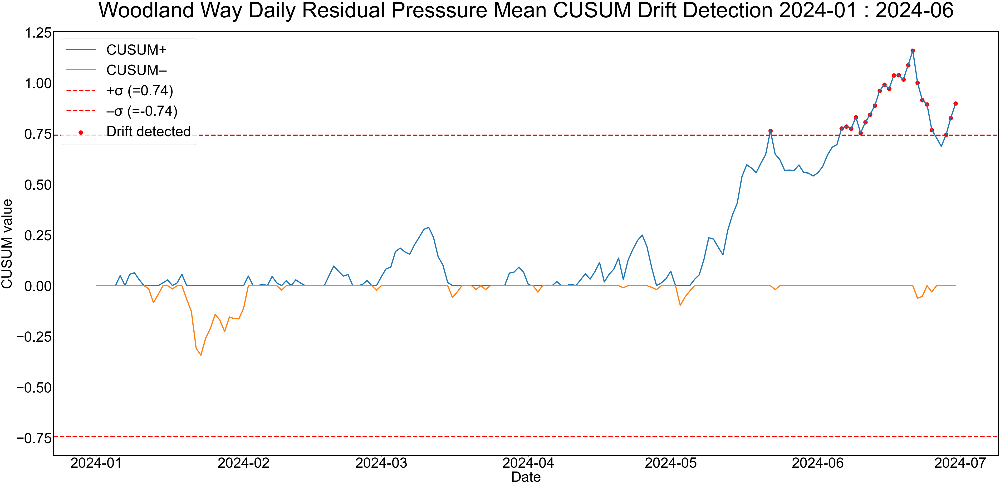

In [46]:
start = '2024-01'
end = '2024-06'

sigma = float(Pres['2024-01'].std())
h = 1 * sigma

cusum_df = cusum_daily_mean(Pres[start:end], col='residual_pressure', h = h)

plt.figure()
plt.plot(cusum_df.index, cusum_df['cusum_pos'], label='CUSUM+', linewidth=5)
plt.plot(cusum_df.index, cusum_df['cusum_neg'], label='CUSUM–', linewidth=5)
plt.axhline(h, color='red', linestyle='--', label=f'+σ (={h:.2f})', linewidth=5)
plt.axhline(-h, color='red', linestyle='--', label=f'–σ (={-h:.2f})', linewidth=5)
drift_days = cusum_df[cusum_df['drift_flag'] == 1]
plt.scatter(drift_days.index, drift_days['cusum_pos'],
            color='red', marker='o', s=300, label='Drift detected')
plt.xlabel('Date')
plt.ylabel('CUSUM value')
plt.title(f'Woodland Way Daily Residual Presssure Mean CUSUM Drift Detection {start} : {end}')
plt.legend()
plt.tight_layout()
#plt.grid(True)
plt.show()

### 5.2. Bayesian Online Changepoint Detection

In [47]:
class OnlineBOCPD:
    def __init__(
        self,
        hazard=1/200,
        alpha=1.0,
        beta=1.0,
        kappa=1.0,
        mu0=0.0,
        T=1000,
        cp_threshold=0.1,
        max_run_length=None,
    ):
        """
        Parameters:
        - hazard: constant hazard rate
        - alpha, beta, kappa, mu0: Normal-Inverse-Gamma prior params
        - T: maximum time steps for run-length grid
        - cp_threshold: threshold on cp_prob to define raw is_cp
        - max_run_length: optional periodic reset interval
        """
        self.hazard = hazard
        self.T = T
        self.cp_threshold = cp_threshold
        self.max_run_length = max_run_length

        # Prior hyperparameters
        self.alpha0 = alpha
        self.beta0 = beta
        self.kappa0 = kappa
        self.mu0 = mu0

        # Initialize run-length posterior matrix R
        self.R = np.zeros((T + 1, T + 1))
        self.R[0, 0] = 1.0

        # Posterior hyperparams per run length
        self.muT    = {0: mu0}
        self.kappaT = {0: kappa}
        self.alphaT = {0: alpha}
        self.betaT  = {0: beta}

        # Will store flagged timestamps
        self.cp_times = []

        # Raw and final flags
        self.cp_probs  = []
        self.raw_flags = []
        self.cp_flags  = []

    def update(self, x, t):
        if self.max_run_length and t > 0 and t % self.max_run_length == 0:
            self.R[:] = 0.0
            self.R[0, t] = 1.0
            self.muT    = {0: self.mu0}
            self.kappaT = {0: self.kappa0}
            self.alphaT = {0: self.alpha0}
            self.betaT  = {0: self.beta0}

        # Predictive probabilities under Student-t
        pred = np.zeros(t + 1)
        for rl in range(t + 1):
            mu, kappa = self.muT[rl], self.kappaT[rl]
            alpha, beta = self.alphaT[rl], self.betaT[rl]
            scale = np.sqrt((beta * (kappa + 1)) / (alpha * kappa))
            pred[rl] = student_t.pdf(x, df=2 * alpha, loc=mu, scale=scale)

        prev = self.R[:t + 1, t]
        growth = prev * pred * (1 - self.hazard)
        cp_prob = np.sum(prev * pred * self.hazard)

        # Update run-length posterior matrix for t+1
        self.R[1:t + 2, t + 1] = growth
        self.R[0,    t + 1] = cp_prob
        self.R[:,    t + 1] /= np.sum(self.R[:, t + 1])

        # Update hyperparameters
        new_muT, new_kappaT = {0: self.mu0}, {0: self.kappa0}
        new_alphaT, new_betaT = {0: self.alpha0}, {0: self.beta0}
        for rl in range(t + 1):
            mu, kappa = self.muT[rl], self.kappaT[rl]
            alpha, beta = self.alphaT[rl], self.betaT[rl]
            nk = kappa + 1
            nm = (kappa * mu + x) / nk
            na = alpha + 0.5
            nb = beta + (kappa * (x - mu)**2) / (2 * nk)
            new_muT[rl + 1]    = nm
            new_kappaT[rl + 1] = nk
            new_alphaT[rl + 1] = na
            new_betaT[rl + 1]  = nb
        self.muT, self.kappaT = new_muT, new_kappaT
        self.alphaT, self.betaT = new_alphaT, new_betaT

        # Record and return cp_prob
        self.cp_probs.append(cp_prob)
        return cp_prob

    def run(self, data, time_index=None):
        n = len(data)
        self.raw_flags = []
        self.cp_flags  = []
        self.cp_times  = []
        self.cp_probs  = []

        for i, x in enumerate(data):
            cp = self.update(x, i)
            self.raw_flags.append(int(cp < self.cp_threshold))

        idx = time_index if time_index is not None else pd.Index(np.arange(n))
        day0_end = idx[0] + pd.Timedelta(days=90)
        final = [0]*n
        #for i in range(n - 2):
        for i in range(n):
            #and self.raw_flags[i+1]
            if (self.raw_flags[i]):
                # ensure timestamp after first day
                if idx[i] > day0_end:
                    final[i] = 1
        self.cp_flags = final
        self.cp_times = [idx[i] for i, f in enumerate(final) if f]

        # Build DataFrame
        df = pd.DataFrame({
            'value':    data,
            'cp_prob':  self.cp_probs,
            'cp_flag':  self.cp_flags
        }, index=idx)
        return df

    def plot(self, time_index, data, threshold=None):
        df = self.run(data, time_index)
        plt.figure()
        plt.plot(df.index, df['value'], label='Normalised Residual Pressure', linewidth = 3)
        for t in self.cp_times:
            plt.axvline(t, color='red', linestyle='--', linewidth = 3)
        plt.title('Woodland Way Normalised Residual Bayesian Online Changepoint Detection')
        plt.xlabel('Time'); plt.ylabel(r'Normalised Residual Pressure [$mH_2O$ / L/s]')
        plt.legend(); plt.grid(True); plt.tight_layout(); plt.show()
        plt.figure()
        plt.plot(df.index, df['cp_prob'], label=r'P($r_t$=0)', color='orange', linewidth = 3)
        for t in self.cp_times:
            plt.axvline(t, color='red', linestyle='--', linewidth = 3)
        plt.title('Changepoint Probability Over Time')
        plt.xlabel('Time'); plt.ylabel('P(run length = 0)')
        plt.legend(); plt.grid(True);plt.tight_layout(); plt.show()
        return df


               value   cp_prob  cp_flag
2024-01-01  0.005702  0.072138        0
2024-01-02  0.016796  0.091077        0
2024-01-03  0.013478  0.105770        0
2024-01-04  0.006210  0.118090        0
2024-01-05  0.016233  0.129173        0
2024-01-06  0.019599  0.139349        0
2024-01-07  0.010423  0.148995        0
2024-01-08  0.017952  0.158268        0
2024-01-09  0.015376  0.167239        0
2024-01-10  0.017339  0.175921        0

Changepoints detected at:
               value  cp_prob  cp_flag
2024-04-28 -0.065233  0.23866        1


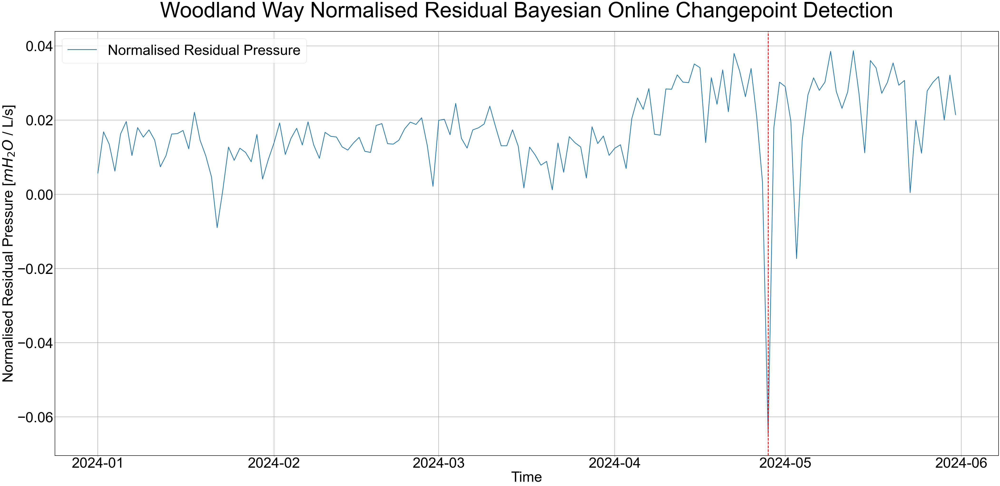

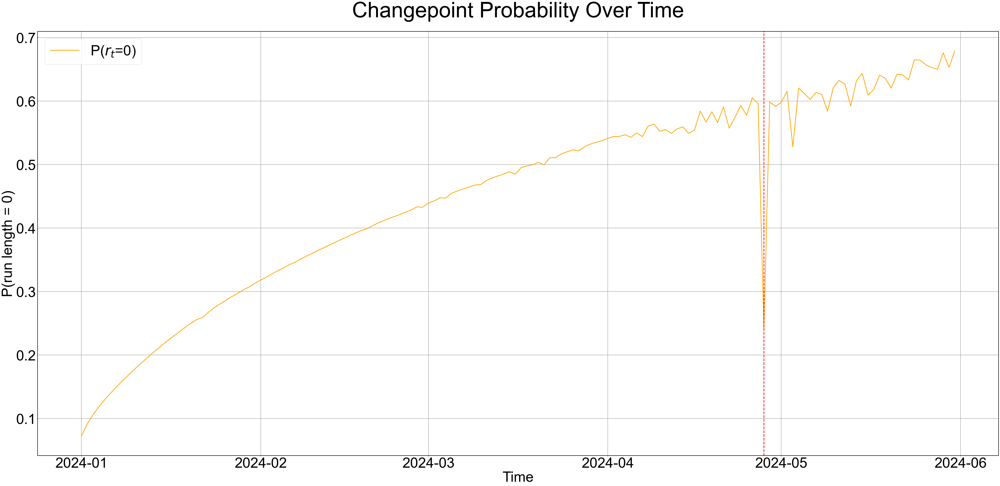

,value,cp_prob,cp_flag
2024-01-01,0.005702,0.072138,0
2024-01-02,0.016796,0.091077,0
2024-01-03,0.013478,0.105770,0
2024-01-04,0.006210,0.118090,0
2024-01-05,0.016233,0.129173,0
...,...,...,...
2024-05-27,0.030143,0.652793,0
2024-05-28,0.031703,0.649960,0
2024-05-29,0.019987,0.675988,0
2024-05-30,0.032091,0.653066,0


In [48]:
hourly_data = (
    Normalised[Normalised_str]['2024-01':'2024-05']
      .resample('24H')
      .mean()
      .dropna()
)

values     = hourly_data.values
time_index = hourly_data.index
mu0_est    = hourly_data.mean()
beta0 = 0.8
hazard0 = 0.1

bocd = OnlineBOCPD(
    hazard=0.10,
    alpha=1.0, beta=0.2, kappa=5,
    mu0=mu0_est,
    T=len(values),
    cp_threshold=0.3,
    max_run_length=None
)

results = bocd.run(values, time_index=time_index)

print(results.head(10))
print("\nChangepoints detected at:")
print(results[results.cp_flag == 1])

bocd.plot(time_index, values)

## 6. Event Labelling

This section provides plotting code of the original timeseries valve measurements to identify and label faults. The first code block allows for manual adjustment of the start and end dates whilst the second code block provides an automated plotting code of all faults between specified dates. 

In [66]:
# start = '2025-04-17 22:00'
# end = '2025-04-17 23:59'

# fig, ax1 = plt.subplots()

# ax1.plot(Pin_1T[start:end], label='Inlet Pressure', color='red', linewidth = 3)
# ax1.plot(Pout_1T[start:end], label='Outlet Pressure', color='blue', linewidth = 3)
# ax1.plot(Ptarget_1T[start:end], label='Target Pressure', color='cyan', linewidth = 3)
# ax1.plot(Stem_1T[start:end], label='Stem position', color ='black', linewidth = 3)
# ax1.set_ylabel(r'Pressure [$mH_2O$] / Stem position [mm]', fontsize = 100)
# ax1.set_xlabel('Date-time', fontsize = 100)
# ax1.tick_params(axis='y', labelsize=100)
# ax1.tick_params(axis='x', labelsize=75)

# ax2 = ax1.twinx()
# ax2.plot(Flow_1T[start:end], label='Flow', color='green', linewidth = 3)
# ax2.set_ylabel('Flow [L/s]', fontsize = 100)


# ax1.set_title(f'Valve Dynamics', fontweight='bold')
# lines_1, labels_1 = ax1.get_legend_handles_labels()
# lines_2, labels_2 = ax2.get_legend_handles_labels()
# ax1.legend(lines_1 + lines_2, labels_1 + labels_2, loc='best', fontsize = 100)
# ax1.xaxis.set_major_formatter(mdates.DateFormatter('%d-%m %H:%M'))

# plt.xticks(fontsize = 100)
# plt.yticks(fontsize = 100)
# plt.tight_layout()
# plt.show()

In [50]:
# start = '2025-04-01'
# end   = '2025-04-07'
# df = (
#     Flow['flow']
#       .loc[start:end]
#       .rename_axis('timestamp')
#       .reset_index()
# )

# df['time_5min'] = (
#     df['timestamp']
#       .dt.floor('1H')
#       .dt.strftime('%H:%M')
# )


# bins = sorted(df['time_5min'].unique(),
#               key=lambda t: pd.to_datetime(t, format='%H:%M'))
# flows_by_bin = [df.loc[df['time_5min']==t, 'flow'].values for t in bins]


# plt.figure()
# plt.boxplot(
#     flows_by_bin,
#     positions=range(len(bins)),
#     showmeans=True,
#     meanline=True,
#     meanprops=dict(color="red", linewidth=3.0, linestyle='-'),
#     medianprops=dict(color="white", linewidth=0),
#     flierprops=dict(marker="+", markeredgecolor="red", markersize=14),
#     whiskerprops=dict(linestyle=(5, (8, 5)), linewidth=2.0),
#     boxprops=dict(color='black', linewidth=2.0),
#     capprops=dict(linewidth=2.0)
# )


# tick_idxs   = list(range(0, len(bins), 12))
# tick_labels = [bins[i] for i in tick_idxs]
# plt.xticks(tick_idxs, tick_labels, rotation=90)

# plt.xlabel('Time of day')
# plt.ylabel('Flow')
# plt.title(f'Flow distribution over 24 hours {start} to {end}')
# plt.grid(axis='y', linestyle='--', alpha=0.5)
# plt.tight_layout()
# plt.show()

## 7. Random Forest

The code below represents the fault diagnosis pipeline with a random forest classifier. A preliminary analysis of the dataset is first carried out followed by model training, evaluation, and cross application.

### 7.1. Labelled dataset analysis

In [51]:
labelled_flagged_features = pd.read_csv("../../Data/WoodlandWay/FlaggedData/Flagged_features_WW_labelled.csv", parse_dates=[0], index_col=0)
labelled_flagged_features['label'].fillna('Unclassified', inplace=True)

In [52]:
FF = Flow_cv_flagged_all[Flow_cv_flagged_all['cv_count_iq']>0]
PoF = Pout_cv_flagged_all[Pout_cv_flagged_all['cv_count_iq']>0]
PiF = Pin_cv_flagged_all[Pin_cv_flagged_all['cv_count_iq']>0]
target = normalised_flagged_all[normalised_flagged_all['count']>0]

for df in [
    FF,
    PoF,
    PiF,
    target,
]:
    df.index = pd.to_datetime(df.index)

label_ts = set(target.index)

def pct_in_label_floored(df):
    total = len(df)
    if total == 0:
        return 0.0
    floored_index = df.index
    matched = floored_index.isin(label_ts).sum()
    return matched / total * 100

results = {
    "Flow CV IQR Thresholds": pct_in_label_floored(FF),
    "Pout CV IQR Thresholds": pct_in_label_floored(PoF),
    "Pin CV IQR Thresholds": pct_in_label_floored(PiF),
}

for name, pct in results.items():
    print(f"{name}: {pct:.2f}% of index‐timestamps (floored to 5T) appear in labelled_flagged_features")
    
for df in [FF, PoF, PiF, target]:
    df.index = pd.to_datetime(df.index)

combined_ts = set(FF.index).union(PoF.index).union(PiF.index)

matched_in_target = target.index.isin(combined_ts).sum()
total_target = len(target)

if total_target > 0:
    pct_combined = matched_in_target / total_target * 100
else:
    pct_combined = 0.0

print(f"{pct_combined:.2f}% of target timestamps are from FF, PoF, or PiF combined")


Flow CV IQR Thresholds: 23.41% of index‐timestamps (floored to 5T) appear in labelled_flagged_features
Pout CV IQR Thresholds: 17.84% of index‐timestamps (floored to 5T) appear in labelled_flagged_features
Pin CV IQR Thresholds: 11.84% of index‐timestamps (floored to 5T) appear in labelled_flagged_features
13.71% of target timestamps are from FF, PoF, or PiF combined


In [53]:

FF = Flow_cv_flagged_all_SN[Flow_cv_flagged_all_SN['cv_count_dist']>0]
PoF = Pout_cv_flagged_all_SN[Pout_cv_flagged_all_SN['cv_count_dist']>0]
PiF = Pin_cv_flagged_all_SN[Pin_cv_flagged_all_SN['cv_count_dist']>0]
target = residual_flagged_all[residual_flagged_all['count']>0]

for df in [
    FF,
    PoF,
    PiF,
   target,
]:
    df.index = pd.to_datetime(df.index)

label_ts = set(target.index)

def pct_in_label_floored(df):
    total = len(df)
    if total == 0:
        return 0.0
    floored_index = df.index
    matched = floored_index.isin(label_ts).sum()
    return matched / total * 100

results = {
    "Flow CV SN Thresholds": pct_in_label_floored(FF),
    "Pout CV SN Thresholds": pct_in_label_floored(PoF),
    "Pin CV SN Thresholds": pct_in_label_floored(PiF),
}

for name, pct in results.items():
    print(f"{name}: {pct:.2f}% of index‐timestamps (floored to 5T) appear in labelled_flagged_features")

for df in [FF, PoF, PiF, target]:
    df.index = pd.to_datetime(df.index)

combined_ts = set(FF.index).union(PoF.index).union(PiF.index)

matched_in_target = target.index.isin(combined_ts).sum()
total_target = len(target)

if total_target > 0:
    pct_combined = matched_in_target / total_target * 100
else:
    pct_combined = 0.0

print(f"{pct_combined:.2f}% of target timestamps are from FF, PoF, or PiF combined")

Flow CV SN Thresholds: 11.52% of index‐timestamps (floored to 5T) appear in labelled_flagged_features
Pout CV SN Thresholds: 26.82% of index‐timestamps (floored to 5T) appear in labelled_flagged_features
Pin CV SN Thresholds: 10.58% of index‐timestamps (floored to 5T) appear in labelled_flagged_features
3.12% of target timestamps are from FF, PoF, or PiF combined


In [54]:
n_unique = labelled_flagged_features['label'].nunique()
print(f"Number of unique labels: {n_unique}")

unique_labels = labelled_flagged_features['label'].unique()
print("Unique labels:", unique_labels)

label_counts = labelled_flagged_features['label'].value_counts()
print("Counts per label:")
print(label_counts)

Number of unique labels: 9
Unique labels: ['Drop_in_inlet_pressure' 'Drop_in_outlet_pressure' 'Failure'
 'Further_classification' 'System_dynamics' 'Likely_failure'
 'Speed_control' 'Large_step_change' 'Valve_dynamics']
Counts per label:
Drop_in_outlet_pressure    1233
Likely_failure              416
Speed_control               196
Failure                     161
System_dynamics             147
Valve_dynamics              140
Drop_in_inlet_pressure       72
Further_classification       67
Large_step_change            24
Name: label, dtype: int64


### 7.2. Model training & evaluation

In [55]:
def train_and_evaluate_rf2(
    df,
    feature_cols=None,
    label_col='label',
    test_size=0.3,
    random_state=42,
    grid_params=None,
    cv=5,
    n_jobs=-1
):

    start_time = time.time()

    df = df.copy()
    if not isinstance(df.index, pd.DatetimeIndex):
        df.index = pd.to_datetime(df.index.astype(str))
    df[label_col] = df[label_col].astype(str)
    if feature_cols is None:
        feature_cols = [c for c in df.columns if c != label_col]

    obj_cols = df[feature_cols].select_dtypes(include=['object', 'category']).columns.tolist()
    if obj_cols:
        df = pd.get_dummies(df, columns=obj_cols, drop_first=True)
        feature_cols = [c for c in df.columns if c != label_col]

    # Split into train/test
    X_full = df[feature_cols]
    y_full = df[label_col]

    X_train, X_test, y_train, y_test = train_test_split(
        X_full, y_full,
        test_size=test_size,
        stratify=y_full,
        random_state=random_state
    )

    # Train with or without GridSearchCV
    base_clf = RandomForestClassifier(random_state=random_state, class_weight='balanced')
    best_params = {}
    if grid_params:
        grid = GridSearchCV(
            estimator=base_clf,
            param_grid=grid_params,
            cv=cv,
            scoring='accuracy',
            n_jobs=n_jobs,
            refit=True
        )
        grid.fit(X_train, y_train)
        clf = grid.best_estimator_
        best_params = grid.best_params_
        print("Best parameters found by grid search:", best_params)
    else:
        clf = base_clf.fit(X_train, y_train)

    # Evaluate on test set
    y_pred_test = clf.predict(X_test)
    report_test = classification_report(y_test, y_pred_test)
    cm_test = confusion_matrix(y_test, y_pred_test)

    print("=== Test‐Set Classification Report (Random Forest) ===")
    print(report_test)

    # Compute metrics on the entire dataset (X_full, y_full)
    y_pred_full = clf.predict(X_full)
    accuracy_overall = accuracy_score(y_full, y_pred_full)
    accuracy_macro = balanced_accuracy_score(y_full, y_pred_full)
    
    precision_macro = precision_score(y_full, y_pred_full, average='macro', zero_division=0)
    recall_macro    = recall_score(y_full, y_pred_full, average='macro', zero_division=0)
    f1_macro        = f1_score(y_full, y_pred_full, average='macro', zero_division=0)
    cm_full = confusion_matrix(y_full, y_pred_full, labels=clf.classes_)
    cm_full_df = pd.DataFrame(cm_full, index=clf.classes_, columns=clf.classes_)
    fpr_dict = {}
    for cls in clf.classes_:
        TN = cm_full_df.drop(index=cls, columns=cls).values.sum()
        FP = cm_full_df[cls].sum() - cm_full_df.at[cls, cls]
        fpr_dict[cls] = FP / (FP + TN) if (FP + TN) > 0 else 0.0

    fpr_per_class = pd.Series(fpr_dict).sort_index()

    total_FP = sum(fpr_dict[cls] * (fpr_dict[cls] + 
                 (cm_full_df.drop(index=cls, columns=cls).values.sum())) 
                   for cls in clf.classes_)
    total_FP = sum(cm_full_df[col].sum() - cm_full_df.at[col, col] for col in clf.classes_)
    total_TN = sum(cm_full_df.drop(index=cls, columns=cls).values.sum() for cls in clf.classes_)
    fpr_overall = total_FP / (total_FP + total_TN) if (total_FP + total_TN) > 0 else 0.0

    metrics_full = {
        'accuracy_overall': accuracy_overall,
        'accuracy_macro':   accuracy_macro,
        'precision_macro': precision_macro,
        'recall_macro':    recall_macro,
        'f1_macro':        f1_macro,
        'fpr_per_class':   fpr_per_class,
        'fpr_overall':     fpr_overall
    }

    print("\n=== Metrics on Full Dataset (macro-averaged) ===")
    print(f"Overall Accuracy       : {accuracy_overall:.3f}")
    print(f"Macro-Averaged Accuracy: {accuracy_macro:.3f}")
    print(f"Precision (macro) : {precision_macro:.3f}")
    print(f"Recall    (macro) : {recall_macro:.3f}")
    print(f"F1        (macro) : {f1_macro:.3f}")
    print("\nFalse Positive Rate per class:")
    print(fpr_per_class.to_frame(name='FPR'))
    print(f"\nOverall FPR (micro-averaged): {fpr_overall:.3f}")

    # Feature importances
    importances = pd.Series(
        clf.feature_importances_,
        index=feature_cols
    ).sort_values(ascending=False)

    # Plot confusion matrix 
    class_labels = clf.classes_
    fig, ax = plt.subplots()
    sns.heatmap(
        cm_test,
        annot=True,
        fmt='d',
        cmap='Blues',
        xticklabels=class_labels,
        yticklabels=class_labels,
        ax=ax
    )
    ax.set_title('Confusion Matrix (Test Set)')
    ax.set_xlabel('Predicted')
    ax.set_ylabel('True')
    plt.setp(ax.get_xticklabels(), rotation=90, ha='right')
    plt.setp(ax.get_yticklabels(), rotation=0, ha='right')
    plt.tight_layout()
    plt.show()

    # Plot top‐5 feature importances
    top5 = importances.head(5)
    fig2, ax2 = plt.subplots()
    top5.plot(kind='bar', ax=ax2)
    ax2.set_title('Top 5 Feature Importances')
    ax2.set_ylabel('Importance')
    ax2.set_xlabel('Feature')
    plt.xticks(rotation=0, ha='right')
    plt.tight_layout()
    plt.show()

    elapsed_time_min = (time.time() - start_time) / 60
    print(f"\nFunction runtime: {elapsed_time_min:.2f} minutes")

    return (
        clf,
        report_test,
        cm_test,
        importances,
        metrics_full,
        best_params,
        elapsed_time_min
    )

Best parameters found by grid search: {'max_depth': 20, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 200}
=== Test‐Set Classification Report (Random Forest) ===
                         precision    recall  f1-score   support

 Drop_in_inlet_pressure       0.93      0.59      0.72        22
Drop_in_outlet_pressure       0.88      0.99      0.93       370
                Failure       1.00      0.92      0.96        48
 Further_classification       1.00      0.95      0.97        20
      Large_step_change       1.00      1.00      1.00         7
         Likely_failure       0.97      0.97      0.97       125
          Speed_control       0.86      0.75      0.80        59
        System_dynamics       0.90      0.59      0.71        44
         Valve_dynamics       0.86      0.57      0.69        42

               accuracy                           0.90       737
              macro avg       0.93      0.81      0.86       737
           weig

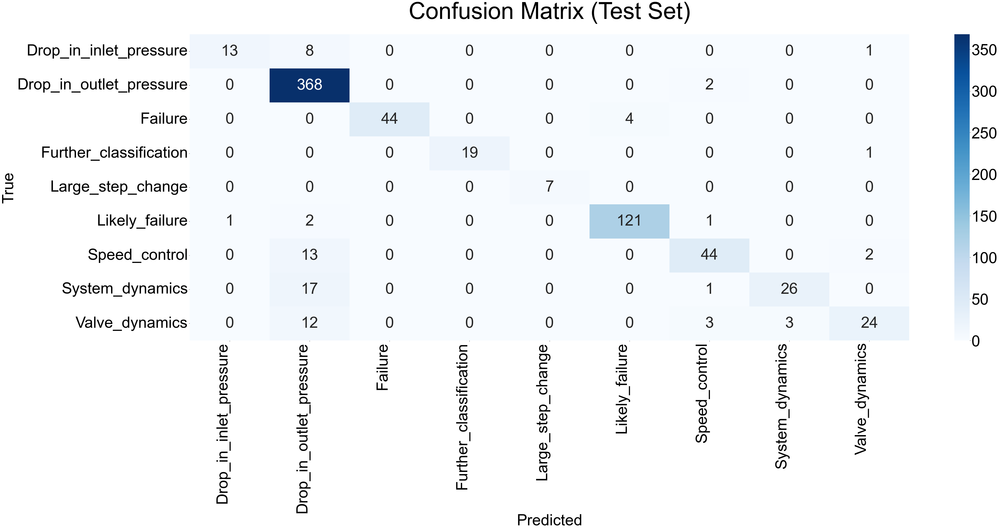

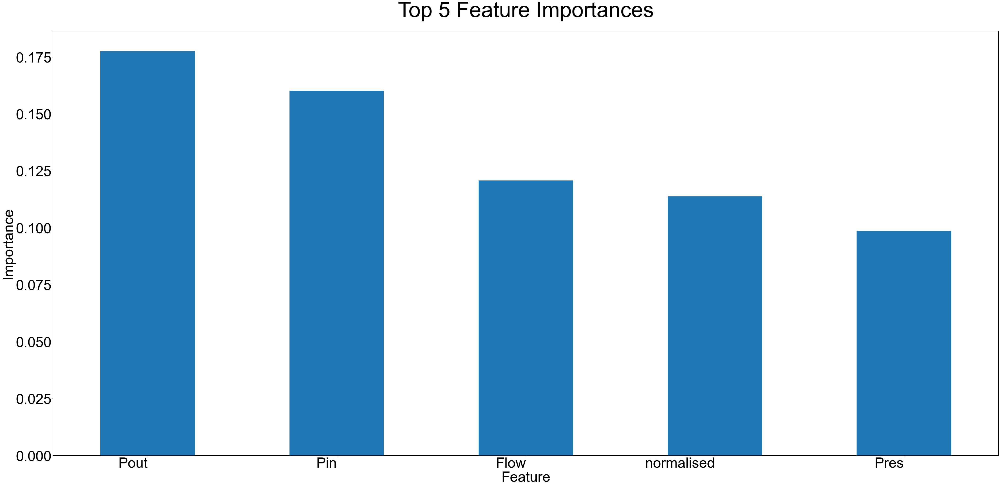


Function runtime: 2.94 minutes
Pout           0.177444
Pin            0.160107
Flow           0.120823
normalised     0.113836
Pres           0.098564
absdiff_3sd    0.078088
count_3sd      0.073612
Pout_cv        0.039320
Flow_cv        0.037572
Pin_cv         0.034415
dtype: float64
Precision (macro): 0.9825024733959875
Recall    (macro): 0.9440490490365566
F1        (macro): 0.9622253222641408

False Positive Rate per class:
Drop_in_inlet_pressure     0.000419
Drop_in_outlet_pressure    0.042518
Failure                    0.000000
Further_classification     0.000000
Large_step_change          0.000000
Likely_failure             0.001961
Speed_control              0.003097
System_dynamics            0.001299
Valve_dynamics             0.001727
dtype: float64
Tuned hyperparameters: {'max_depth': 20, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 200}
Elapsed time: 2.94 minutes


In [56]:
from sklearn.model_selection import StratifiedKFold

grid_params = {
    'n_estimators':      [50, 100, 200],
    'max_depth':         [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf':  [1, 2, 4],
    'max_features':      ['auto', 'sqrt', 'log2']
}

cv = 5  

clf, report_test, cm_test, importances, metrics_full, best_params, elapsed = train_and_evaluate_rf2(
    labelled_flagged_features,
    label_col='label',
    grid_params=grid_params,  # or None
    cv=5,
    test_size=0.3,
    random_state=42,
    n_jobs=-1
)


print(importances.head(10))

print("Precision (macro):", metrics_full['precision_macro'])
print("Recall    (macro):", metrics_full['recall_macro'])
print("F1        (macro):", metrics_full['f1_macro'])
print("\nFalse Positive Rate per class:")
print(metrics_full['fpr_per_class'])

print("Tuned hyperparameters:" , best_params)

print(f"Elapsed time: {elapsed:.2f} minutes")

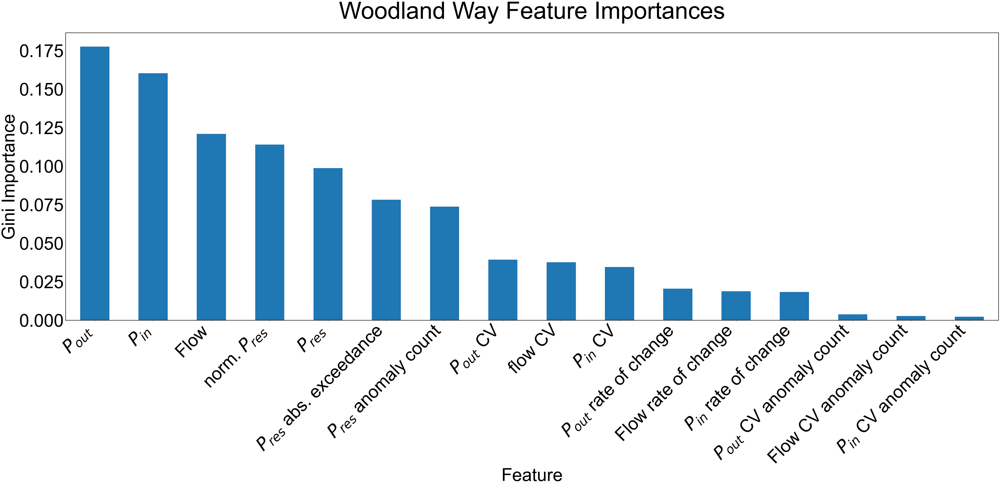

In [58]:
new_labels = [
    r'$P_{out}$',r'$P_{in}$', 'Flow',r'norm. $P_{res}$',r'$P_{res}$',r'$P_{res}$ abs. exceedance',
    r'$P_{res}$ anomaly count',r'$P_{out}$ CV', 'flow CV',r'$P_{in}$ CV',r'$P_{out}$ rate of change', 
    'Flow rate of change',r'$P_{in}$ rate of change',  r'$P_{out}$ CV anomaly count', 'Flow CV anomaly count',r'$P_{in}$ CV anomaly count'
]

# 2) Copy `importances` and replace its index with our new labels:
top_features = importances.copy()

# Make sure there are exactly 16 importances here:
if len(top_features) != len(new_labels):
    raise ValueError(
        f"importances has length {len(top_features)}, but we provided {len(new_labels)} labels."
    )

# Overwrite the index so that the bar‐plot picks up our new labels:
top_features.index = new_labels

# 3) Plot the bar chart using those new names:
fig2, ax2 = plt.subplots()
top_features.plot(kind='bar', ax=ax2)
ax2.set_title('Woodland Way Feature Importances', fontsize = 100)   # or adjust title if needed
ax2.set_ylabel('Gini Importance', fontsize = 75)
ax2.set_xlabel('Feature', fontsize = 75)

# Rotate & align the x‐tick labels so they’re readable:
plt.xticks(rotation=45, ha='right', fontsize = 75)
plt.yticks(fontsize = 75)
plt.tight_layout()
plt.show()

### 7.3. Cross application

In [59]:
StokeLane_Flagged = pd.read_csv("../../Data/StokeLane/FlaggedData/Flagged_features_SL_labelled.csv", parse_dates=[0], index_col=0)
StokeLane_Flagged = StokeLane_Flagged[ StokeLane_Flagged['label'] != 'Valve_repair' ]
StokeLane_Flagged['label'].fillna('Unclassified', inplace=True)

Dropped 12505 rows with unseen labels.
=== WoodlandWay Test Classification Report ===
                         precision    recall  f1-score   support

Drop_in_outlet_pressure       0.00      0.00      0.00         0
                Failure       0.00      0.00      0.00      6635
 Further_classification       0.00      0.00      0.00       425
      Large_step_change       0.83      0.02      0.04       442
         Likely_failure       0.00      0.01      0.00       123
          Speed_control       0.01      0.10      0.01        21
        System_dynamics       0.00      0.04      0.01       163
         Valve_dynamics       0.00      0.00      0.00        30

               accuracy                           0.00      7839
              macro avg       0.11      0.02      0.01      7839
           weighted avg       0.05      0.00      0.00      7839



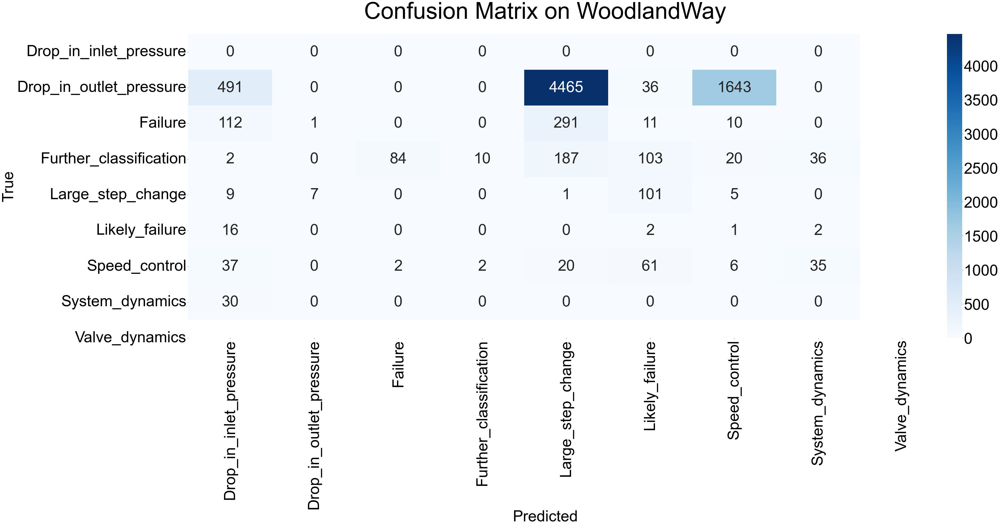

Precision (macro): 0.9825024733959875
Recall    (macro): 0.9440490490365566
F1        (macro): 0.9622253222641408

False Positive Rate per class:
Drop_in_inlet_pressure     0.000419
Drop_in_outlet_pressure    0.042518
Failure                    0.000000
Further_classification     0.000000
Large_step_change          0.000000
Likely_failure             0.001961
Speed_control              0.003097
System_dynamics            0.001299
Valve_dynamics             0.001727
dtype: float64
Tuned hyperparameters: {'max_depth': 20, 'max_features': 'sqrt', 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 200}
Elapsed time: 2.94 minutes


In [60]:
feature_cols = clf.feature_names_in_.tolist()

sl = StokeLane_Flagged.copy()
sl['label'] = sl['label'].astype(str)

mask = sl['label'].isin(clf.classes_)
dropped = (~mask).sum()
sl = sl[mask]
print(f"Dropped {dropped} rows with unseen labels.")
y_true = sl['label']
sl = sl.drop(columns=['label'])
obj_cols = sl.select_dtypes(include=['object','category']).columns.tolist()
if obj_cols:
    ww = pd.get_dummies(sl, columns=obj_cols, drop_first=True)

X_new = sl.reindex(columns=feature_cols, fill_value=0)
y_pred = clf.predict(X_new)

print("=== WoodlandWay Test Classification Report ===")
print(classification_report(y_true, y_pred))

cm = confusion_matrix(y_true, y_pred)
fig, ax = plt.subplots()
sns.heatmap(
    cm, annot=True, fmt='d',
    xticklabels=clf.classes_,
    yticklabels=clf.classes_,
    cmap='Blues',
    ax=ax
)
ax.set_title('Confusion Matrix on WoodlandWay')
ax.set_xlabel('Predicted')
ax.set_ylabel('True')
plt.tight_layout()
plt.show()


In [62]:
acc_overall = accuracy_score(y_true, y_pred)
print(f"Overall accuracy          : {acc_overall:.3f}")

prec_macro = precision_score(y_true, y_pred, average='macro', zero_division=0)
rec_macro  = recall_score(   y_true, y_pred, average='macro', zero_division=0)
f1_macro   = f1_score(      y_true, y_pred, average='macro', zero_division=0)
print(f"Macro‐averaged precision : {prec_macro:.3f}")
print(f"Macro‐averaged recall    : {rec_macro:.3f}")
print(f"Macro‐averaged F1        : {f1_macro:.3f}")

labels = list(clf.classes_)
cm = confusion_matrix(y_true, y_pred, labels=labels)
cm_df = pd.DataFrame(cm, index=labels, columns=labels)

fpr_dict = {}
for cls in labels:
    FP = cm_df[cls].sum() - cm_df.at[cls, cls]
    TN = cm_df.drop(index=cls, columns=cls).values.sum()
    fpr_dict[cls] = FP / (FP + TN) if (FP + TN) > 0 else 0.0

fpr_series = pd.Series(fpr_dict).sort_index()
print("\nFalse Positive Rate per class:")
print(fpr_series.to_frame(name="FPR"))

Overall accuracy          : 0.002
Macro‐averaged precision : 0.105
Macro‐averaged recall    : 0.020
Macro‐averaged F1        : 0.008

False Positive Rate per class:
                              FPR
Drop_in_inlet_pressure   0.000000
Drop_in_outlet_pressure  0.088914
Failure                  0.006645
Further_classification   0.011600
Large_step_change        0.000270
Likely_failure           0.643209
Speed_control            0.039908
System_dynamics          0.218734
Valve_dynamics           0.009348


In [63]:
labels = list(clf.classes_)
cm_full = confusion_matrix(y_true, y_pred, labels=labels)
cm_df   = pd.DataFrame(cm_full, index=labels, columns=labels)

total_FP = sum(
    cm_df[col].sum()  
    - cm_df.at[col, col]  
    for col in labels
)

total_TN = sum(
    cm_df.drop(index=cls, columns=cls).values.sum()
    for cls in labels
)

if (total_FP + total_TN) > 0:
    fpr_overall = total_FP / (total_FP + total_TN)
else:
    fpr_overall = 0.0

print(f"\nOverall False Positive Rate: {fpr_overall:.3f}")


Overall False Positive Rate: 0.125
